In [2]:
import pandas as pd
import glob
import json
import matplotlib.pyplot as plt
import numpy as np
from sklearn.mixture import GaussianMixture

## [Title:] Preprocessing the Data Release ZTF data for the Extragalactic Catalog

In [3]:
file_list = glob.glob('/media3/CRP8/TDE/data/DR_photometry/extragalactic/*.json')
file_list.sort()
print(len(file_list))

124


In [4]:
all_lcs = []

# Filter mapping
filter_map = {"zg": ("g", 1), "zr": ("r", 2), "zi": ("i", 3)}

for file in file_list:
    with open(file, "r") as f:
        data = json.load(f)
    
    ztf_id = file.split("/")[-1].split(".")[0]
    
    # Loop over different matches (keys)
    for obj_id in data.keys():
        lc = data[obj_id]["lc"]
        filt = data[obj_id]["meta"]["filter"]  # e.g., "zg"
        
        if filt not in filter_map:
            continue 
        
        band, fid = filter_map[filt]
        
        # Extract points
        for point in lc:
            all_lcs.append({
                "ztf_id": ztf_id,
                "obj_id": obj_id,
                "mjd": point["mjd"],
                "mag": point["mag"],
                "magerr": point["magerr"],
                "band": band,
                "fid": fid
            })

# Convert to dataframe
df = pd.DataFrame(all_lcs)
print(df.head())
print(df["band"].value_counts())


         ztf_id            obj_id          mjd        mag    magerr band  fid
0  ZTF17aaajnki  1714103300002371  58206.33806  16.422432  0.016472    g    1
1  ZTF17aaajnki  1714103300002371  58246.29398  16.415130  0.016447    g    1
2  ZTF17aaajnki  1714103300002371  58439.51955  16.481930  0.016689    g    1
3  ZTF17aaajnki  1714103300002371  58482.53132  16.732395  0.017809    g    1
4  ZTF17aaajnki  1714103300002371  58487.47958  16.329445  0.016167    g    1
band
r    112140
g     76713
i     14044
Name: count, dtype: int64


In [5]:
data_lc = df.groupby('ztf_id', sort=False, as_index=False).agg(list)

In [6]:
data_lc

,ztf_id,obj_id,mjd,mag,magerr,band,fid
0,ZTF17aaajnki,"[1714103300002371, 1714103300002371, 171410330...","[58206.33806, 58246.29398, 58439.51955, 58482....","[16.422432, 16.41513, 16.48193, 16.732395, 16....","[0.016472189, 0.016446754, 0.0166891, 0.017809...","[g, g, g, g, g, g, g, g, g, g, g, g, g, g, g, ...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."
1,ZTF17aaaznul,"[695111300026353, 695111300026353, 69511130002...","[58274.44801, 58277.46084, 58280.44979, 58283....","[16.24696, 16.269173, 16.247028, 16.260115, 16...","[0.018712297, 0.018770762, 0.018712474, 0.0187...","[g, g, g, g, g, g, g, g, g, g, g, g, g, g, g, ...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."
2,ZTF17aaazxvs,"[695111300013867, 695111300013867, 69511130001...","[58274.44802, 58277.46086, 58280.4498, 58283.4...","[16.17482, 16.218706, 16.21664, 16.160885, 16....","[0.018532904, 0.018640155, 0.018634979, 0.0185...","[g, g, g, g, g, g, g, g, g, g, g, g, g, g, g, ...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."
3,ZTF17aabbkqg,"[695111100005251, 695111100005251, 69511110000...","[58274.44793, 58277.46076, 58280.4497, 58283.4...","[16.891262, 16.89745, 16.906395, 16.924973, 16...","[0.01869567, 0.018729843, 0.018779613, 0.01888...","[g, g, g, g, g, g, g, g, g, g, g, g, g, g, g, ...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."
4,ZTF17aabblws,"[695111400011707, 695111400011707, 69511140001...","[58274.44796, 58277.46079, 58280.44973, 58283....","[16.036972, 16.060432, 16.047228, 16.055984, 1...","[0.013575886, 0.013647932, 0.013607177, 0.0136...","[g, g, g, g, g, g, g, g, g, g, g, g, g, g, g, ...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."
...,...,...,...,...,...,...,...
118,ZTF21abshyrw,"[695111200008342, 695111200008342, 69511120000...","[58274.448, 58277.46083, 58280.44977, 58283.44...","[19.382736, 19.417604, 19.361465, 19.470829, 1...","[0.06411654, 0.06580725, 0.06310899, 0.0684842...","[g, g, g, g, g, g, g, g, g, g, g, g, g, g, g, ...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."
119,ZTF22aajiwwg,"[479102300001299, 479102300001299, 47910230000...","[58202.37982, 58229.32058, 58236.2933, 58237.3...","[19.662891, 19.90177, 19.145874, 19.07834, 19....","[0.094783574, 0.11223926, 0.06503224, 0.061911...","[g, g, g, g, g, g, g, g, g, g, g, g, g, g, g, ...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."
120,ZTF22aaresyk,"[851104300021120, 851104300021120, 85110430002...","[58206.44073, 58206.47068, 58209.45595, 58209....","[15.900405, 16.204922, 15.772439, 15.883714, 1...","[0.016427236, 0.016983746, 0.016253492, 0.0164...","[g, g, g, g, g, g, g, g, g, g, g, g, g, g, g, ...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."
121,ZTF23aajibwv,"[576107200003105, 576107200003105, 57610720000...","[58202.31668, 58205.26709, 58205.32317, 58210....","[19.720833, 19.491482, 20.009844, 19.457266, 1...","[0.09938276, 0.0837976, 0.122644305, 0.0816823...","[g, g, g, g, g, g, g, g, g, g, g, g, g, g, g, ...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ..."


In [17]:
data_alert = pd.read_parquet('/media3/CRP8/TDE/data/xmatch/extragalactic/')
data_alert
data_alert = data_alert.groupby('objectId', sort=False, as_index=False).agg(list)
data_alert['top_class'] = [np.unique(data_alert['finkclass'].values[i]) for i in range(data_alert.shape[0])]
data_alert['ztf_id']= data_alert['objectId']
data_alert['objectId']
data_alert

,objectId,finkclass,cdsxmatch,rf_snia_vs_nonia,snn_sn_vs_all,snn_snia_vs_nonia,tns,candid,dec,fid,jd,magpsf,sigmapsf,ra,cat_id,top_class,ztf_id
0,ZTF19adcfrsh,"[BLLac, BLLac, BLLac, BLLac, BLLac, BLLac, BLL...","[BLLac, BLLac, BLLac, BLLac, BLLac, BLLac, BLL...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[Unknown, Unknown, Unknown, Unknown, Unknown, ...","[2649339052515015011, 1498331902515015022, 218...","[18.3061281, 18.3060467, 18.3060507, 18.306015...","[1, 2, 1, 1, 1, 1, 1, 1, 2, 2, 2, 1, 1, 1, 1, ...","[2460403.8390509, 2459252.8319097, 2459938.032...","[19.83970832824707, 19.848342895507812, 20.187...","[0.12612205743789673, 0.15952593088150024, 0.1...","[186.3260828, 186.3260515, 186.3260789, 186.32...","[NGC4382_sources_3223, NGC4382_sources_3223, N...","[BLLac, Unknown]",ZTF19adcfrsh
1,ZTF19abhxipr,"[GlCl, GlCl, GlCl, GlobCluster, GlCl, GlCl, Gl...","[GlCl, GlCl, GlCl, GlobCluster, GlCl, GlCl, Gl...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[Unknown, Unknown, Unknown, Unknown, Unknown, ...","[2491227190815010062, 1975478100815010048, 269...","[30.7223772, 30.7222719, 30.7223364, 30.722398...","[2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]","[2460245.7271991, 2459729.9781019, 2460451.987...","[18.892566680908203, 18.802169799804688, 18.36...","[0.1853974163532257, 0.20984046161174774, 0.18...","[23.5119863, 23.5119665, 23.5120522, 23.511925...","[Ma_249, Ma_249, Ma_249, Ma_249, Ma_249, Ma_24...","[GlCl, GlobCluster]",ZTF19abhxipr
2,ZTF18aceohig,"[RRLyr, RRLyr, RRLyr, RRLyr, RRLyr]","[RRLyr, RRLyr, RRLyr, RRLyr, RRLyr]","[0.0, 0.0, 0.0, 0.0, 0.0]","[0.0, 0.0, 0.0, 0.0, 0.0]","[0.0, 0.0, 0.0, 0.0, 0.0]","[Unknown, Unknown, Unknown, Unknown, Unknown]","[2540369892715015021, 2540393422715015024, 248...","[38.878988, 38.8789569, 38.8789447, 38.8789591...","[1, 1, 1, 1, 1]","[2460294.8698958, 2460294.8934259, 2460238.946...","[20.51942253112793, 20.740026473999023, 20.468...","[0.1735648512840271, 0.20868098735809326, 0.19...","[114.5734986, 114.57369, 114.57348, 114.573598...","[beccari2013_1444, beccari2013_1444, beccari20...",[RRLyr],ZTF18aceohig
3,ZTF18acbytzf,"[Unknown, Unknown, Unknown, EB*, EB*, Unknown,...","[Unknown, Unknown, Unknown, EB*, EB*, Unknown,...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[Unknown, Unknown, Unknown, Unknown, Unknown, ...","[2054506082715010011, 1558174422715010003, 205...","[38.8591784, 38.8591145, 38.8591078, 38.859212...","[2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, ...","[2459809.006088, 2459312.6744213, 2459809.0036...","[19.441484451293945, 20.08523941040039, 19.488...","[0.21688523888587952, 0.21335364878177643, 0.1...","[114.4157526, 114.4157485, 114.4157277, 114.41...","[beccari2013_146, beccari2013_146, beccari2013...","[EB*, EclBin, Unknown]",ZTF18acbytzf
4,ZTF19abdshcf,"[RSG*_Candidate, RSG*_Candidate, RSG*_Candidat...","[RSG*_Candidate, RSG*_Candidate, RSG*_Candidat...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[Unknown, Unknown, Unknown, Unknown, Unknown, ...","[2231157710815015043, 1981479120815015018, 198...","[30.810183, 30.8101799, 30.8101349, 30.8101557...","[2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, ...","[2459985.6577199, 2459735.9791204, 2459734.971...","[18.707080841064453, 18.43876838684082, 18.347...","[0.08949347585439682, 0.0932450219988823, 0.11...","[23.5112743, 23.5114571, 23.5113438, 23.511324...","[Ma_247, Ma_247, Ma_247, Ma_247, Ma_247, Ma_24...","[Candidate_RSG*, Cl*, Pec*, RSG*_Candidate, Re...",ZTF19abdshcf
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
438,ZTF18abwadef,[GlCl],[GlCl],[

In [14]:
data_all = pd.merge(data_lc, data_alert, on="ztf_id", how="inner")
data_all['top_class'].value_counts()


#data_all.to_csv('extragalactic_DR_Alerts.csv', index=False)

top_class: [np.str_('HII') np.str_('PartofG') np.str_('QSO') np.str_('Seyfert_2')
 np.str_('Unknown')]
cat_id: ['Baldassare2022_64']
tns: ['Unknown']


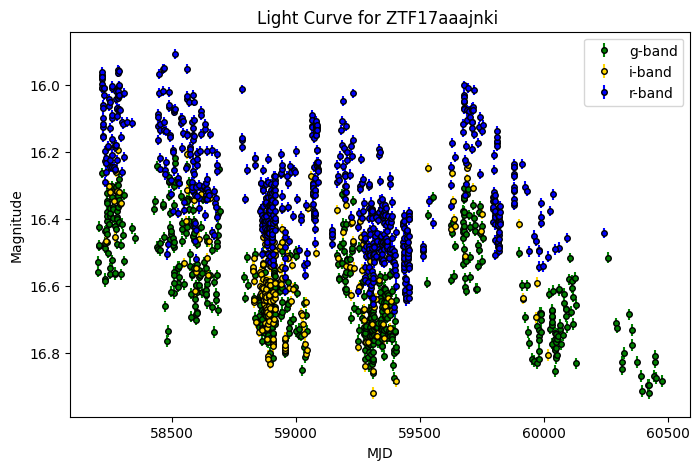

top_class: [np.str_('GlCl')]
cat_id: ['Peacock_5' 'Vansevicius09_29']
tns: ['Unknown']


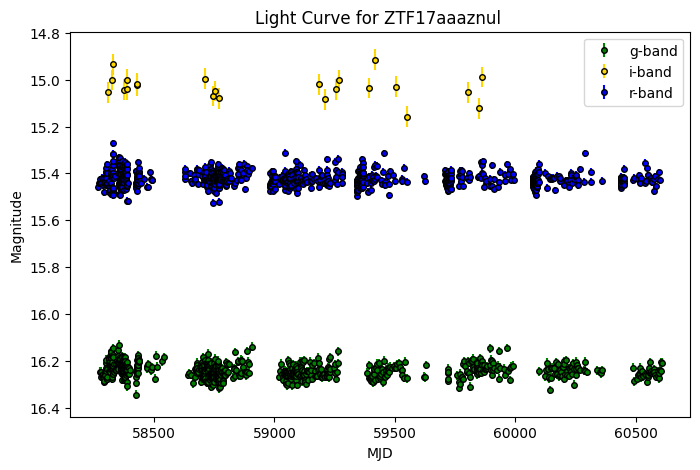

top_class: [np.str_('GlCl')]
cat_id: ['Fan2010_230' 'Peacock_256']
tns: ['Unknown']


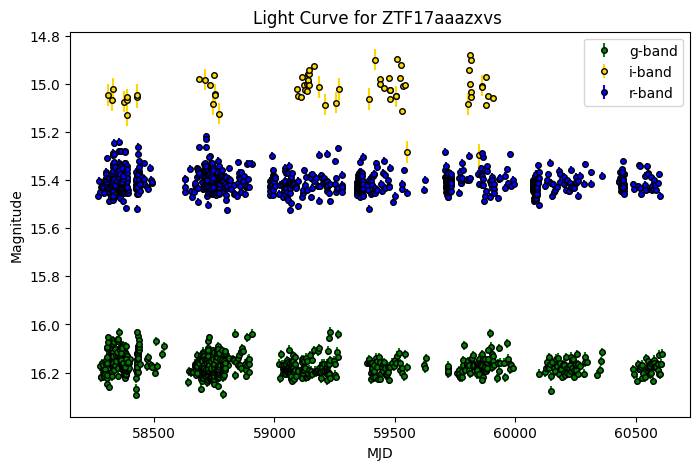

top_class: [np.str_('GlCl') np.str_('PulsV*')]
cat_id: ['Fan2010_252' 'PHAT2_johnson15_1181' 'PHAT_johnson12_551' 'Peacock_288']
tns: ['Unknown']


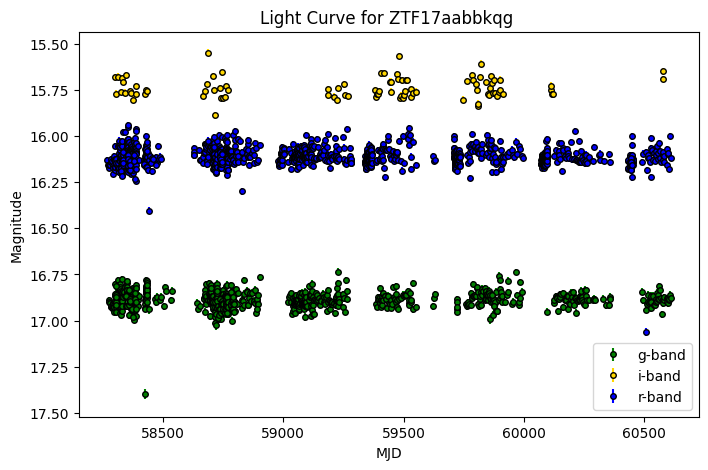

top_class: [np.str_('GlCl')]
cat_id: ['Fan2010_138' 'PHAT2_johnson15_1203' 'Peacock_168']
tns: ['Unknown']


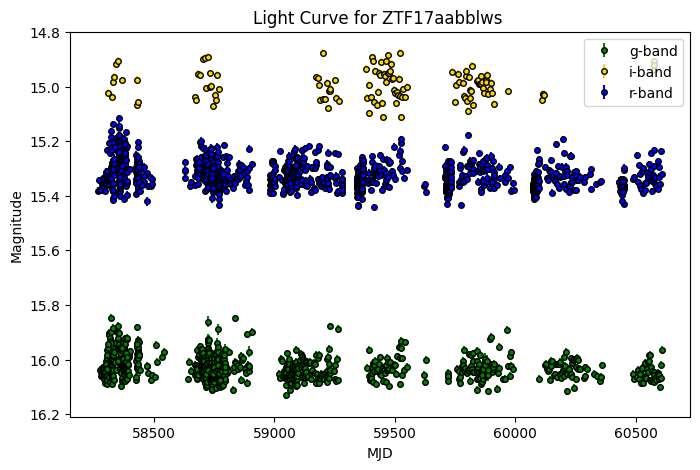

top_class: [np.str_('GlCl') np.str_('Star')]
cat_id: ['Fahrion2019_375' 'Peacock_22']
tns: ['Unknown']


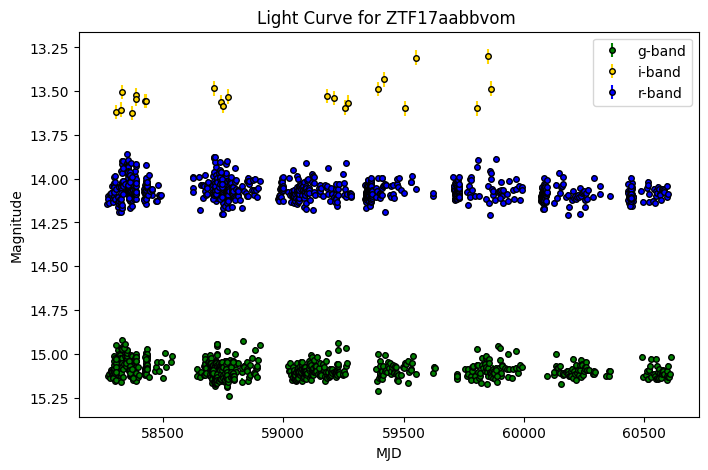

top_class: [np.str_('GlCl') np.str_('GlobCluster')]
cat_id: ['Peacock_17']
tns: ['Unknown']


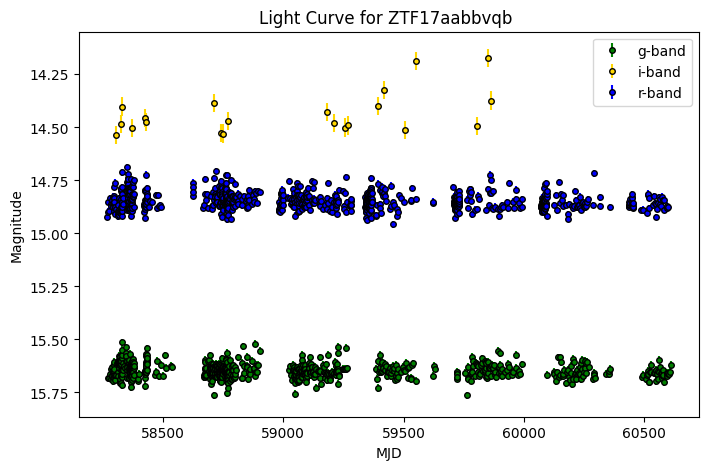

top_class: [np.str_('GlCl') np.str_('LMXB')]
cat_id: ['Fan2010_56' 'Peacock_78']
tns: ['Unknown']


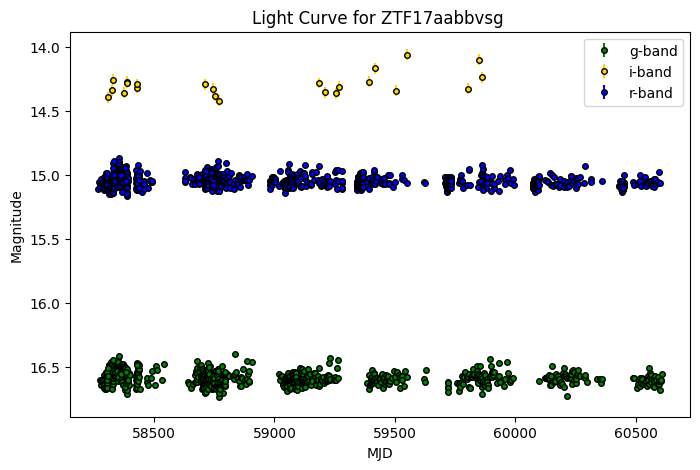

top_class: [np.str_('GlCl')]
cat_id: ['Fan2010_48' 'Peacock_70']
tns: ['Unknown']


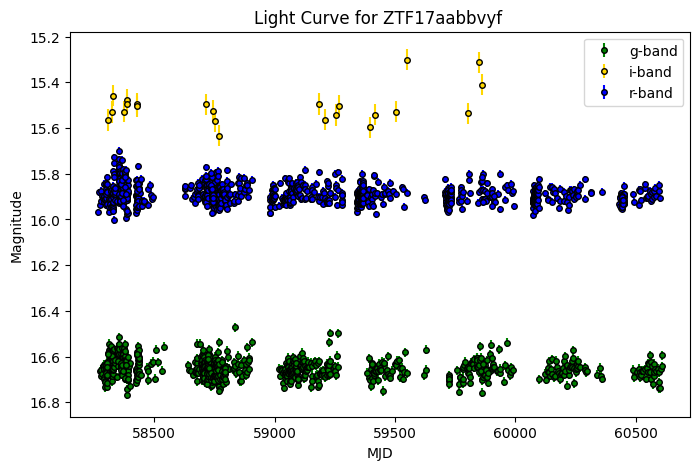

top_class: [np.str_('GlCl') np.str_('Unknown')]
cat_id: ['Fan2010_44' 'Peacock_65']
tns: ['Unknown']


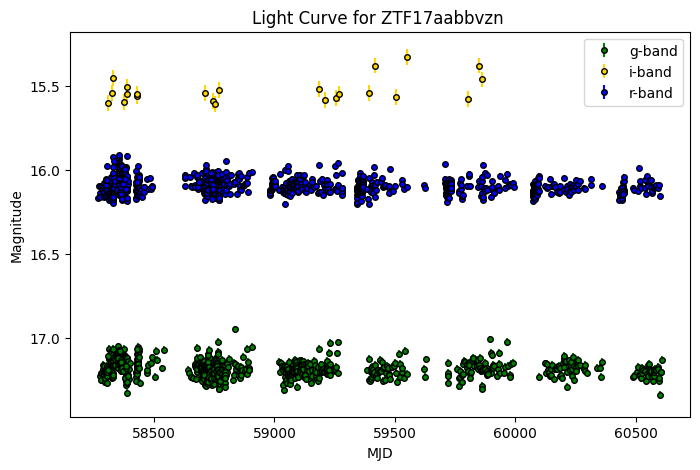

top_class: [np.str_('GinGroup')]
cat_id: ['Seth08_120']
tns: ['Unknown']


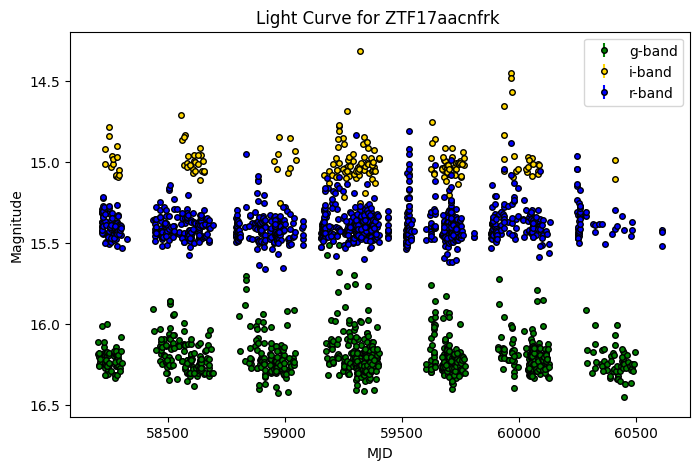

top_class: [np.str_('AGN') np.str_('GinCl') np.str_('Unknown')]
cat_id: ['Baldassare2022_58']
tns: ['Unknown']


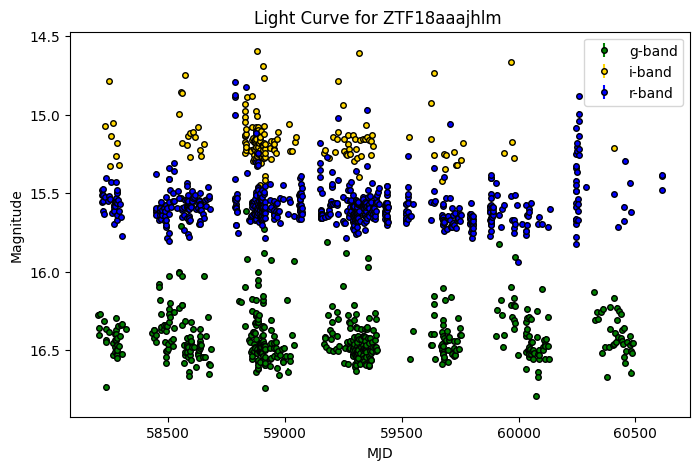

top_class: [np.str_('BClG') np.str_('Radio')]
cat_id: ['M87Kundu_0']
tns: ['Unknown']


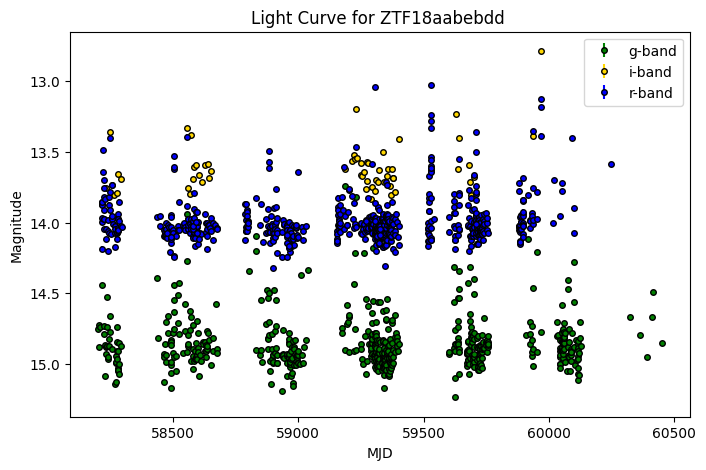

top_class: [np.str_('GinPair')]
cat_id: ['Georgiev2014_39']
tns: ['Unknown']


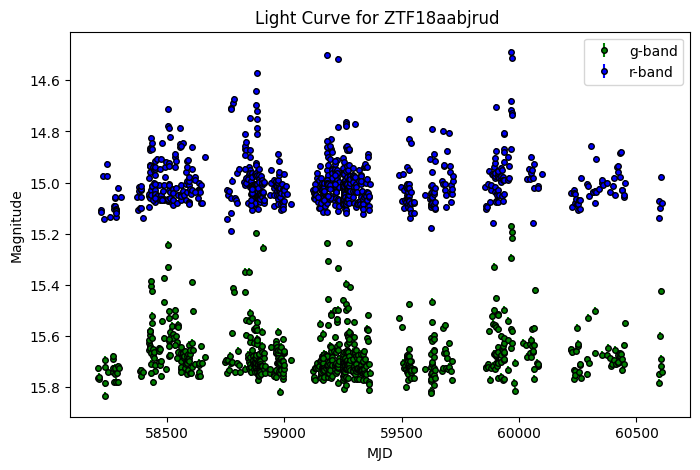

top_class: [np.str_('EB*') np.str_('EclBin') np.str_('Unknown')]
cat_id: ['NGC4382_sources_1308']
tns: ['Unknown']


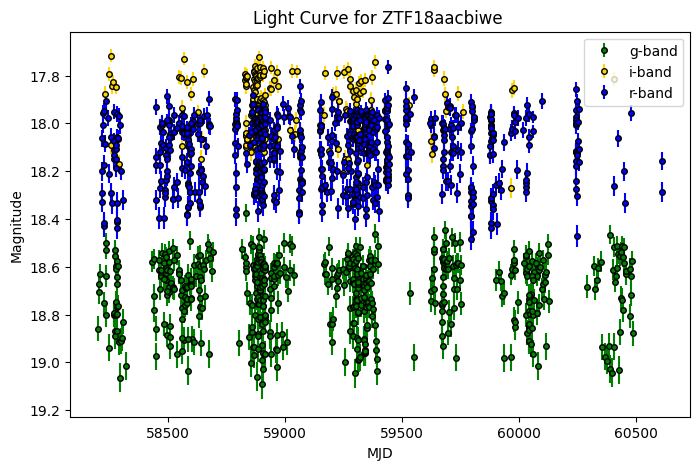

top_class: [np.str_('GinGroup') np.str_('Unknown')]
cat_id: ['Georgiev2014_41']
tns: ['Unknown']


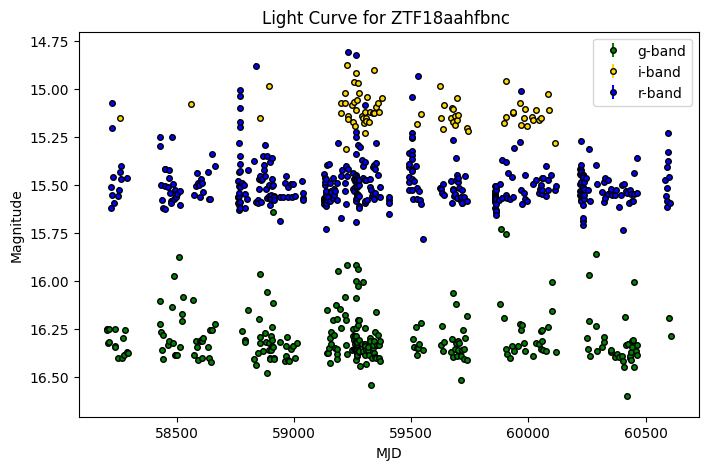

top_class: [np.str_('GinPair') np.str_('Unknown')]
cat_id: ['Seth08_42']
tns: ['Unknown']


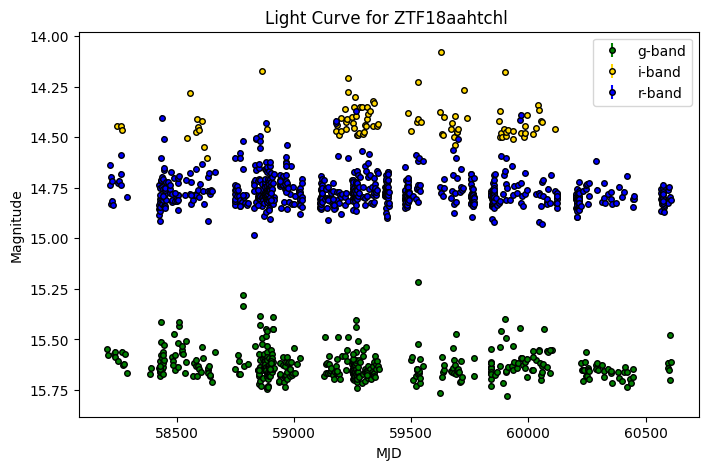

top_class: [np.str_('GinCl') np.str_('GlCl') np.str_('RRLyr') np.str_('RRLyrae')
 np.str_('Unknown')]
cat_id: ['NGC4649_sources_699']
tns: ['Unknown']


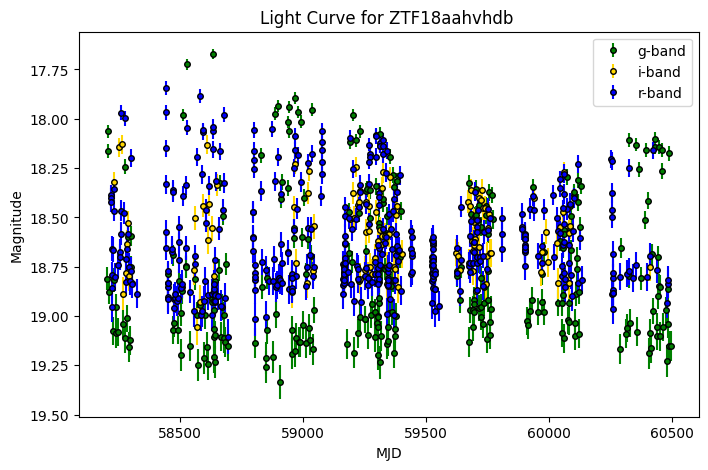

top_class: [np.str_('QSO') np.str_('Unknown')]
cat_id: ['NGC5866_sources_904']
tns: ['Unknown']


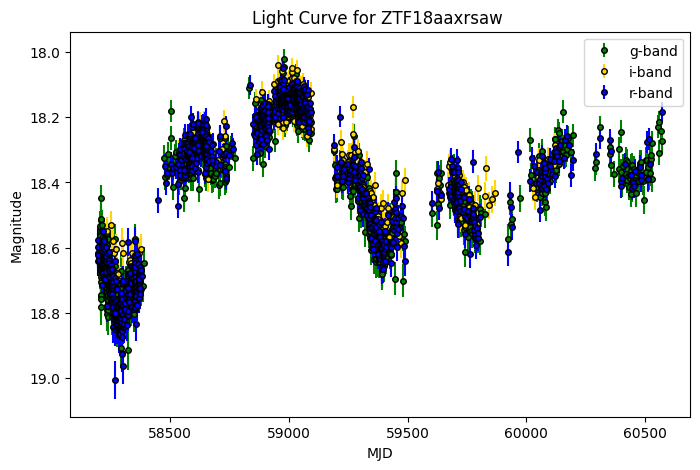

top_class: [np.str_('QSO')]
cat_id: ['Gonzalez-Lopezlira_2']
tns: ['Unknown']


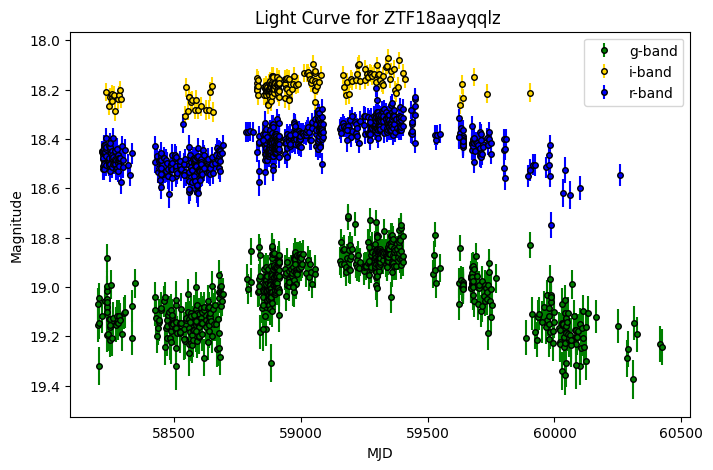

top_class: [np.str_('UV') np.str_('V*')]
cat_id: ['PHAT2_johnson15_1596']
tns: ['Unknown']


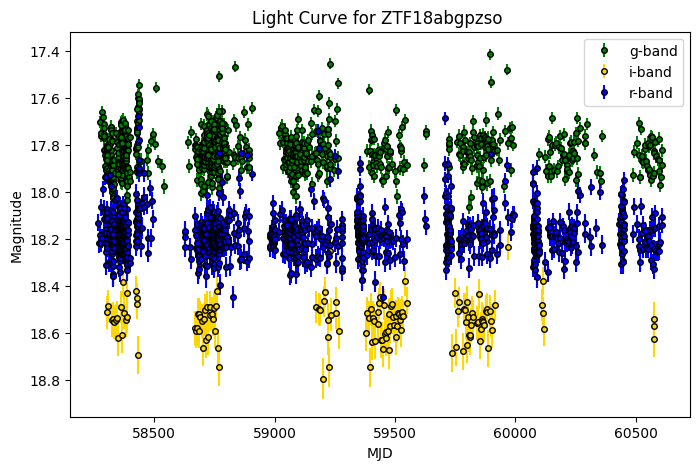

top_class: [np.str_('BlueSG') np.str_('BlueSG*')]
cat_id: ['Fan2010_950' 'Peacock_444']
tns: ['Unknown']


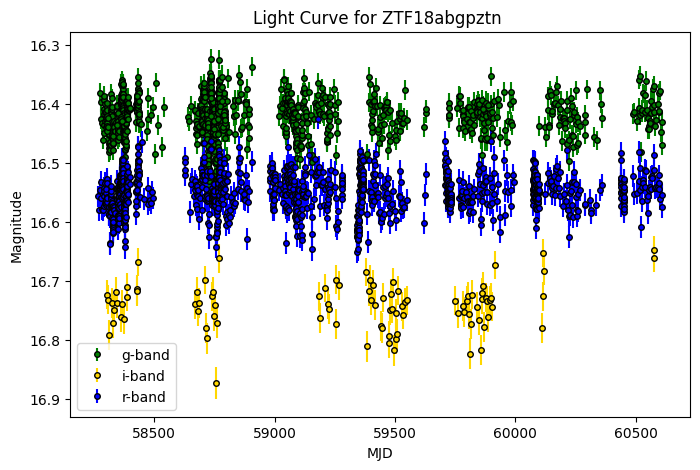

top_class: [np.str_('GlCl') np.str_('Unknown')]
cat_id: ['PHAT2_johnson15_527' 'Peacock_1178']
tns: ['Unknown']


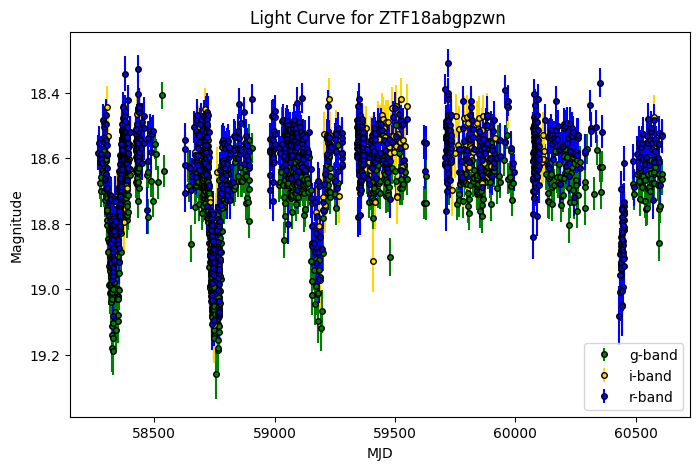

top_class: [np.str_('GlCl') np.str_('PulsV*') np.str_('Unknown')]
cat_id: ['Fahrion2019_374' 'Fan2010_242' 'Peacock_269' 'Vansevicius09_132']
tns: ['Unknown']


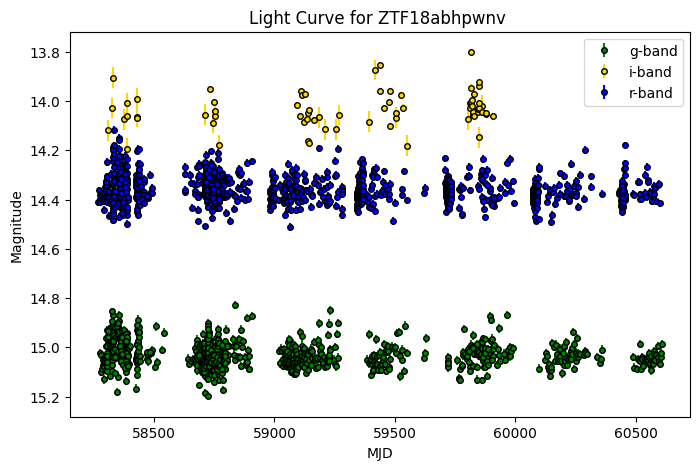

top_class: [np.str_('OpCl') np.str_('Unknown')]
cat_id: ['Peacock_942' 'Vansevicius09_57']
tns: ['Unknown']


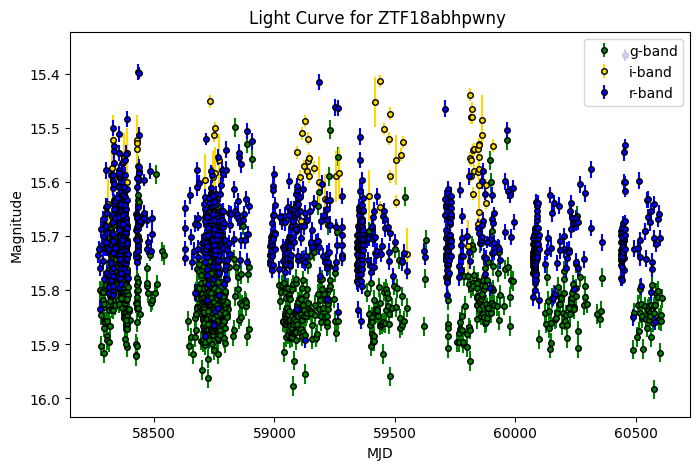

Exception ignored in: <bound method IPythonKernel._clean_thread_parent_frames of <ipykernel.ipkernel.IPythonKernel object at 0x7f3615b6d280>>
Traceback (most recent call last):
  File "/media3/darc/phelenv312/lib/python3.12/site-packages/ipykernel/ipkernel.py", line 796, in _clean_thread_parent_frames
    active_threads = {thread.ident for thread in threading.enumerate()}
                      ^^^^^^^^^^^^
KeyboardInterrupt: 


top_class: [np.str_('GlCl')]
cat_id: ['Fan2010_35' 'Peacock_56']
tns: ['Unknown']


Bad pipe message: %s [b'\x80/q\x03\x83\xabPm\x1bt$P~\x97\x07\xec7\x04 #\xeai`\xc0a\n\xbe\xae\x9b\x03>S\xe5\x9e\xc3\x1d\x98\x84\x9e\xbf\x00n\xdf/\x94n\r\xb9\xfc\xb0\x94\x00&\xc0+\xc0/\xc0,\xc00\xcc\xa9\xcc\xa8\xc0\t\xc0\x13\xc0\n\xc0\x14\x00\x9c\x00\x9d\x00/\x005\xc0\x12\x00\n\x13\x01\x13\x02\x13\x03\x01\x00\x00\x8d\x00\x05']

KeyboardInterrupt



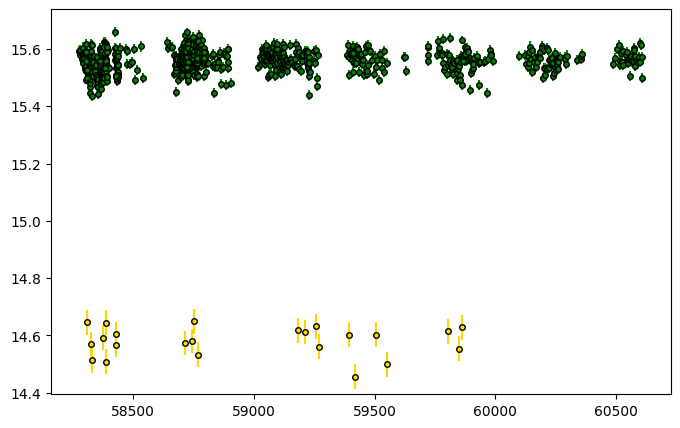

Bad pipe message: %s [b"\t\\\xd4'\x8d\xadM\xb7\x1a<\xfb\xb8f\xd8\x94\xa0\xea\xb9 @\x81\xb0\xc5\xae\x8d\\\x1b\x1f\xbc\x9a\xb3\x14\x96\xe2o\xe6Q\xe7\t\xdfy\xc2\x1d\xe3\x94\xb7\x9e\xbfG\xb9\xe4\x00&\xc0+\xc0/\xc0,\xc00\xcc\xa9\xcc\xa8\xc0\t\xc0\x13\xc0\n\xc0\x14\x00\x9c\x00\x9d\x00/\x005\xc0\x12\x00\n\x13\x01\x13\x02\x13\x03\x01\x00\x00\x8d\x00\x05\x00\x05\x01\x00\x00\x00\x00\x00\n\x00\n\x00\x08\x00\x1d\x00\x17\x00\x18\x00\x19\x00\x0b\x00\x02\x01\x00\x00\r\x00\x1a\x00\x18\x08\x04\x04\x03\x08\x07\x08\x05\x08\x06\x04\x01\x05\x01\x06\x01"]
Bad pipe message: %s [b'\x06\x03\x02\x01', b'\xff', b'']
Bad pipe message: %s [b'']
Bad pipe message: %s [b'\x9e\xed\xaew\x93e\xffL\x07\x8d\xe8\\@\x11T\x18\x033 \x13\xecef\x89O\x98\xbb\xc3m\x02\x02}o\xffV\x15\xee==\x0f\xb4\xdd|q\xb7\x1b\xf5\xd3\x82\xb9\xaa\x00&\xc0+\xc0/\xc0,\xc00\xcc\xa9\xcc\xa8\xc0\t\xc0\x13\xc0\n\xc0\x14\x00\x9c\x00\x9d\x00/\x005\xc0\x12\x00\n\x13\x01\x13\x02\x13\x03\x01\x00\x00\x8d\x00\x05\x00\x05\x01\x00\x00\x00\x00\x00\n\x00\n\x00\x0

In [11]:
from scipy.ndimage import gaussian_filter1d

band_colors = {'g': 'green', 'r': 'blue', 'i': 'gold'}

for _, row in data_lc.iterrows():
    ztfid = row['ztf_id']
    
    row_alert = data_alert.loc[data_alert['objectId']==ztfid]
    
    # top_class seems fine already (strings, not lists)
    print("top_class:", np.unique(row_alert['top_class'].explode()))
    
    # Flatten cat_id (list of lists -> single list)
    print("cat_id:", np.unique(row_alert['cat_id'].explode()))
    
    # Flatten tns
    print("tns:", np.unique(row_alert['tns'].explode()))
    # Convert lists to numpy arrays for easy handling
    mjd = np.array(row['mjd'])
    mag = np.array(row['mag'])
    magerr = np.array(row['magerr'])
    bands = np.array(row['band'])

    # Plot light curve per band
    plt.figure(figsize=(8, 5))
    for b in np.unique(bands):
        mask = bands == b
        plt.errorbar(
            mjd[mask], mag[mask], yerr=magerr[mask],
            fmt='o', ms=4, color=band_colors.get(b, 'black'),markeredgecolor='black', label=f"{b}-band"
        )
    # Apply Gaussian smoothing




    plt.gca().invert_yaxis()
    plt.xlabel("MJD")
    plt.ylabel("Magnitude")
    plt.title(f"Light Curve for {ztfid} ")
    plt.legend()
    plt.show()

top_class: [np.str_('HII') np.str_('PartofG') np.str_('QSO') np.str_('Seyfert_2')
 np.str_('Unknown')]
cat_id: ['Baldassare2022_64']
tns: ['Unknown']
ERROR! Session/line number was not unique in database. History logging moved to new session 45


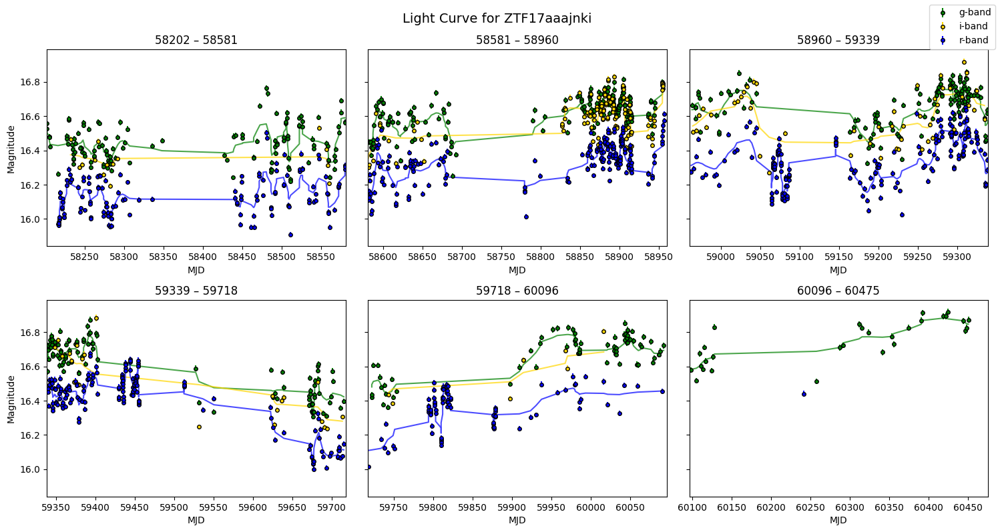

top_class: [np.str_('GlCl')]
cat_id: ['Peacock_5' 'Vansevicius09_29']
tns: ['Unknown']


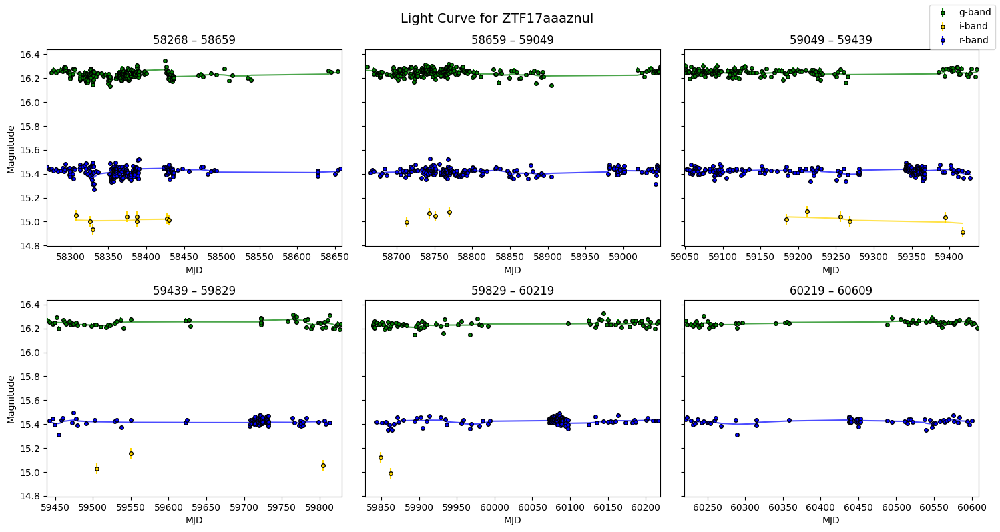

top_class: [np.str_('GlCl')]
cat_id: ['Fan2010_230' 'Peacock_256']
tns: ['Unknown']


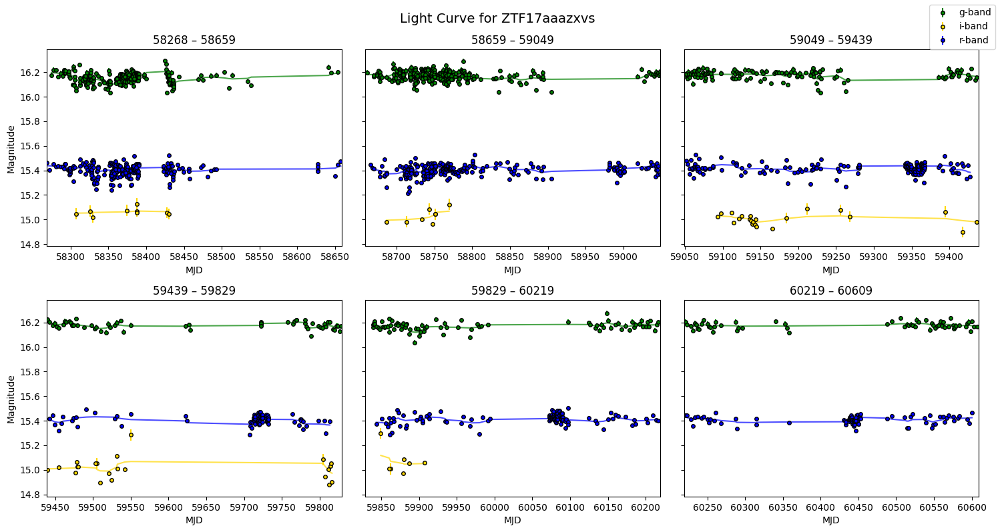

top_class: [np.str_('GlCl') np.str_('PulsV*')]
cat_id: ['Fan2010_252' 'PHAT2_johnson15_1181' 'PHAT_johnson12_551' 'Peacock_288']
tns: ['Unknown']


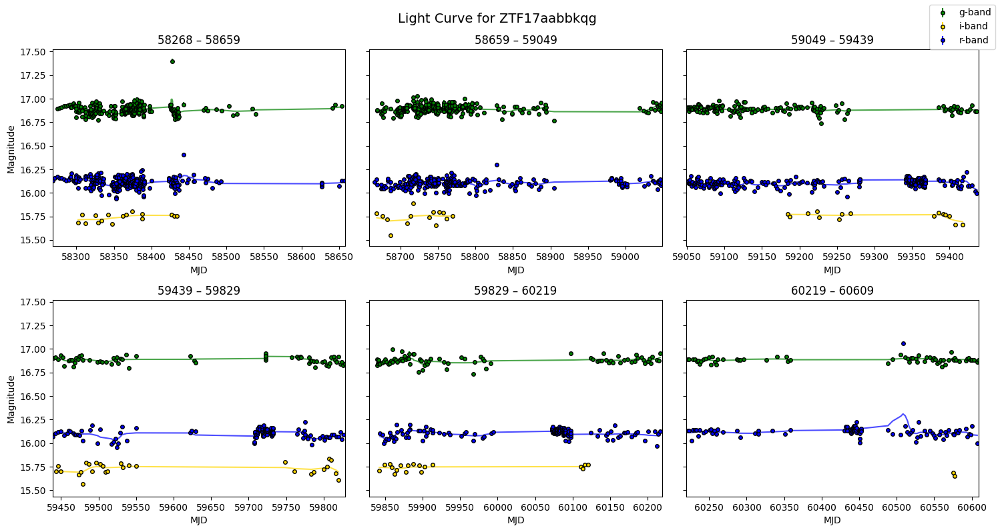

top_class: [np.str_('GlCl')]
cat_id: ['Fan2010_138' 'PHAT2_johnson15_1203' 'Peacock_168']
tns: ['Unknown']


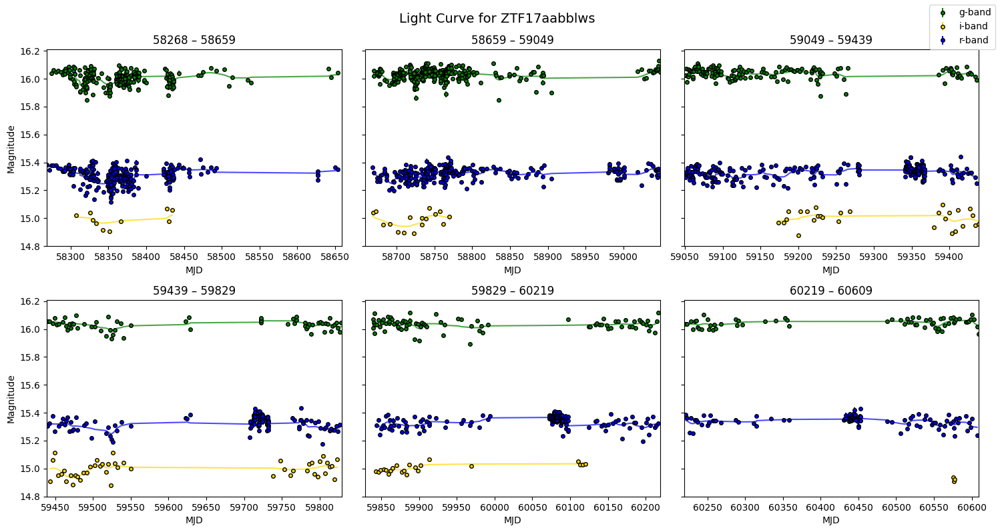

top_class: [np.str_('GlCl') np.str_('Star')]
cat_id: ['Fahrion2019_375' 'Peacock_22']
tns: ['Unknown']


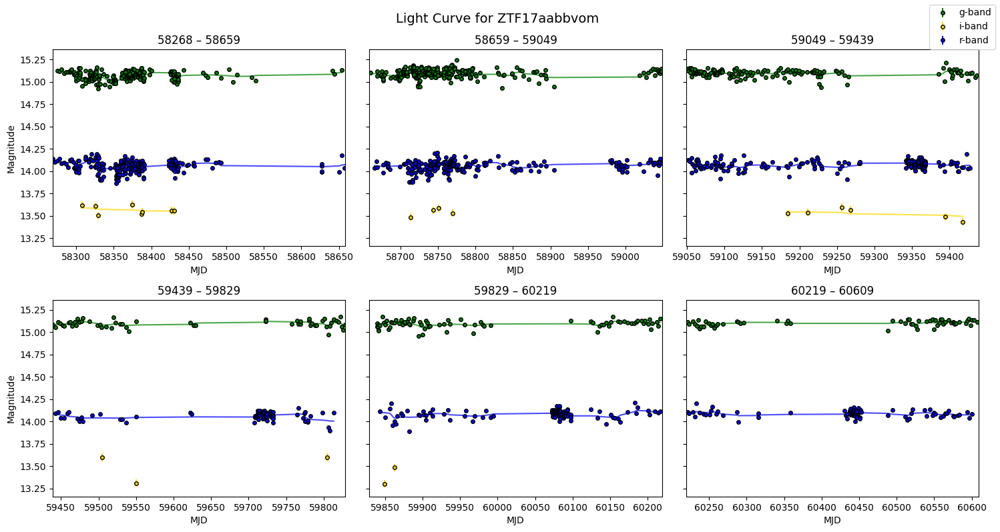

top_class: [np.str_('GlCl') np.str_('GlobCluster')]
cat_id: ['Peacock_17']
tns: ['Unknown']


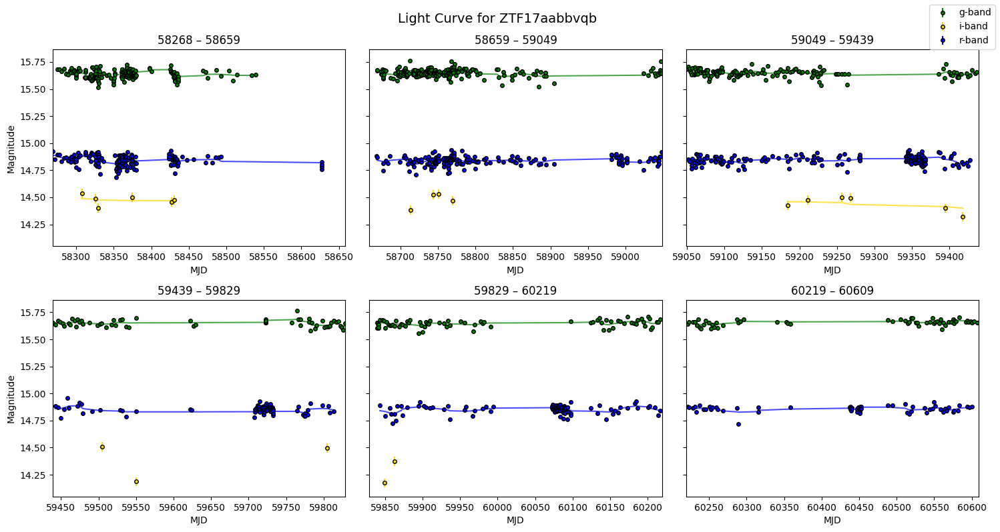

top_class: [np.str_('GlCl') np.str_('LMXB')]
cat_id: ['Fan2010_56' 'Peacock_78']
tns: ['Unknown']


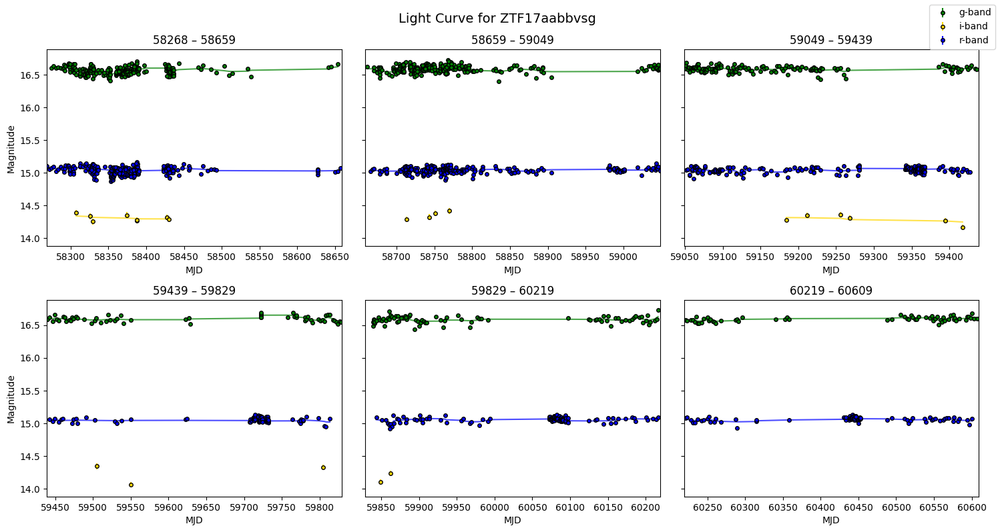

top_class: [np.str_('GlCl')]
cat_id: ['Fan2010_48' 'Peacock_70']
tns: ['Unknown']


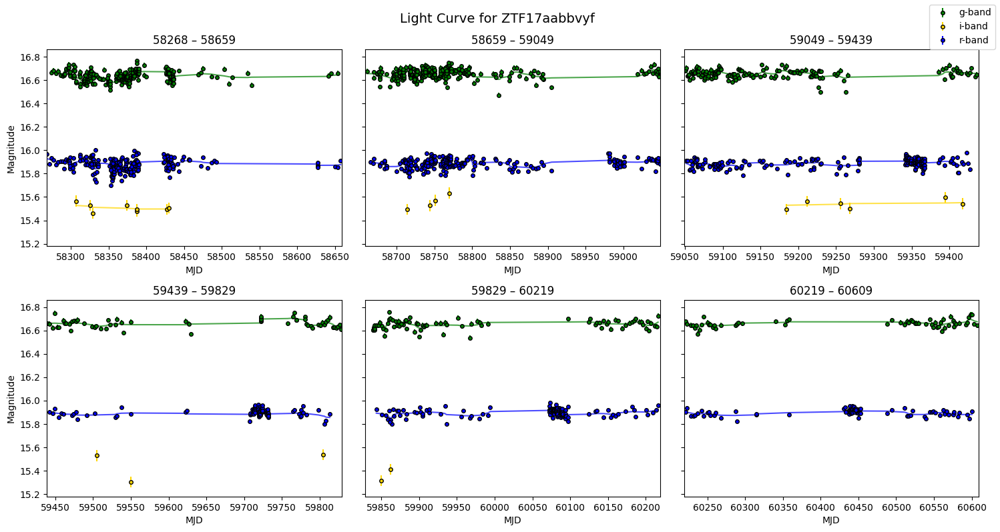

top_class: [np.str_('GlCl') np.str_('Unknown')]
cat_id: ['Fan2010_44' 'Peacock_65']
tns: ['Unknown']


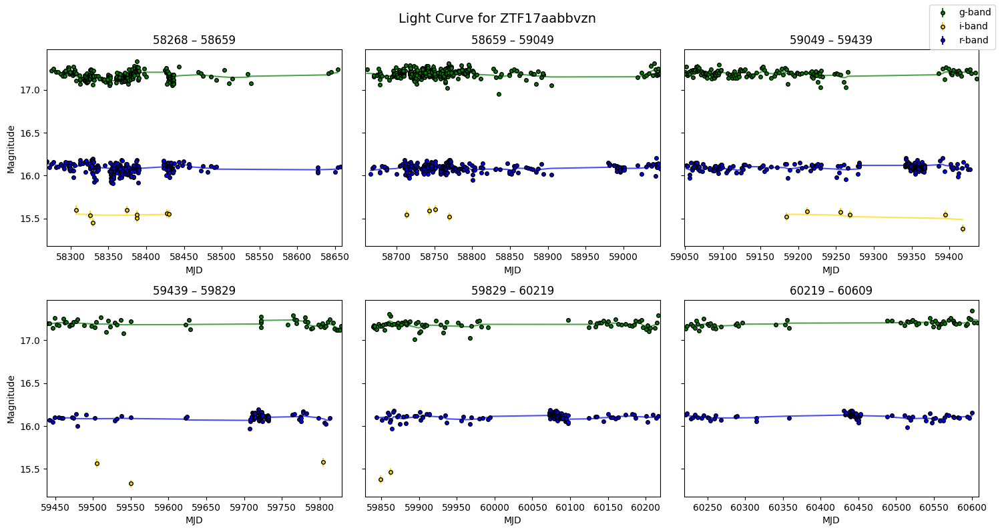

top_class: [np.str_('GinGroup')]
cat_id: ['Seth08_120']
tns: ['Unknown']


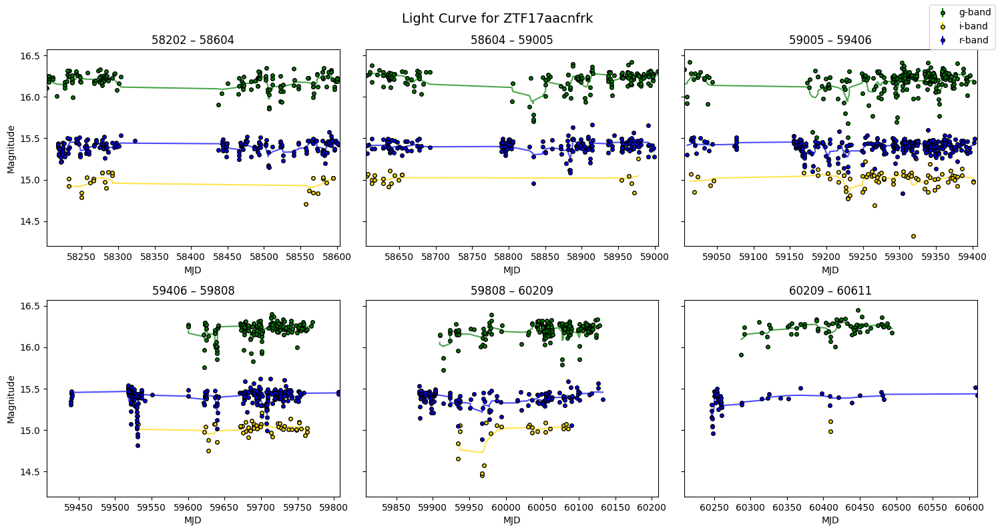

top_class: [np.str_('AGN') np.str_('GinCl') np.str_('Unknown')]
cat_id: ['Baldassare2022_58']
tns: ['Unknown']


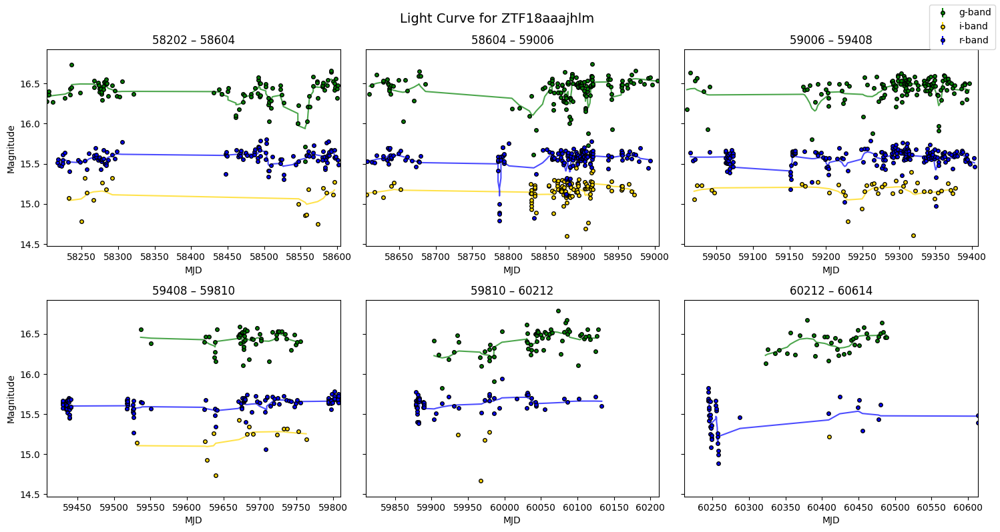

top_class: [np.str_('BClG') np.str_('Radio')]
cat_id: ['M87Kundu_0']
tns: ['Unknown']


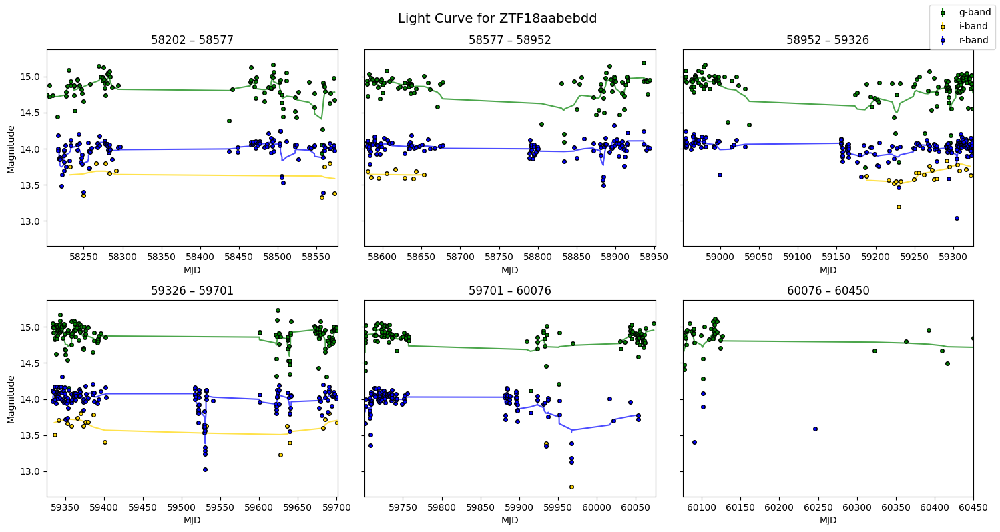

top_class: [np.str_('GinPair')]
cat_id: ['Georgiev2014_39']
tns: ['Unknown']


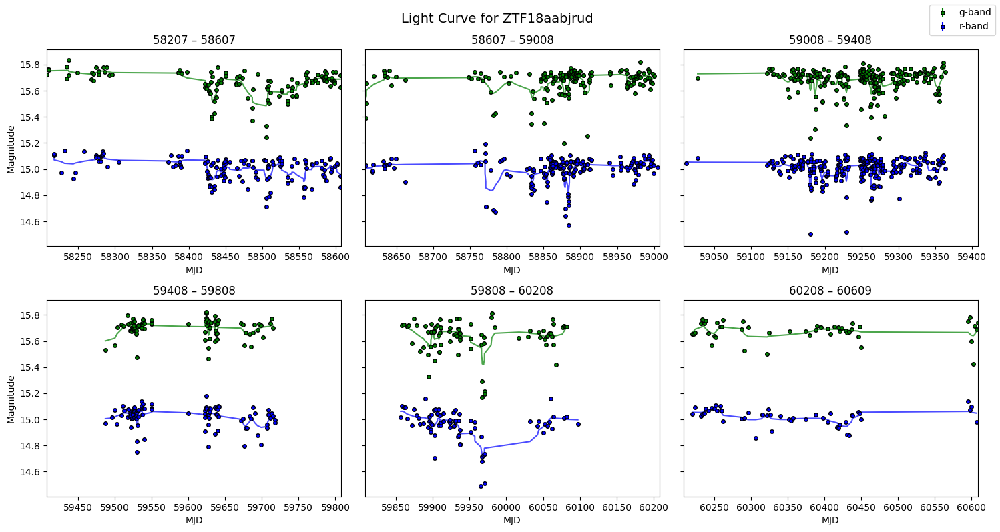

top_class: [np.str_('EB*') np.str_('EclBin') np.str_('Unknown')]
cat_id: ['NGC4382_sources_1308']
tns: ['Unknown']


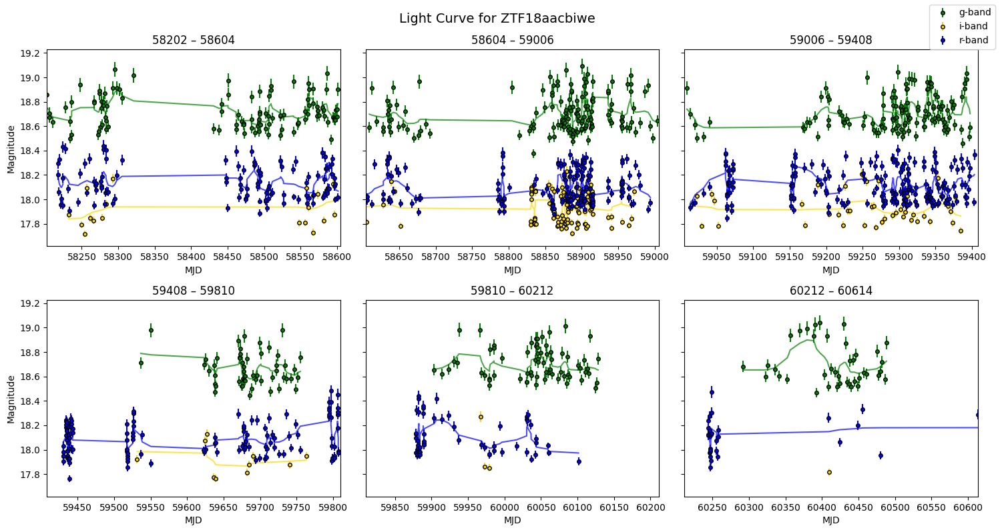

top_class: [np.str_('GinGroup') np.str_('Unknown')]
cat_id: ['Georgiev2014_41']
tns: ['Unknown']


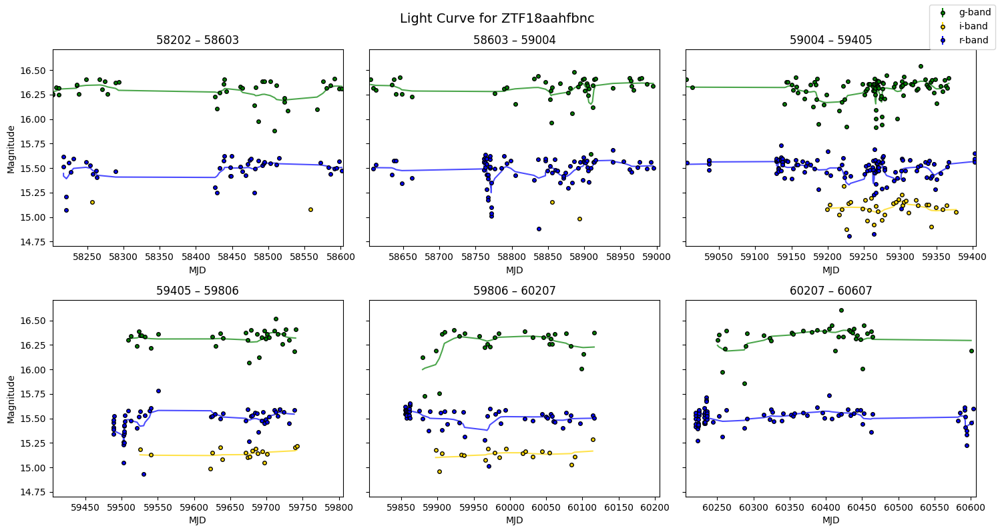

top_class: [np.str_('GinPair') np.str_('Unknown')]
cat_id: ['Seth08_42']
tns: ['Unknown']


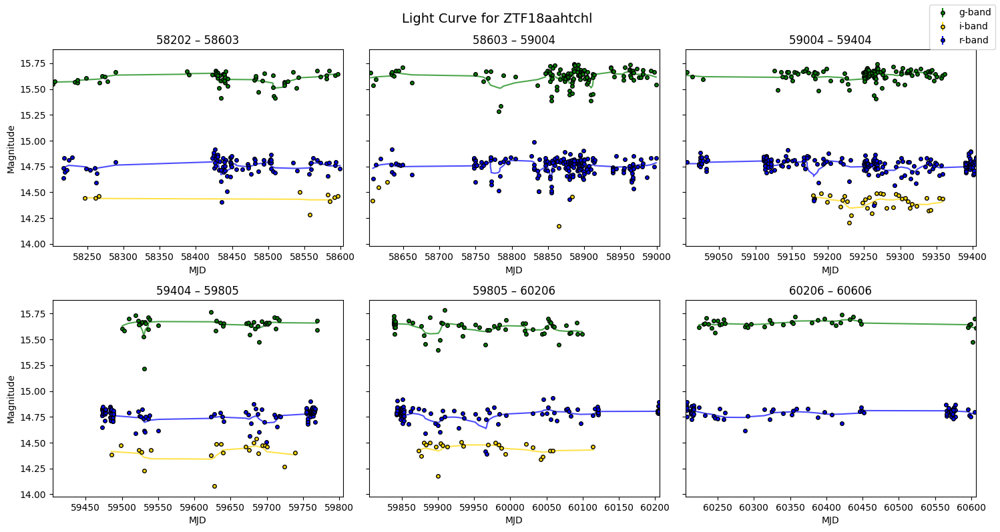

top_class: [np.str_('GinCl') np.str_('GlCl') np.str_('RRLyr') np.str_('RRLyrae')
 np.str_('Unknown')]
cat_id: ['NGC4649_sources_699']
tns: ['Unknown']


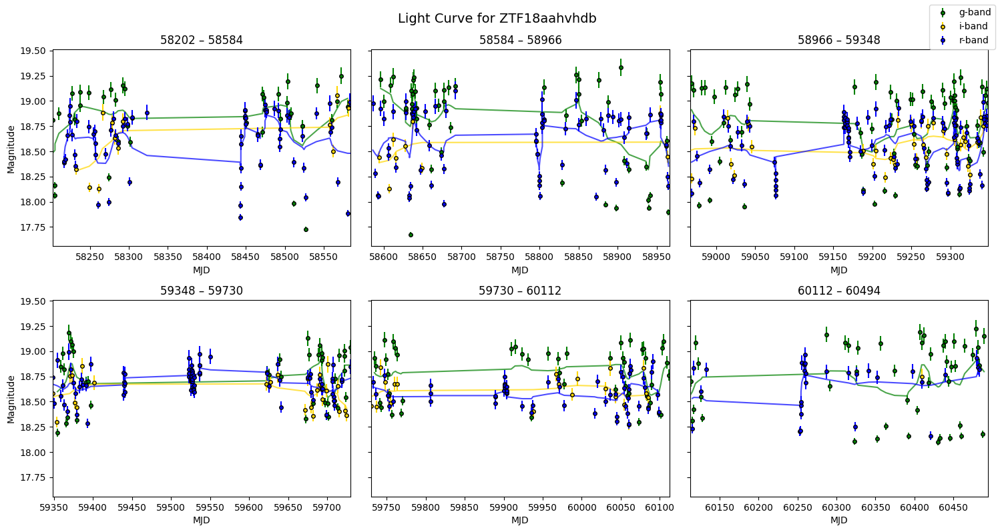

top_class: [np.str_('QSO') np.str_('Unknown')]
cat_id: ['NGC5866_sources_904']
tns: ['Unknown']


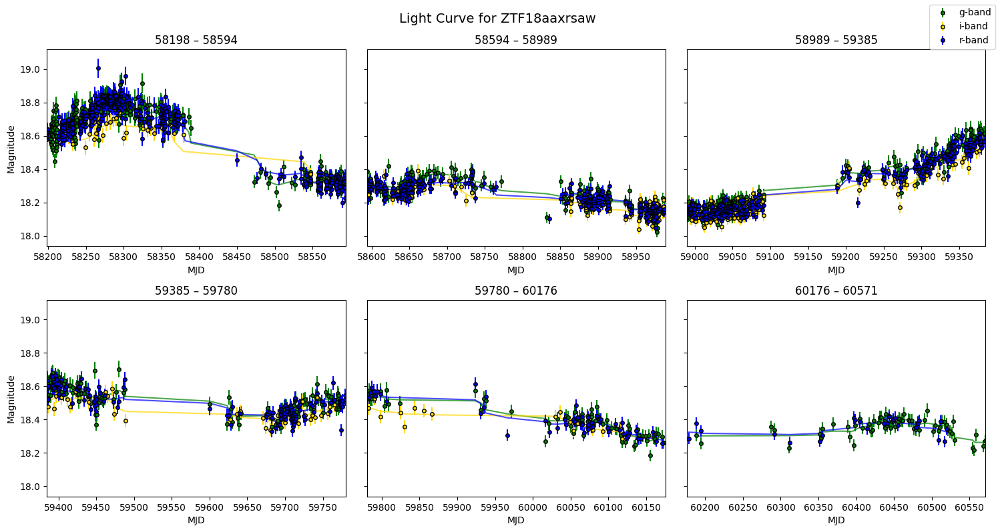

top_class: [np.str_('QSO')]
cat_id: ['Gonzalez-Lopezlira_2']
tns: ['Unknown']


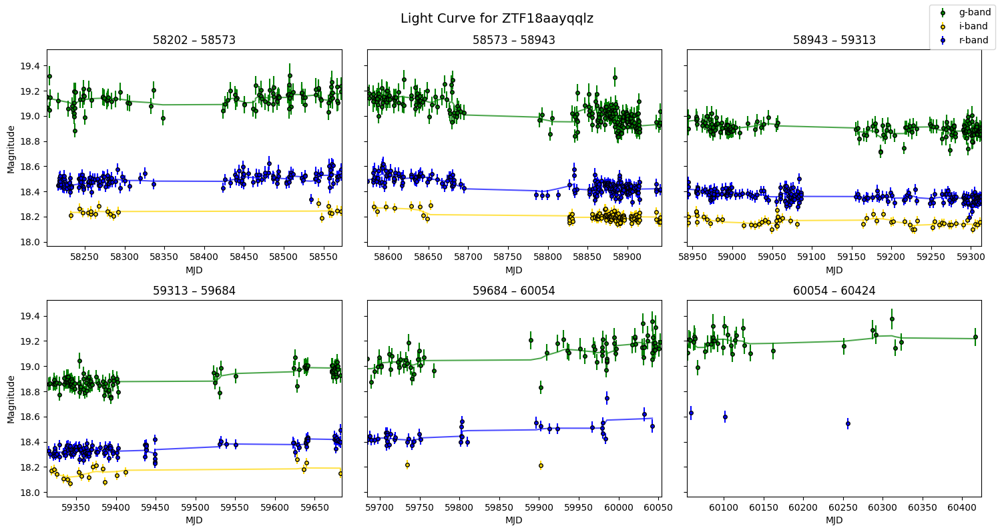

top_class: [np.str_('UV') np.str_('V*')]
cat_id: ['PHAT2_johnson15_1596']
tns: ['Unknown']


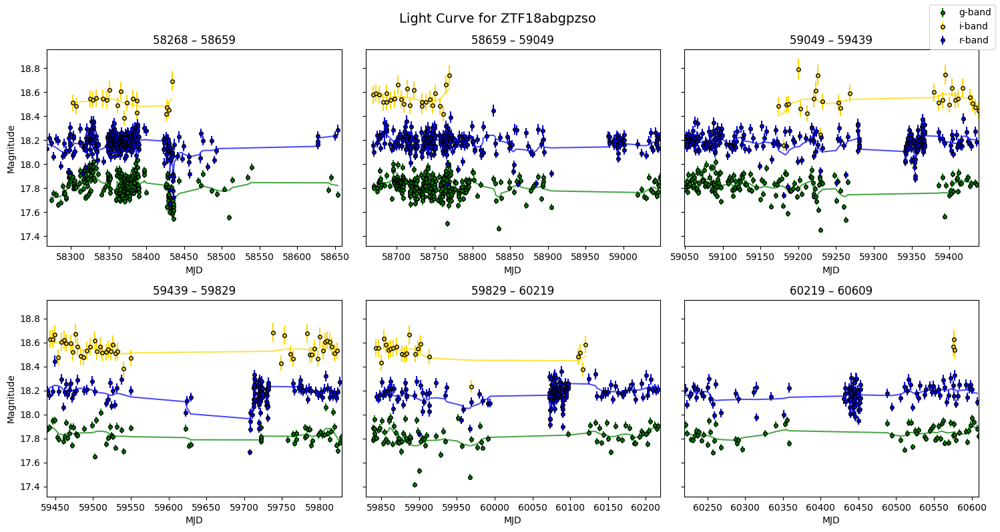

top_class: [np.str_('BlueSG') np.str_('BlueSG*')]
cat_id: ['Fan2010_950' 'Peacock_444']
tns: ['Unknown']


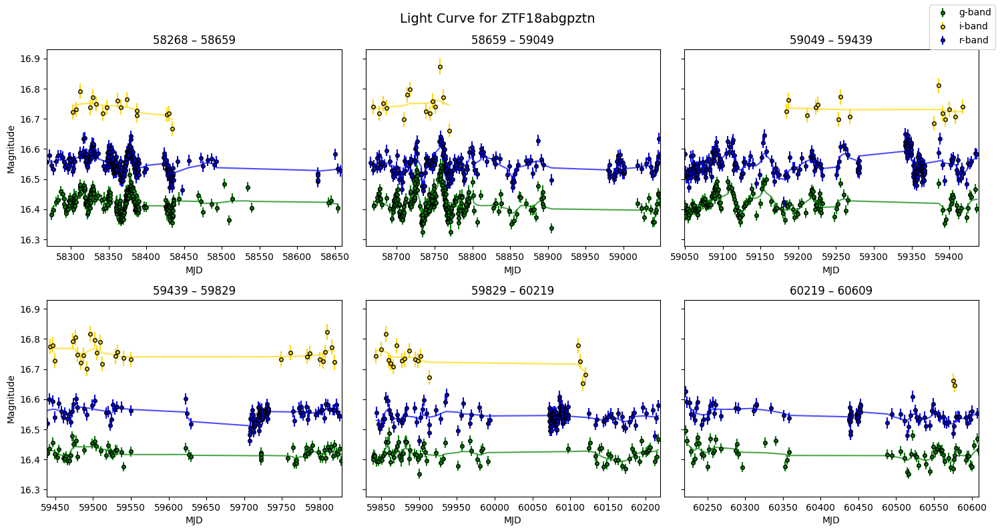

top_class: [np.str_('GlCl') np.str_('Unknown')]
cat_id: ['PHAT2_johnson15_527' 'Peacock_1178']
tns: ['Unknown']


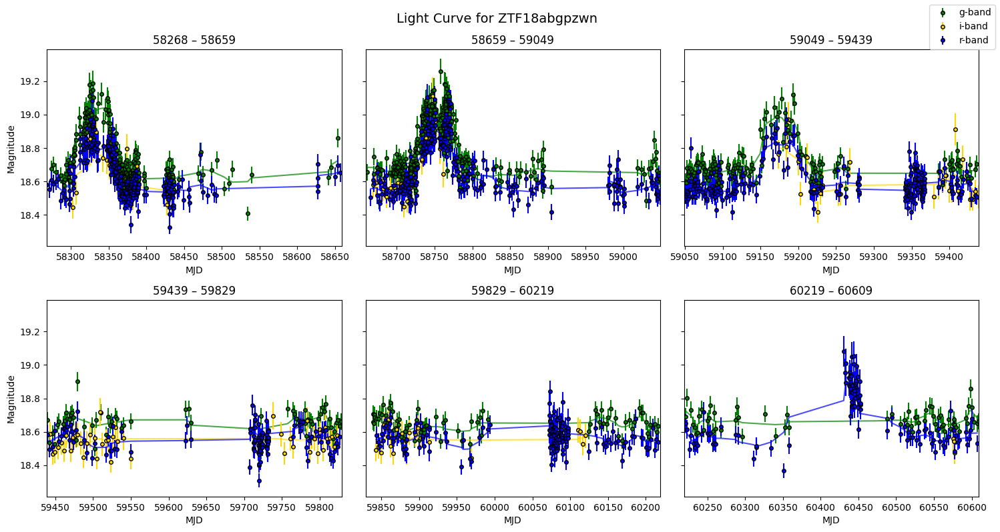

top_class: [np.str_('GlCl') np.str_('PulsV*') np.str_('Unknown')]
cat_id: ['Fahrion2019_374' 'Fan2010_242' 'Peacock_269' 'Vansevicius09_132']
tns: ['Unknown']


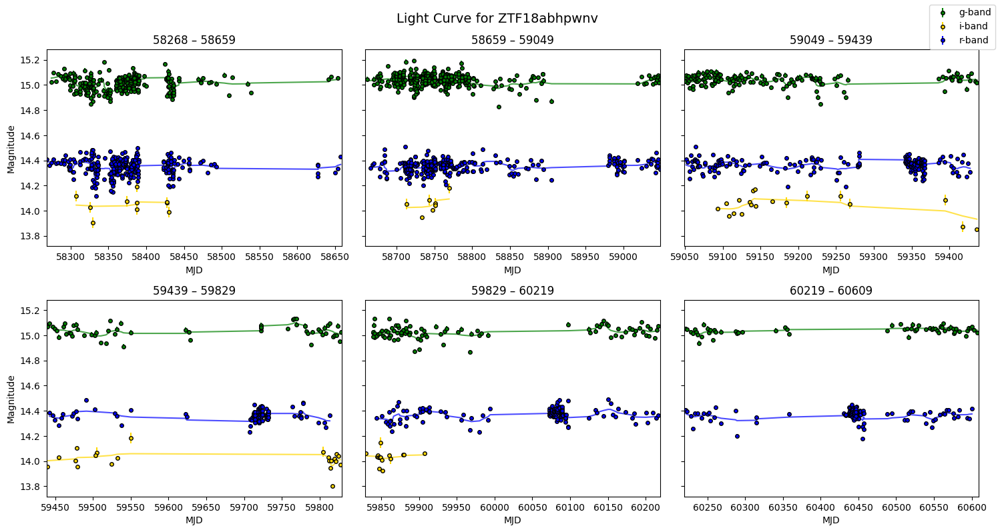

top_class: [np.str_('OpCl') np.str_('Unknown')]
cat_id: ['Peacock_942' 'Vansevicius09_57']
tns: ['Unknown']


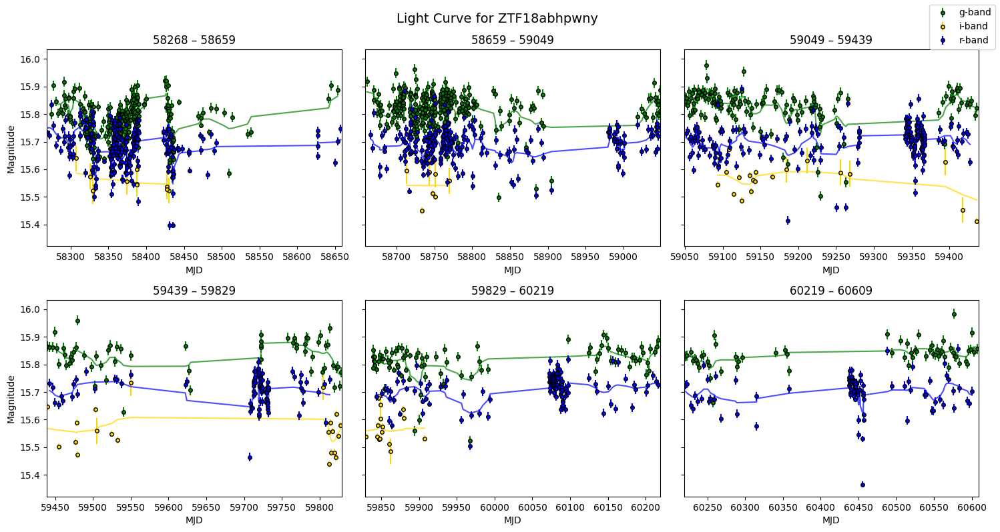

top_class: [np.str_('GlCl')]
cat_id: ['Fan2010_35' 'Peacock_56']
tns: ['Unknown']


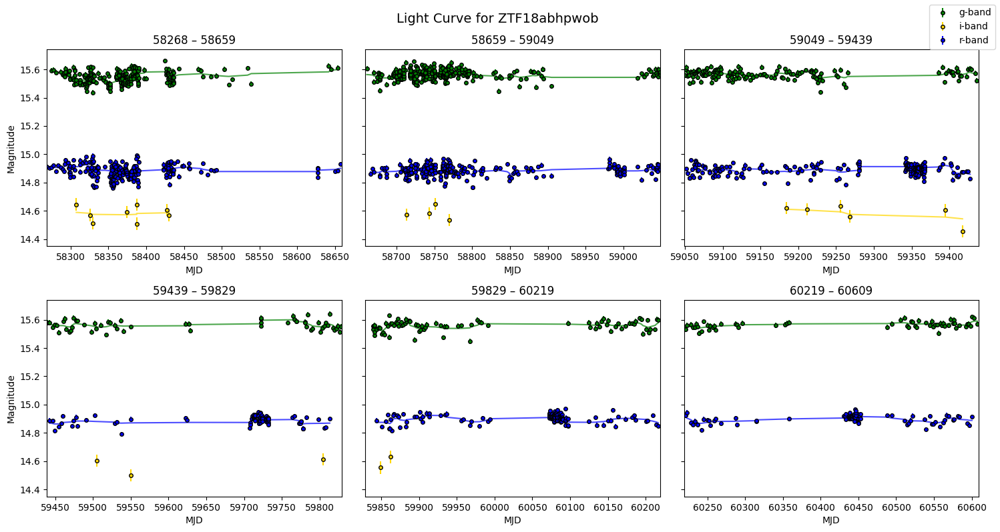

top_class: [np.str_('Candidate_RSG*') np.str_('GlCl')]
cat_id: ['Fan2010_233' 'Peacock_838']
tns: ['Unknown']


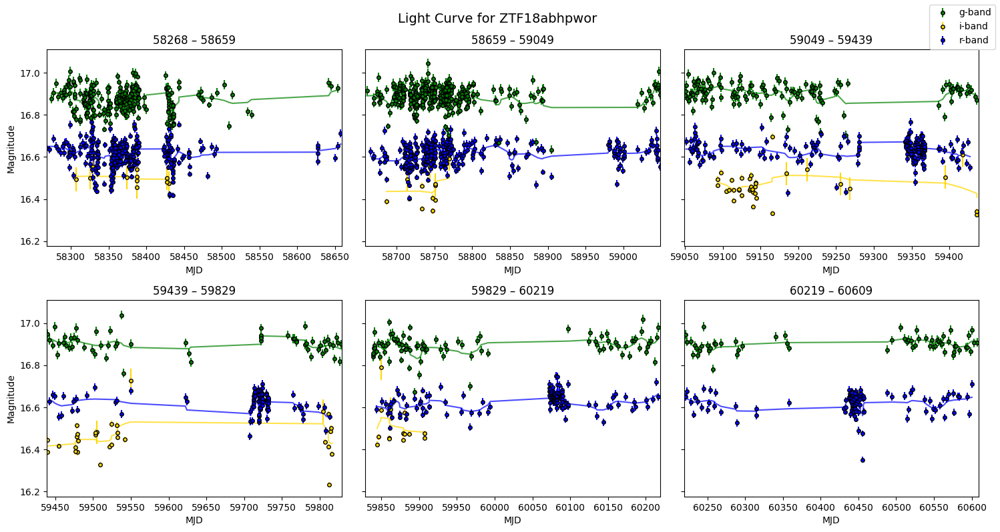

top_class: [np.str_('BSG*_Candidate') np.str_('GlCl') np.str_('UV')
 np.str_('Unknown')]
cat_id: ['Peacock_869' 'Vansevicius09_62']
tns: ['Unknown']


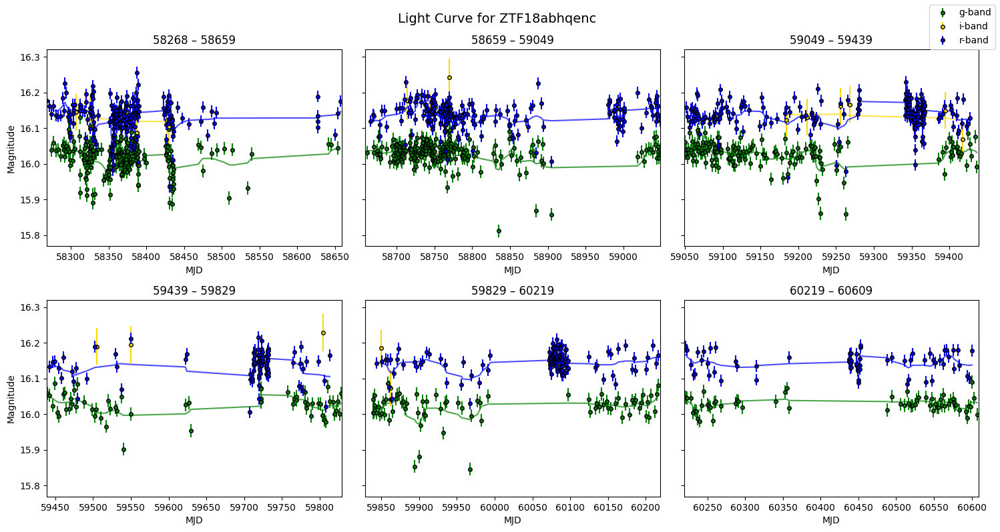

top_class: [np.str_('GlCl') np.str_('Unknown')]
cat_id: ['Fan2010_81' 'Peacock_108']
tns: ['Unknown']


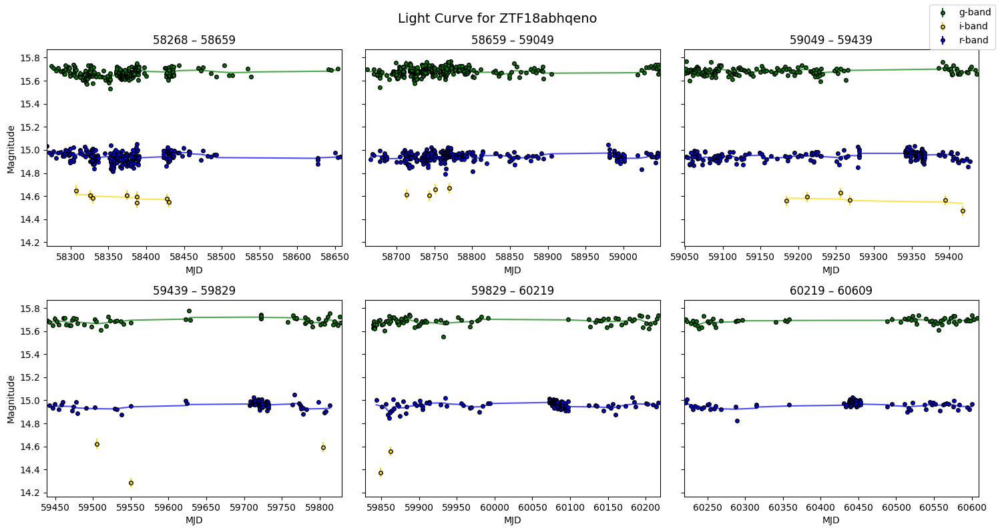

top_class: [np.str_('Star')]
cat_id: ['Fan2010_677' 'Peacock_1359']
tns: ['Unknown']


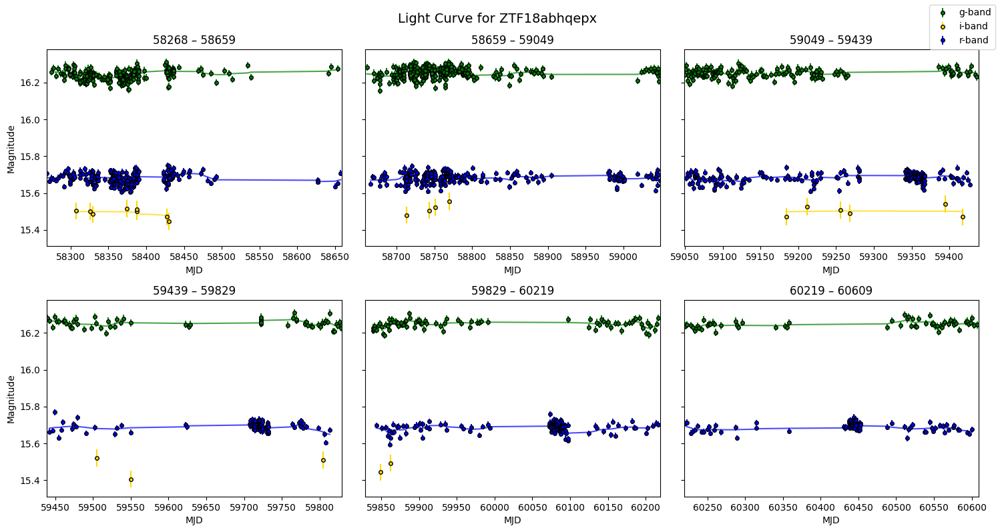

top_class: [np.str_('GlCl')]
cat_id: ['Peacock_846' 'Vansevicius09_37']
tns: ['Unknown']


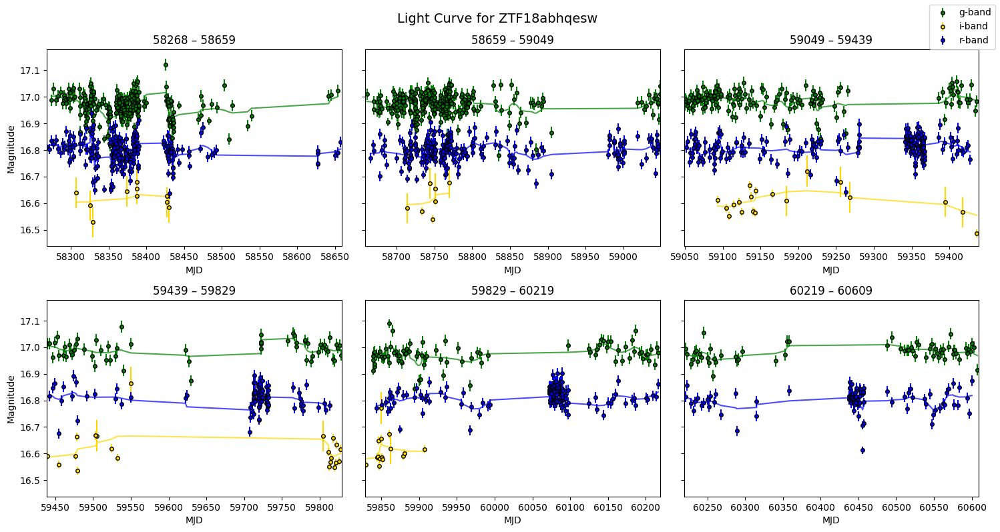

top_class: [np.str_('GlCl')]
cat_id: ['Fan2010_231' 'Peacock_258']
tns: ['Unknown']


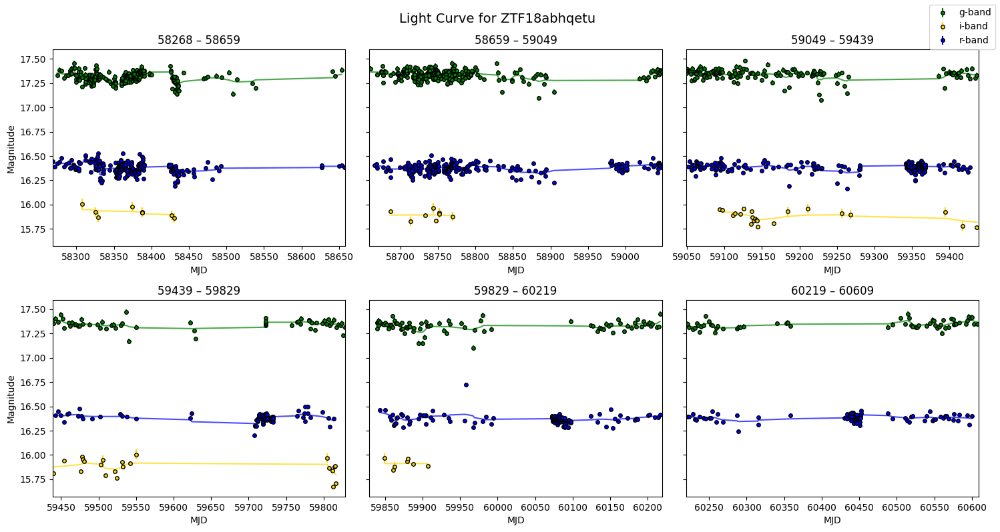

top_class: [np.str_('GlCl')]
cat_id: ['Fan2010_243' 'Peacock_271' 'Vansevicius09_158']
tns: ['Unknown']


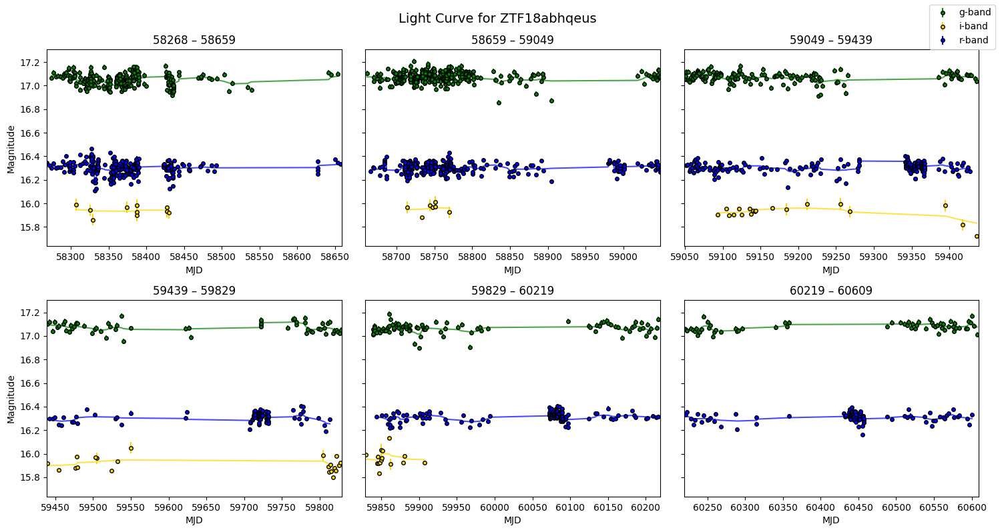

top_class: [np.str_('GlCl')]
cat_id: ['Fan2010_9' 'Vansevicius09_169']
tns: ['Unknown']


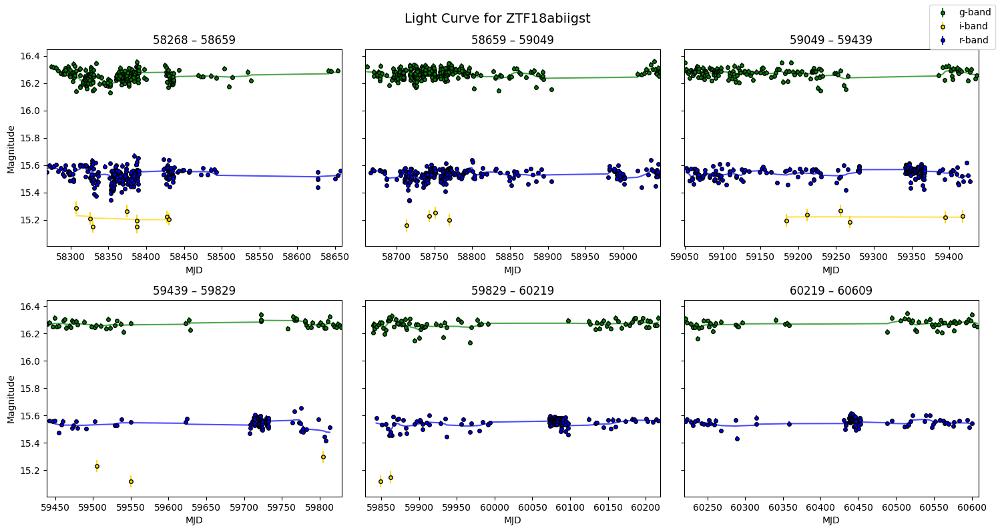

top_class: [np.str_('GlCl')]
cat_id: ['Peacock_24']
tns: ['Unknown']


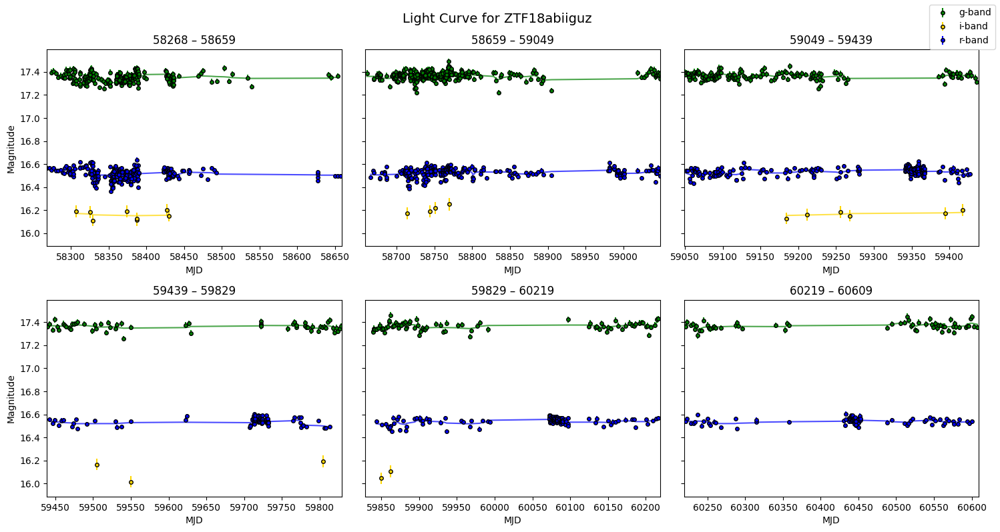

top_class: [np.str_('EB*') np.str_('EclBin') np.str_('Star')]
cat_id: ['Fan2010_783' 'Peacock_1506']
tns: ['Unknown']


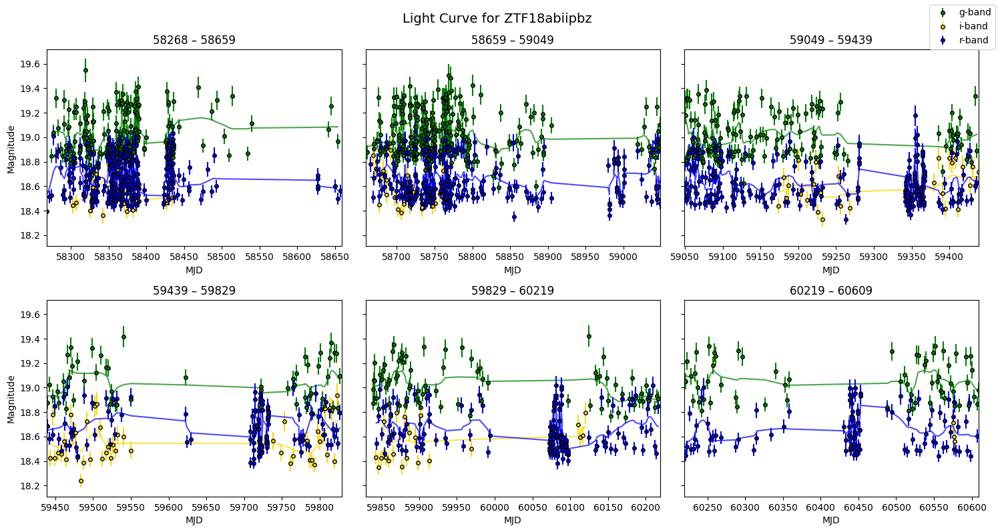

top_class: [np.str_('GlCl') np.str_('Nova')]
cat_id: ['Fan2010_82' 'Peacock_109']
tns: ['Unknown']


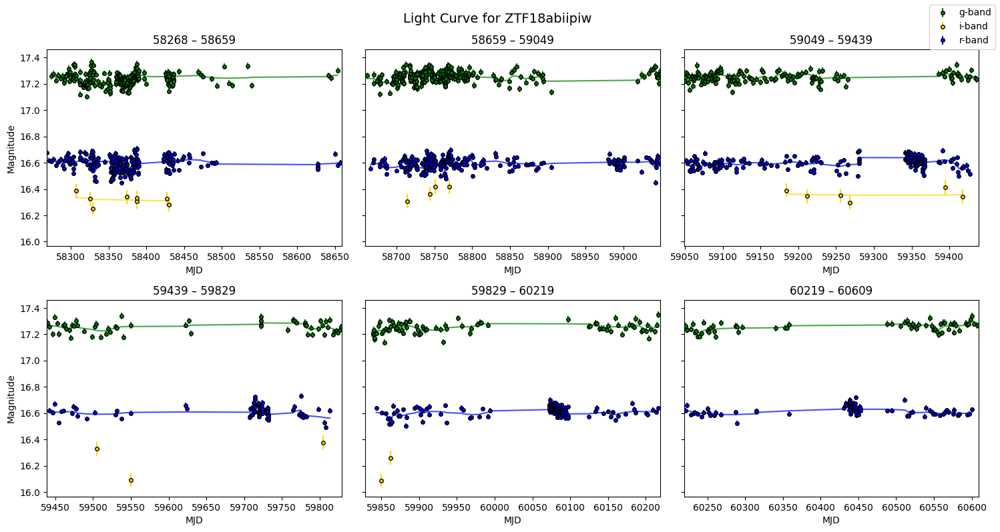

top_class: [np.str_('Cl*') np.str_('Star') np.str_('Unknown') np.str_('WR*')]
cat_id: ['PHAT2_johnson15_598']
tns: ['Unknown']


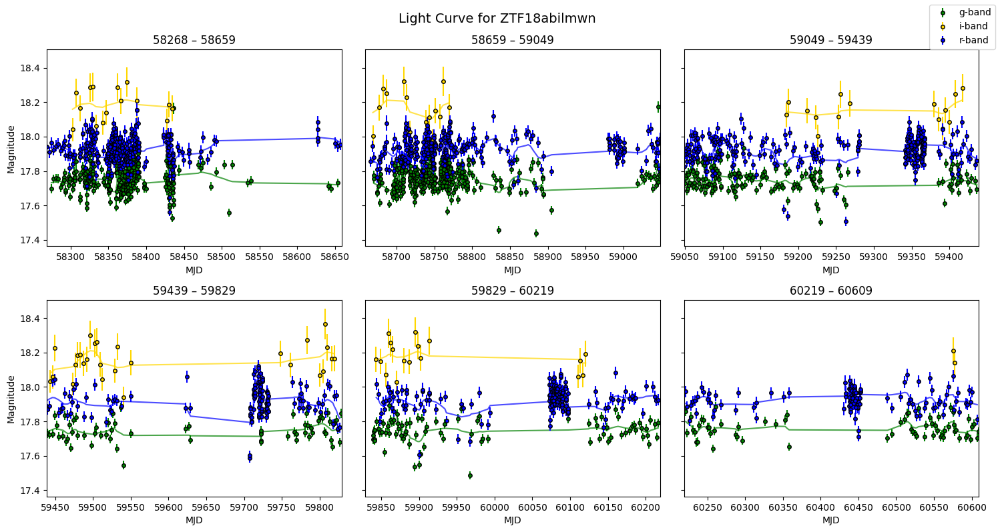

top_class: [np.str_('GlCl')]
cat_id: ['Fan2010_254' 'PHAT2_johnson15_398']
tns: ['Unknown']


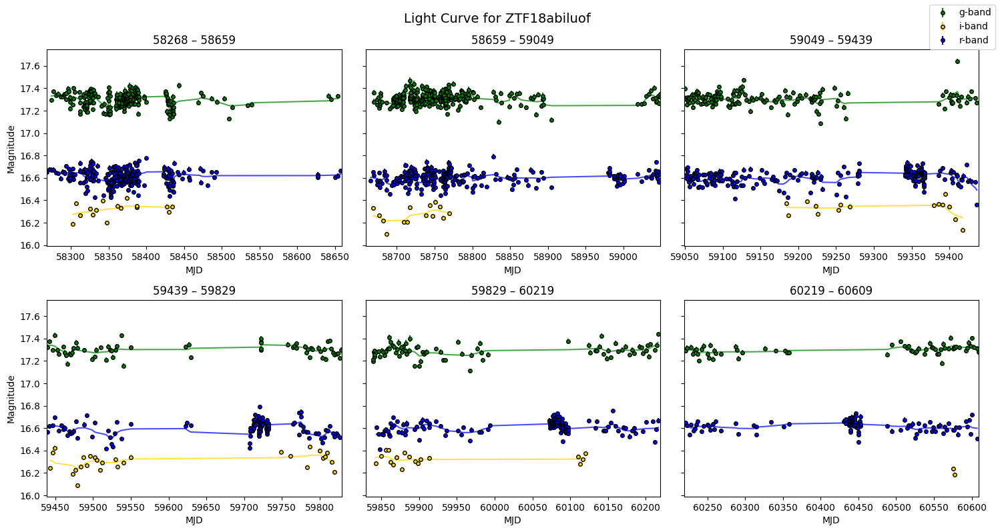

top_class: [np.str_('GlCl') np.str_('MIR') np.str_('Star')]
cat_id: ['PHAT2_johnson15_1214']
tns: ['Unknown']


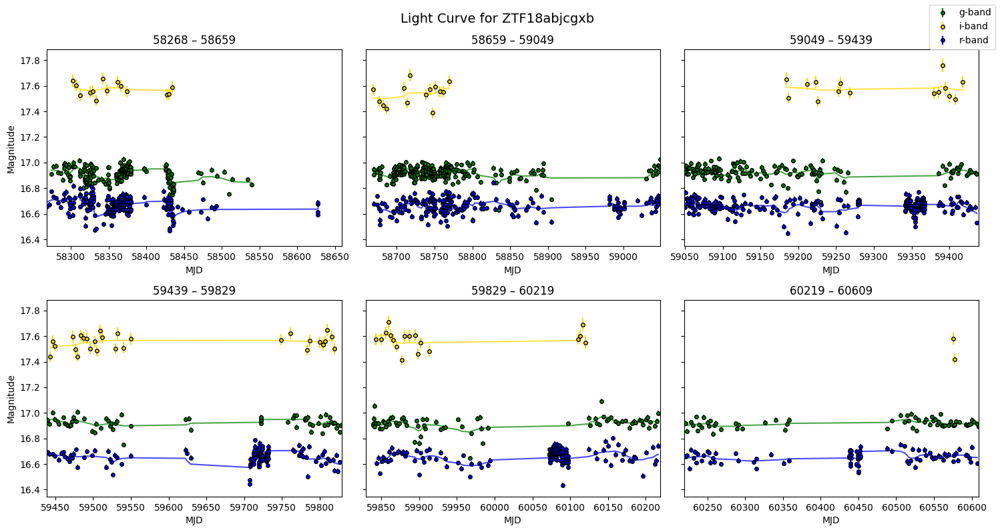

top_class: [np.str_('GlCl') np.str_('GlobCluster')]
cat_id: ['Fan2010_187' 'PHAT2_johnson15_1518']
tns: ['Unknown']


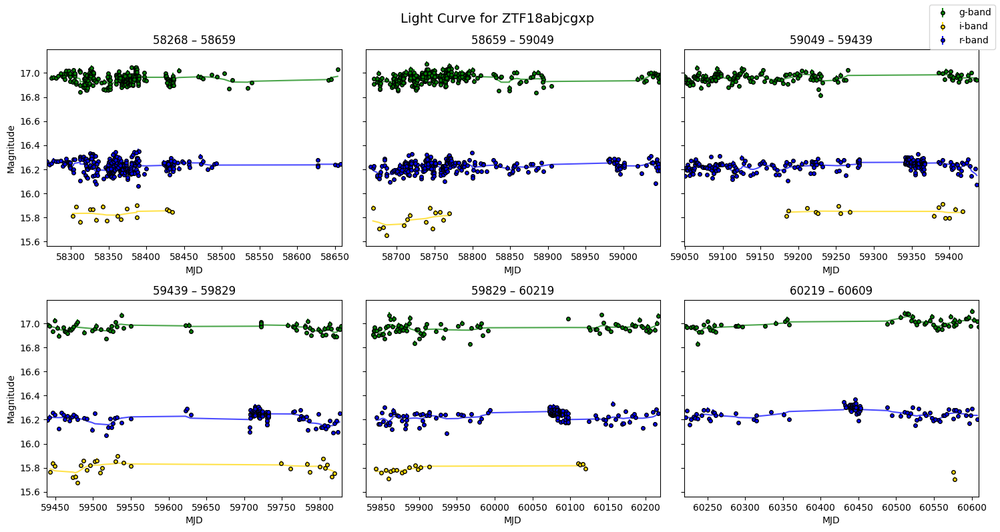

top_class: [np.str_('GlCl') np.str_('Unknown')]
cat_id: ['Fan2010_549' 'PHAT2_johnson15_106']
tns: ['Unknown']


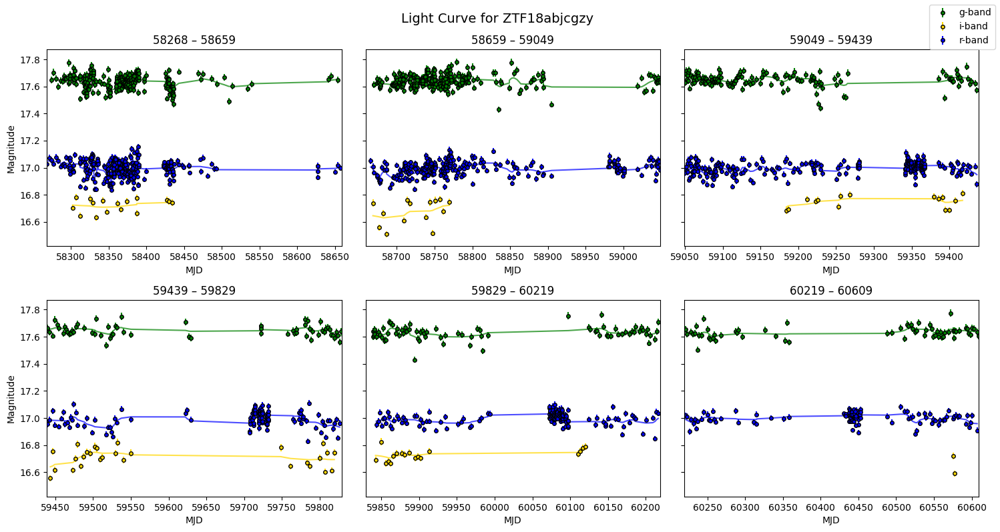

top_class: [np.str_('Cepheid') np.str_('Cl*') np.str_('ClassicalCep')
 np.str_('GlCl?') np.str_('Unknown') np.str_('deltaCep')]
cat_id: ['Fan2010_959' 'PHAT2_johnson15_739']
tns: ['Unknown']


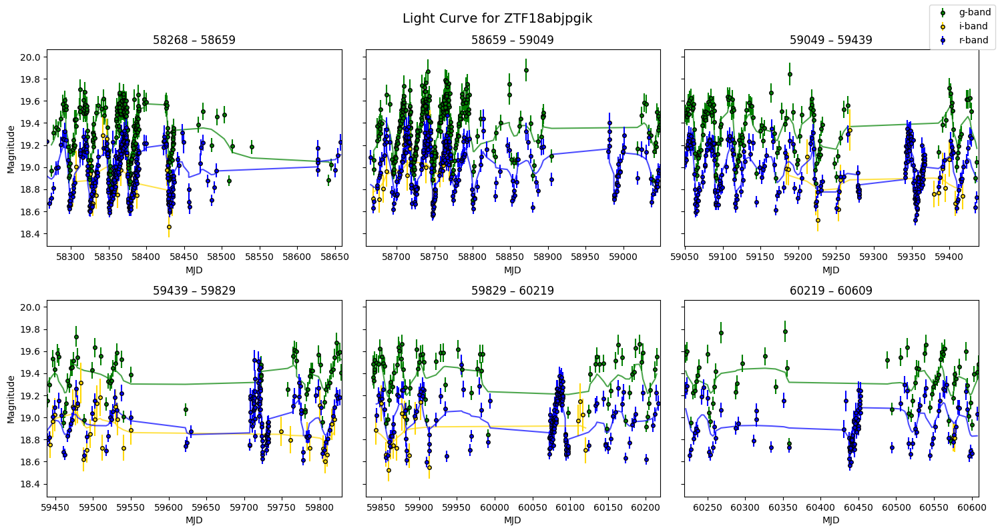

top_class: [np.str_('Candidate_BSG*') np.str_('Cl*')]
cat_id: ['PHAT2_johnson15_1387' 'PHAT_johnson12_171']
tns: ['Unknown']


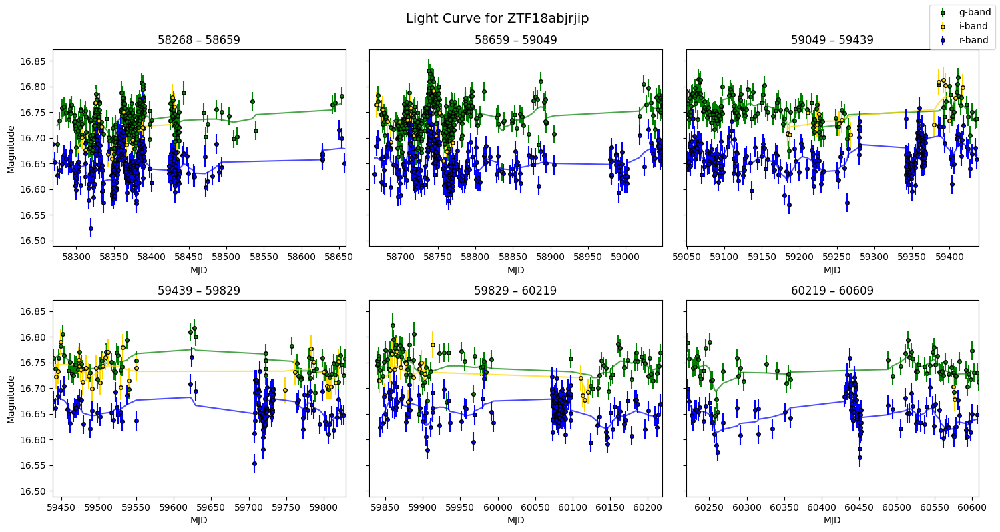

top_class: [np.str_('LPV*') np.str_('Star') np.str_('Unknown')]
cat_id: ['Fan2010_458' 'Peacock_1176']
tns: ['Unknown']


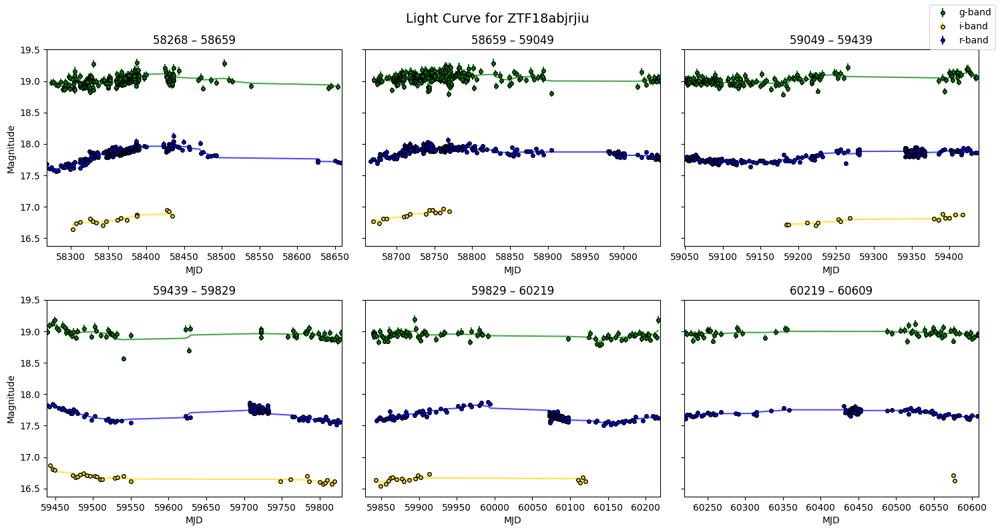

top_class: [np.str_('EclBin') np.str_('Unknown')]
cat_id: ['NGC7332_sources_3' 'NGC7339_sources_3']
tns: ['Unknown']


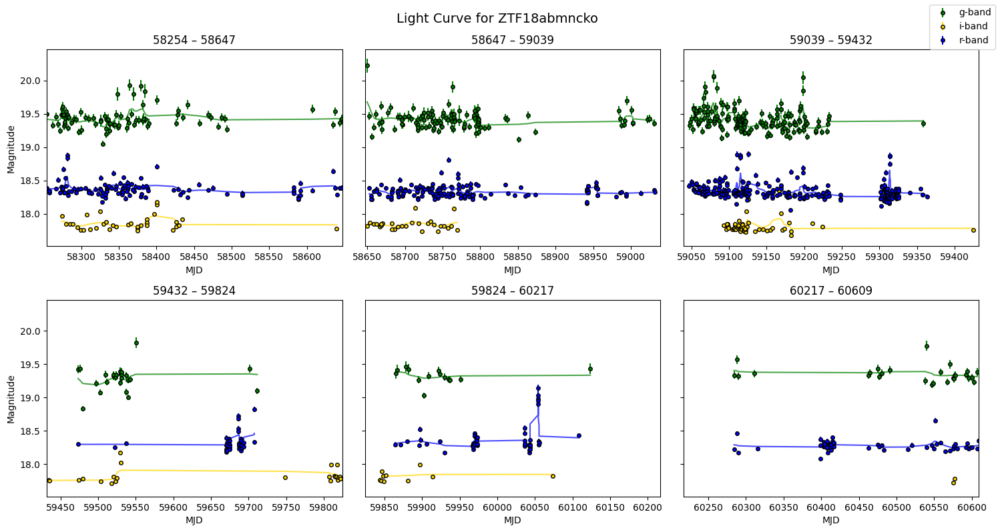

top_class: [np.str_('GlCl')]
cat_id: ['Fan2010_39' 'Peacock_60']
tns: ['Unknown']


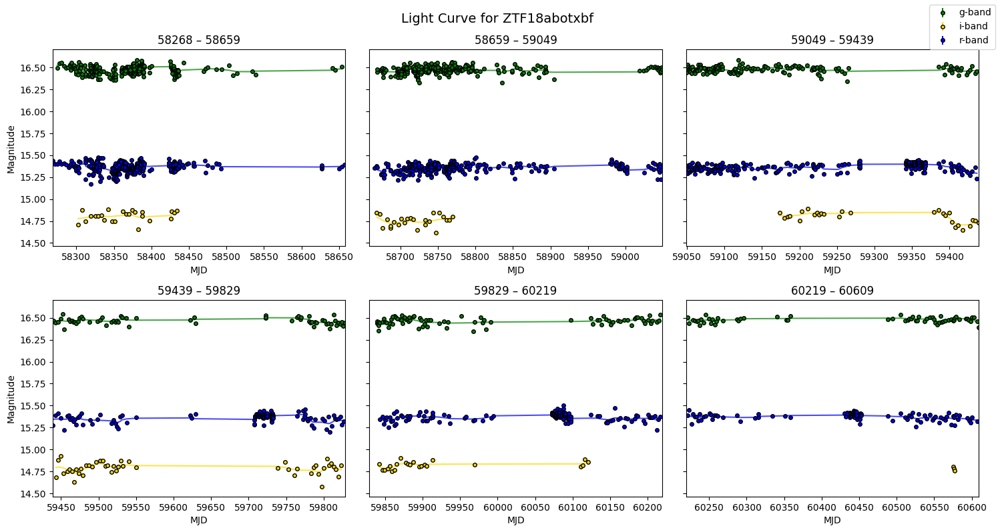

top_class: [np.str_('Star')]
cat_id: ['Peacock_1444']
tns: ['Unknown']


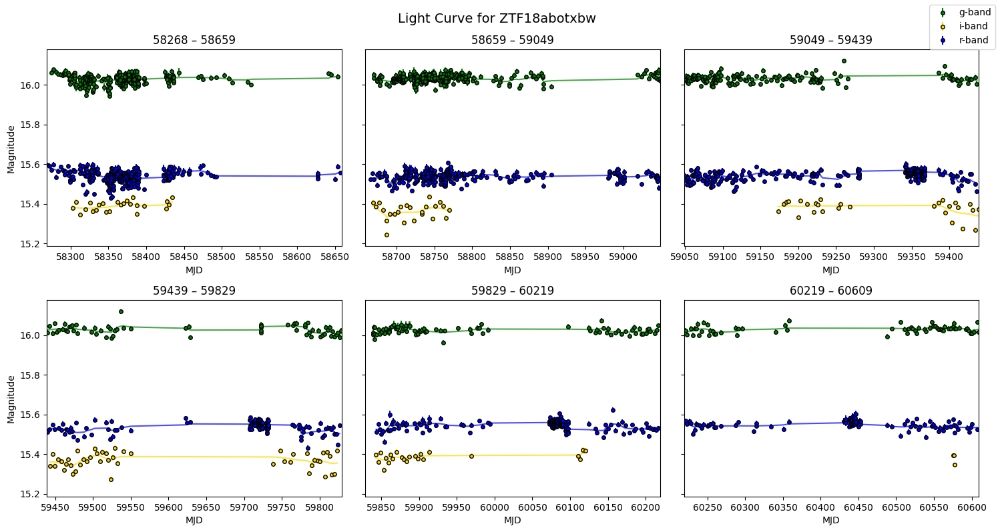

top_class: [np.str_('GlCl')]
cat_id: ['Fan2010_60' 'Peacock_85']
tns: ['Unknown']


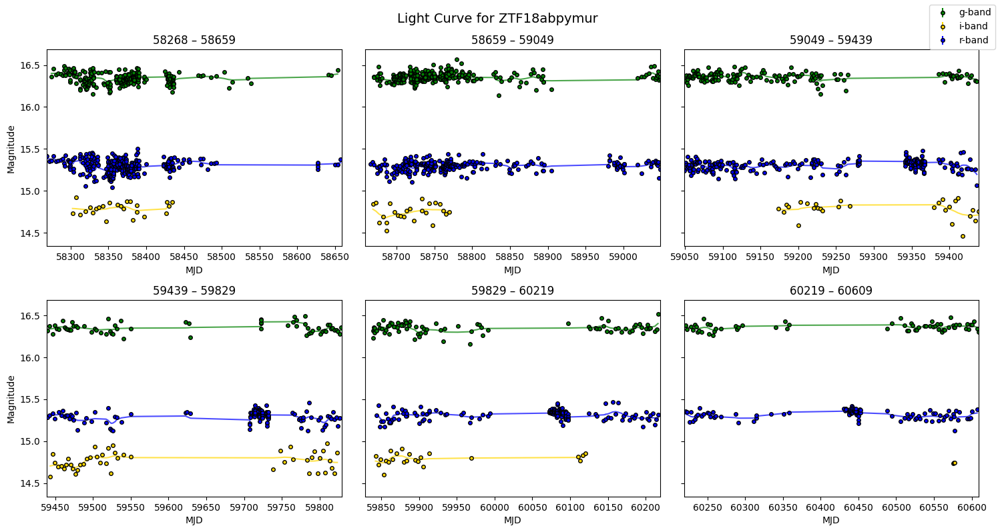

top_class: [np.str_('GlCl')]
cat_id: ['Fan2010_29' 'Peacock_50']
tns: ['Unknown']


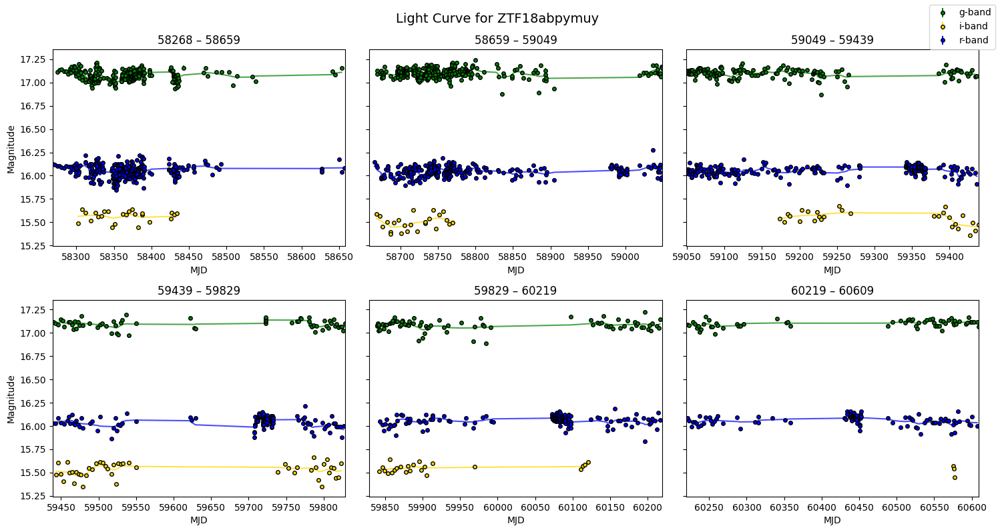

top_class: [np.str_('Cl*') np.str_('Cluster*') np.str_('EB*') np.str_('Unknown')]
cat_id: ['PHAT2_johnson15_1922']
tns: ['Unknown']


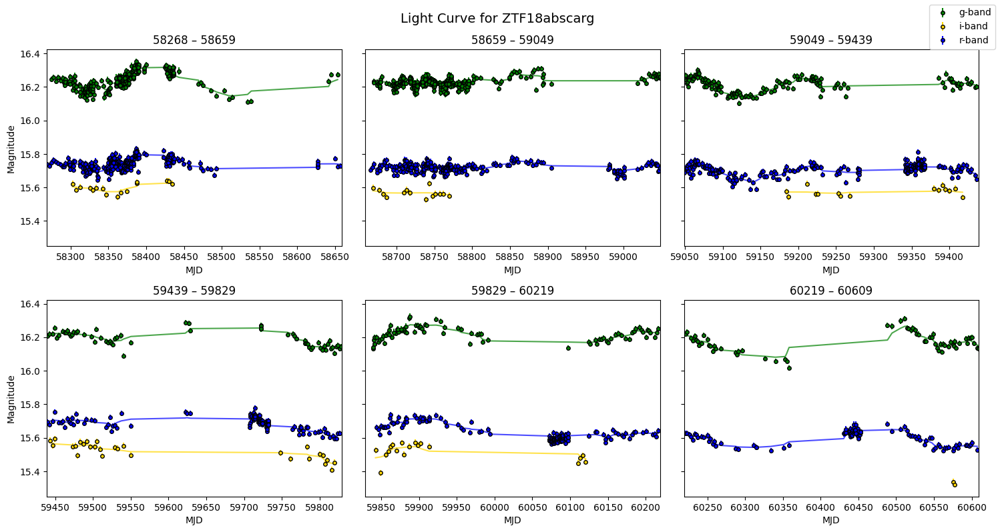

top_class: [np.str_('Cl*')]
cat_id: ['PHAT2_johnson15_2552']
tns: ['Unknown']


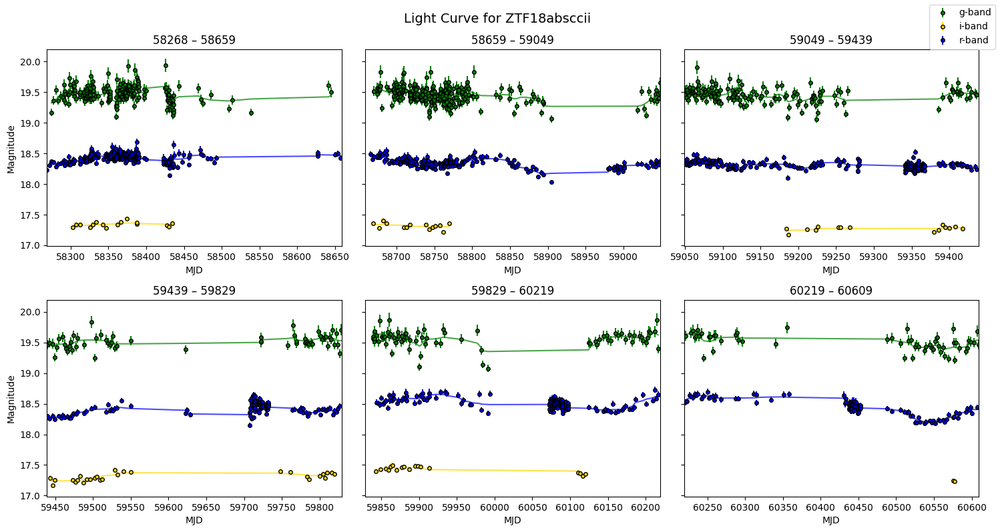

top_class: [np.str_('Cepheid')]
cat_id: ['Fan2010_881' 'Peacock_710']
tns: ['Unknown']


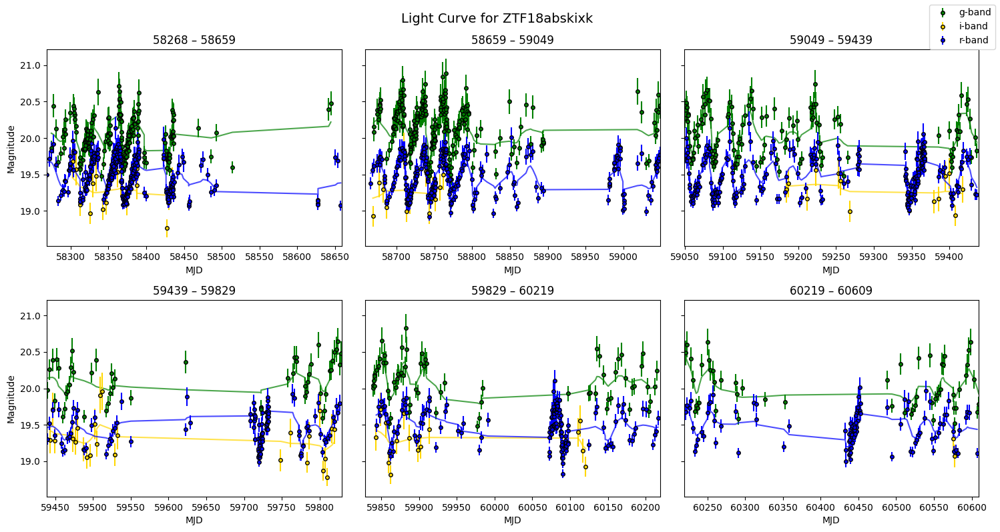

top_class: [np.str_('GlCl')]
cat_id: ['Fahrion2019_19' 'Fahrion2019_373' 'Peacock_330']
tns: ['Unknown']


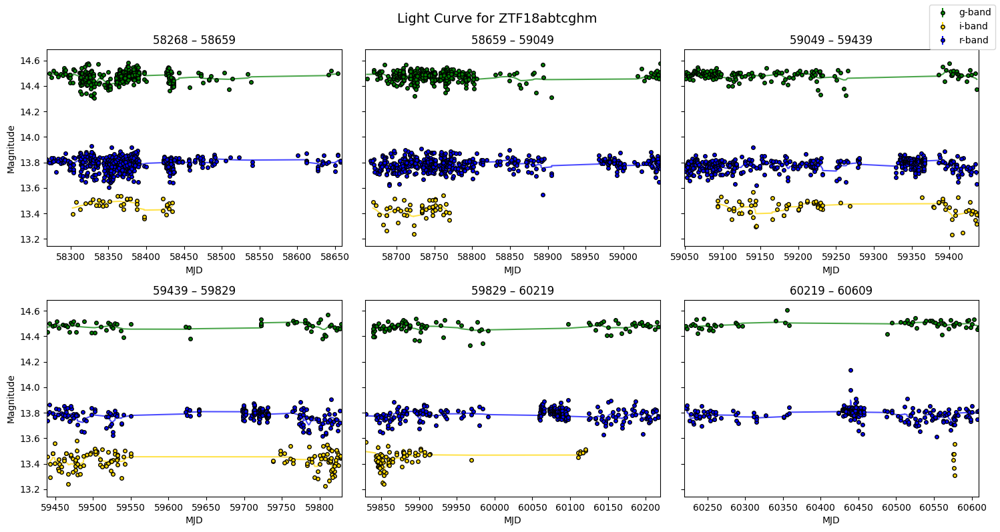

top_class: [np.str_('GlCl')]
cat_id: ['Fan2010_174' 'PHAT2_johnson15_614']
tns: ['Unknown']


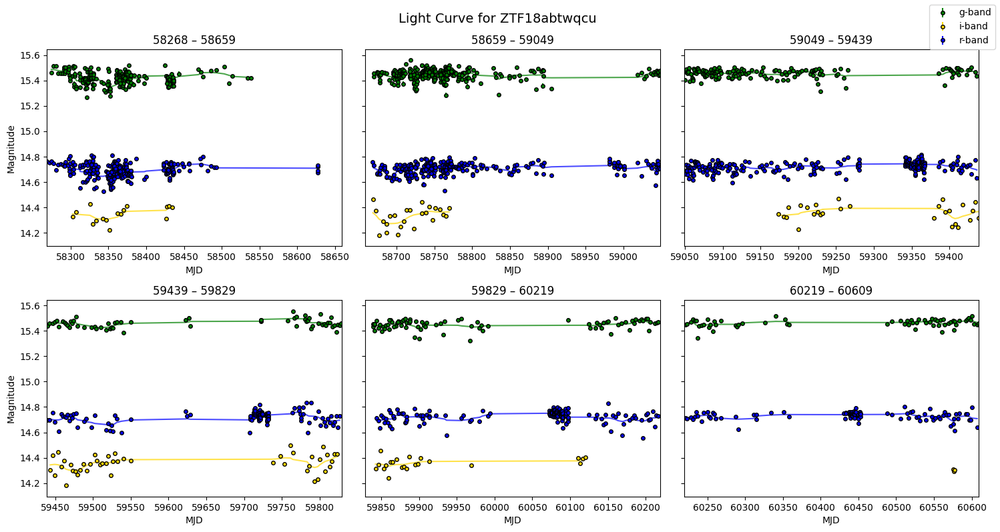

top_class: [np.str_('GlCl') np.str_('GlobCluster')]
cat_id: ['Peacock_148']
tns: ['Unknown']


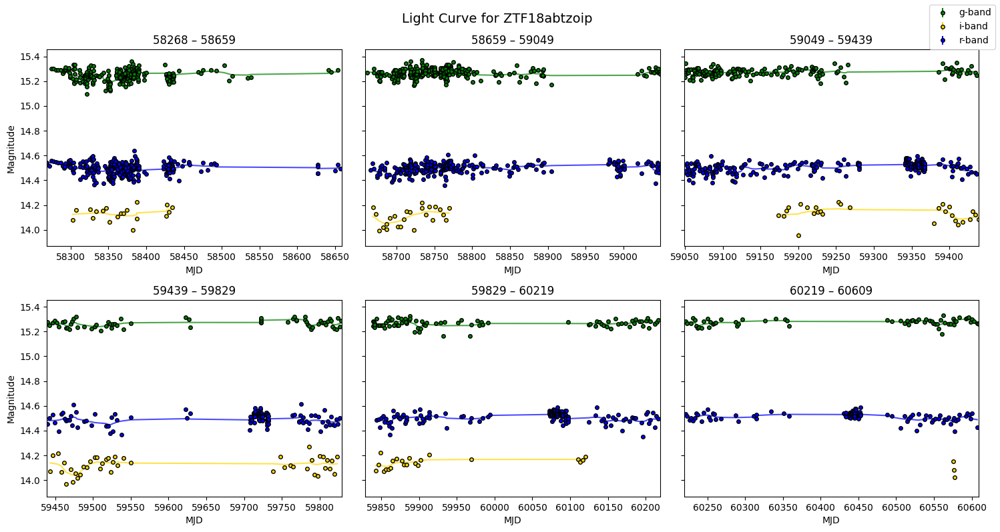

top_class: [np.str_('GlCl') np.str_('Unknown')]
cat_id: ['Fan2010_179']
tns: ['Unknown']


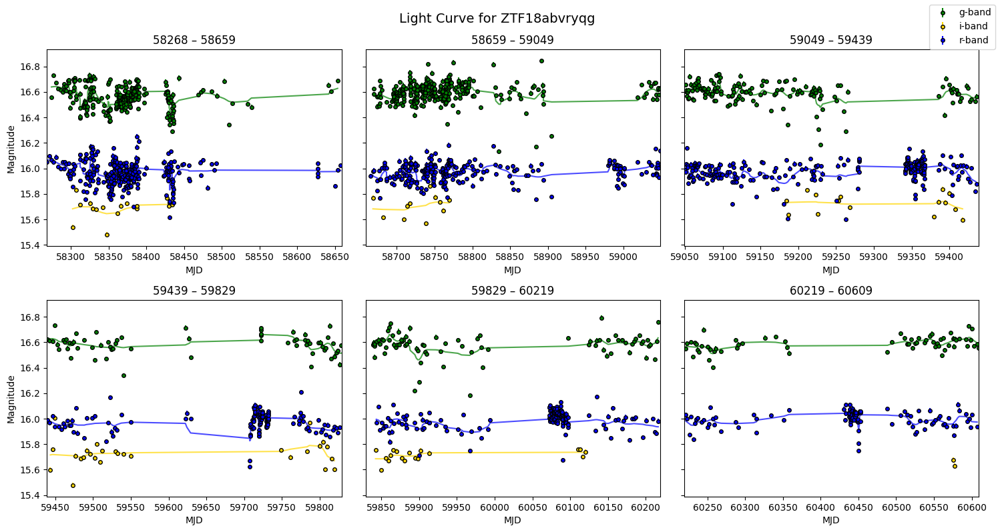

top_class: [np.str_('GlCl') np.str_('Unknown')]
cat_id: ['Fan2010_179' 'PHAT2_johnson15_164' 'Peacock_207']
tns: ['Unknown']


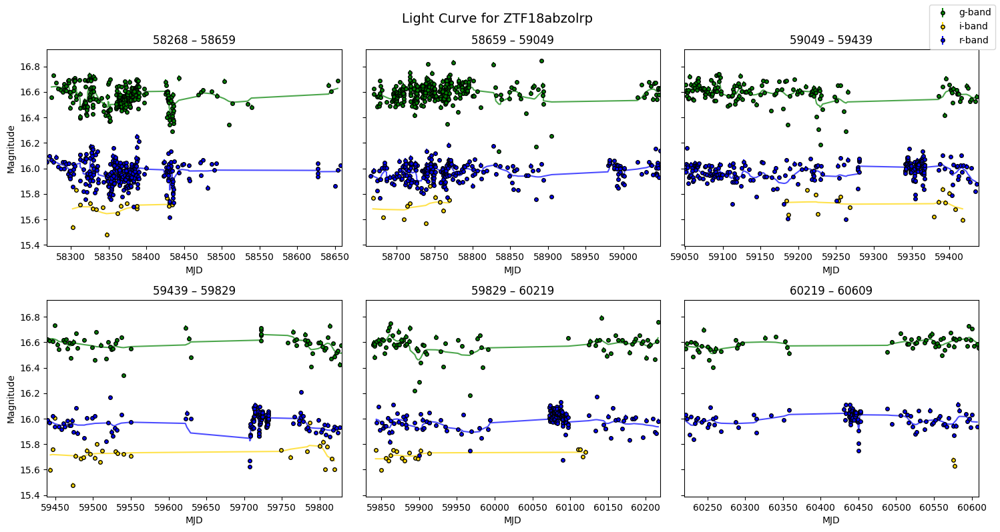

top_class: [np.str_('RSG*_Candidate') np.str_('RedSG_Candidate') np.str_('Unknown')
 np.str_('V*')]
cat_id: ['Fan2010_944']
tns: ['Unknown']


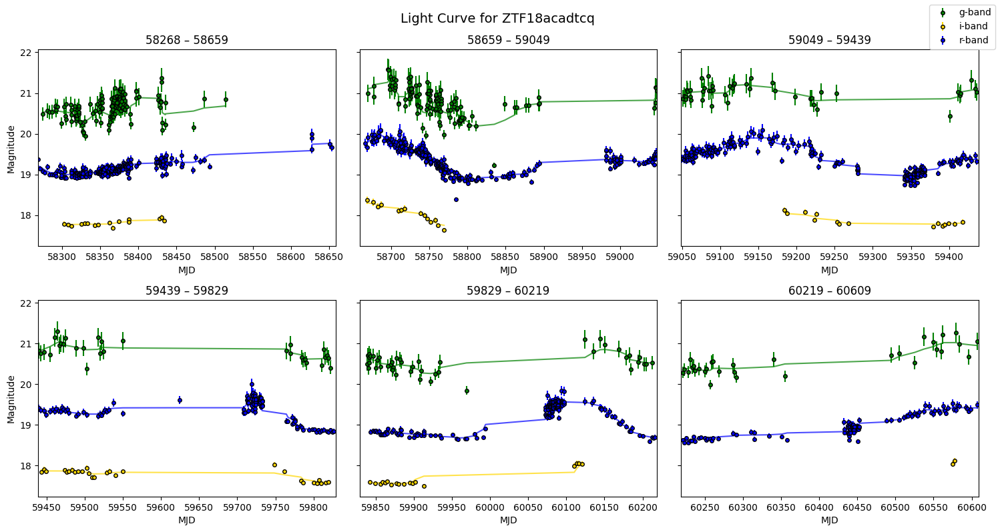

top_class: [np.str_('GlCl')]
cat_id: ['Fan2010_252' 'PHAT_johnson12_551']
tns: ['Unknown']


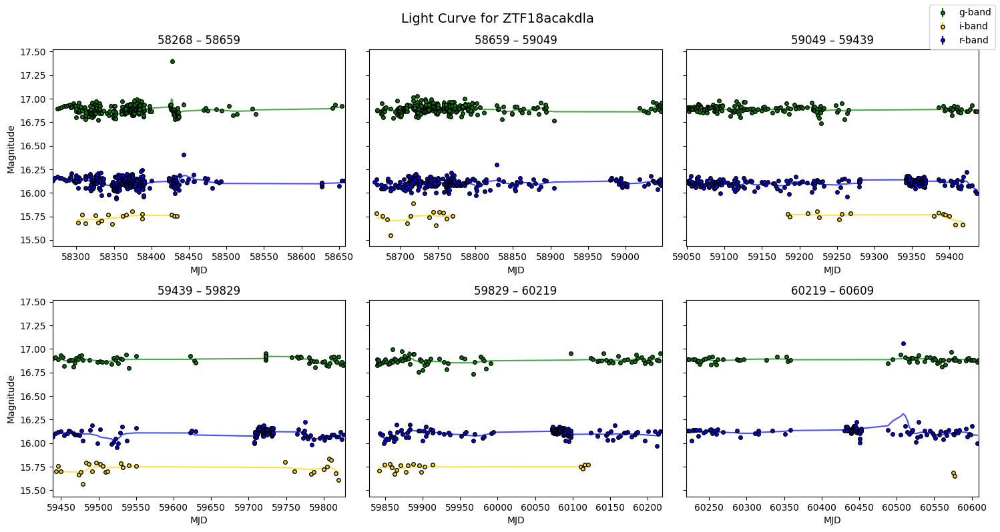

top_class: [np.str_('EB*') np.str_('EclBin') np.str_('Unknown')]
cat_id: ['beccari2013_146']
tns: ['Unknown']


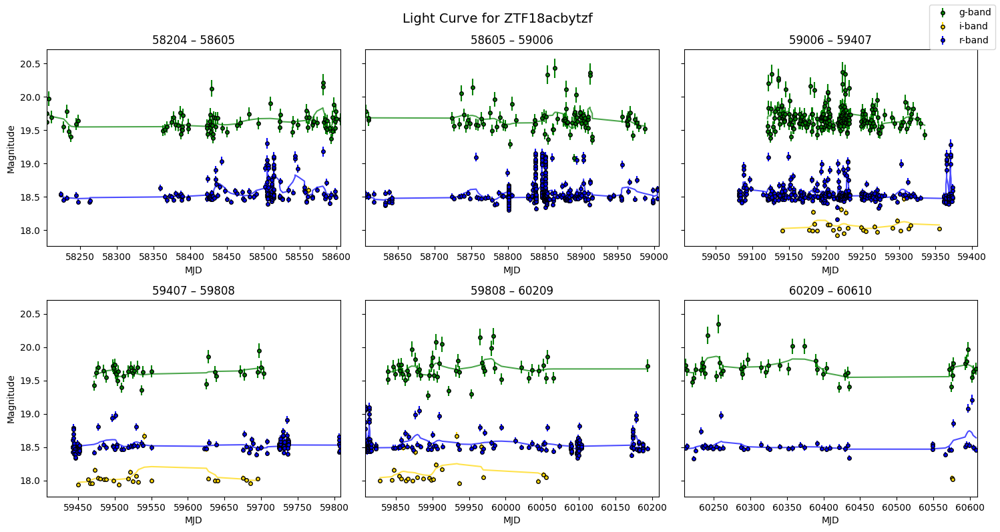

top_class: [np.str_('Cepheid') np.str_('Type2Cep')]
cat_id: ['beccari2013_3848']
tns: ['Unknown']


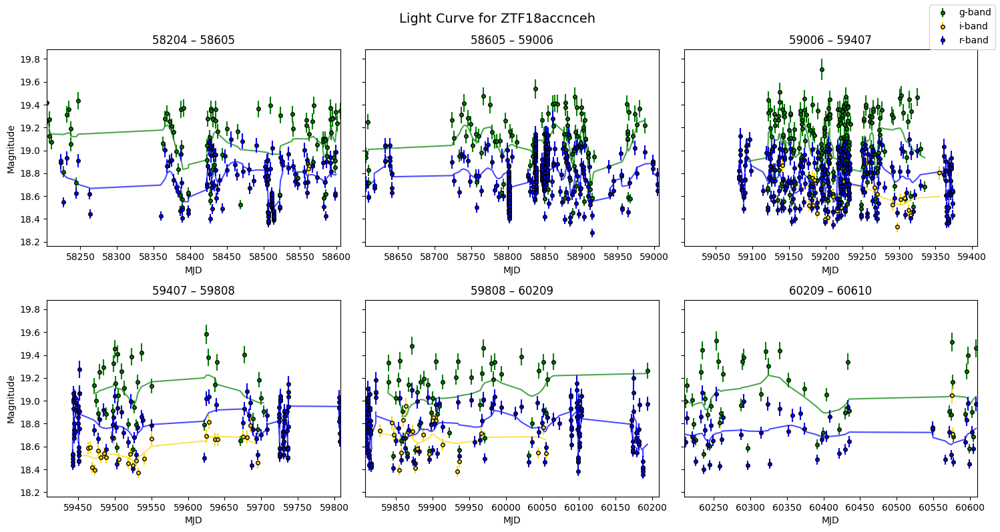

top_class: [np.str_('RRLyr')]
cat_id: ['beccari2013_2630']
tns: ['Unknown']


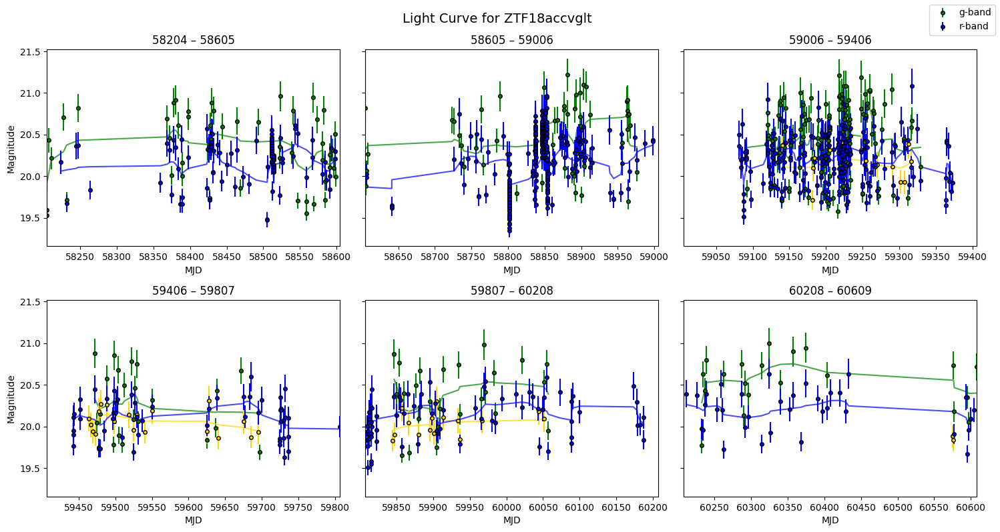

top_class: [np.str_('RRLyr') np.str_('RRLyrae')]
cat_id: ['beccari2013_1135']
tns: ['Unknown']


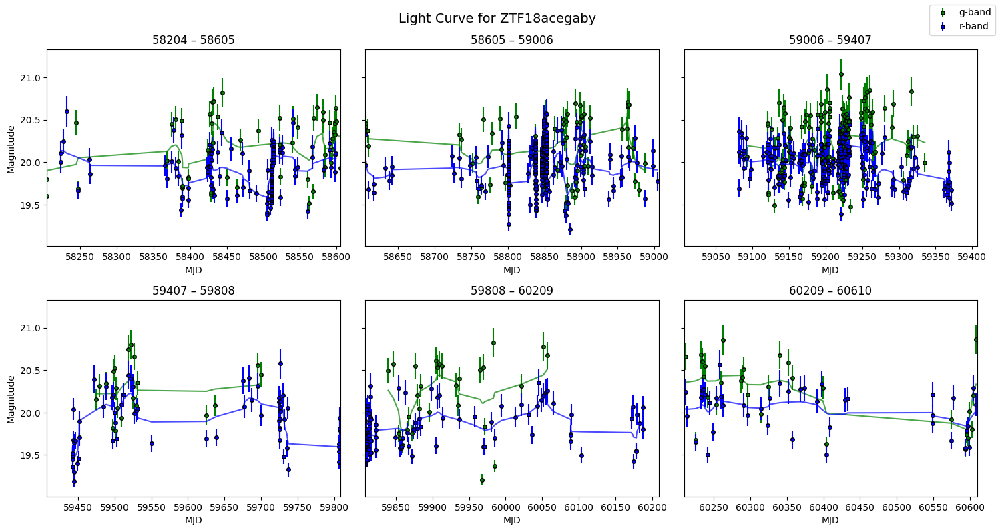

top_class: [np.str_('GlCl')]
cat_id: ['Fan2010_226' 'Peacock_252']
tns: ['Unknown']


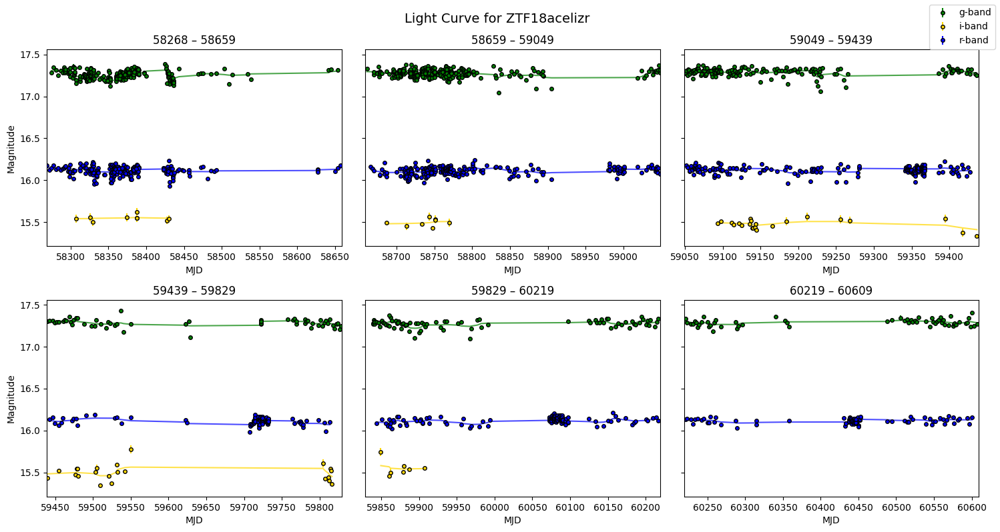

top_class: [np.str_('RRLyr')]
cat_id: ['beccari2013_1444']
tns: ['Unknown']


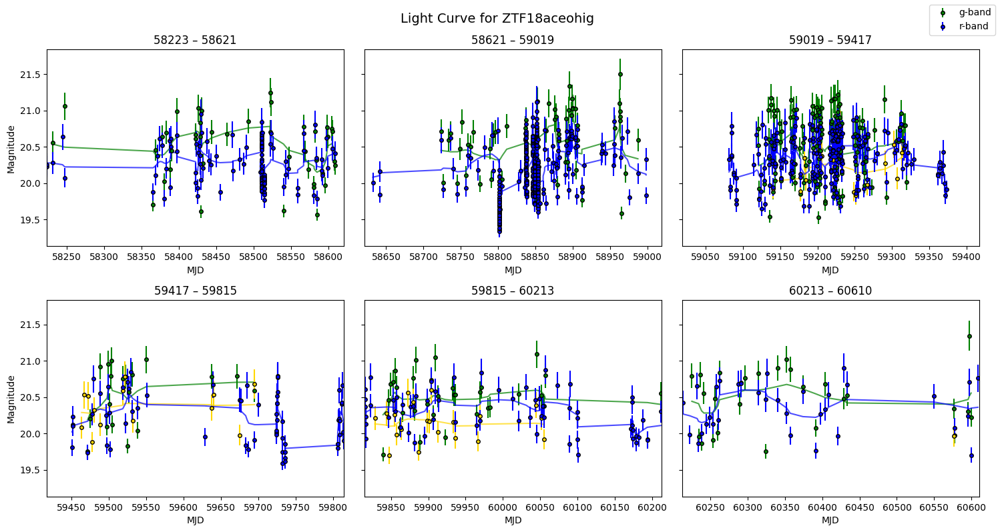

top_class: [np.str_('RSG*_Candidate') np.str_('RedSG_Candidate') np.str_('Star')]
cat_id: ['Peacock_1476']
tns: ['Unknown']


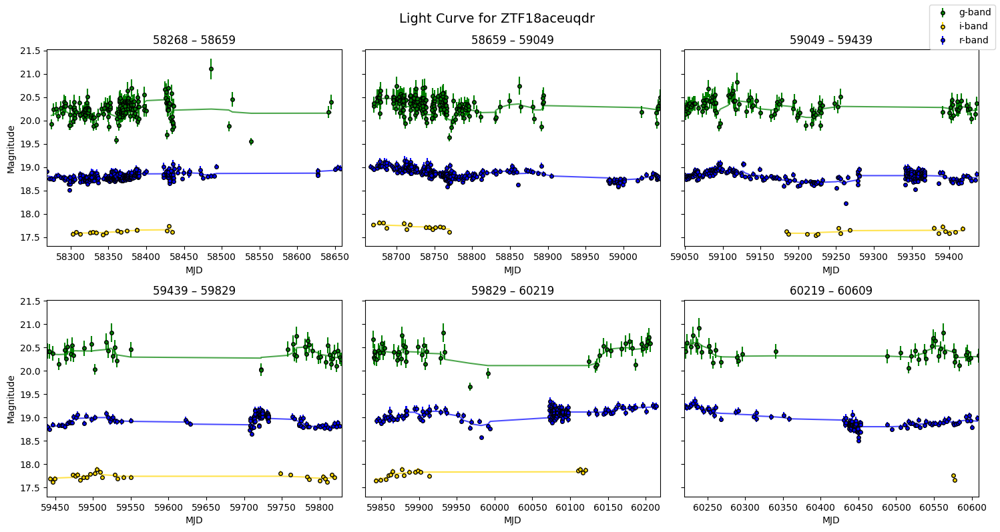

top_class: [np.str_('RRLyr')]
cat_id: ['beccari2013_1456']
tns: ['Unknown']


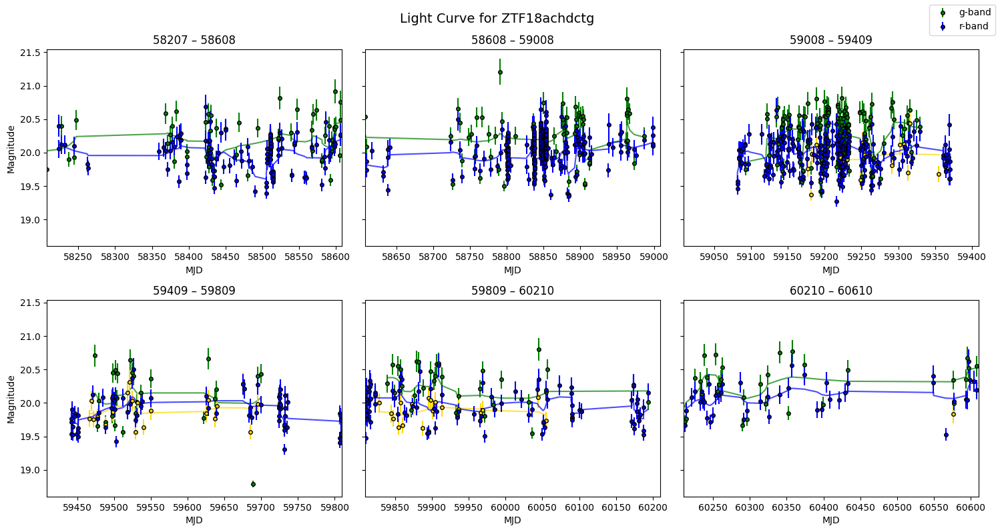

top_class: [np.str_('GlCl')]
cat_id: ['Fan2010_132' 'PHAT_johnson12_202' 'Peacock_161']
tns: ['Unknown']


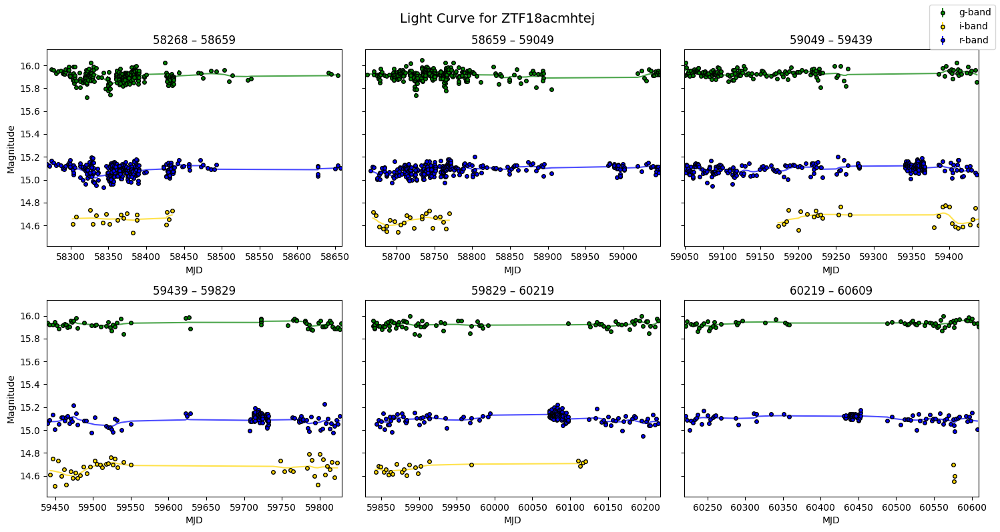

top_class: [np.str_('BSG*_Candidate') np.str_('Candidate_BSG*') np.str_('GlCl?')
 np.str_('GlCl?_Candidate')]
cat_id: ['Ma_291']
tns: ['Unknown']


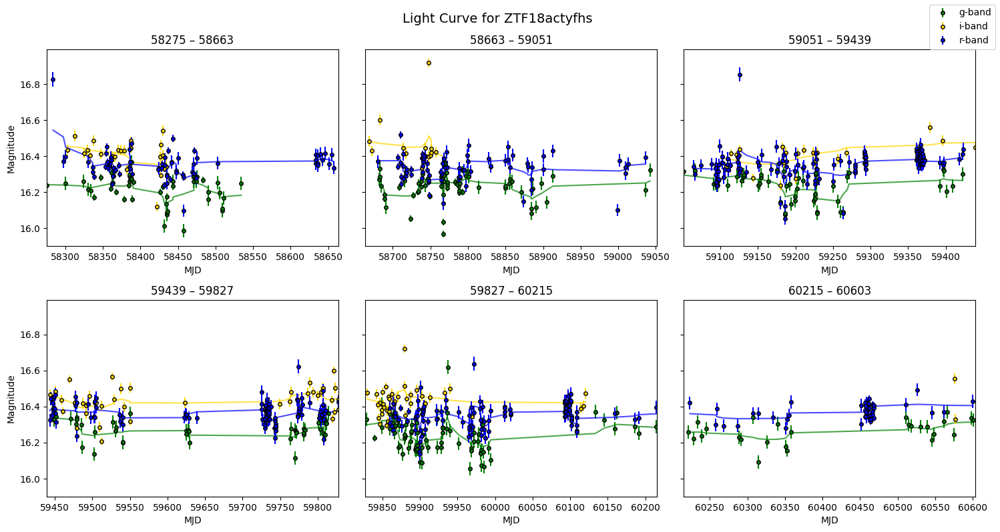

top_class: [np.str_('BClG') np.str_('Compact_Gr_G') np.str_('QSO') np.str_('Unknown')]
cat_id: ['NGC4382_sources_2767']
tns: ['Unknown']


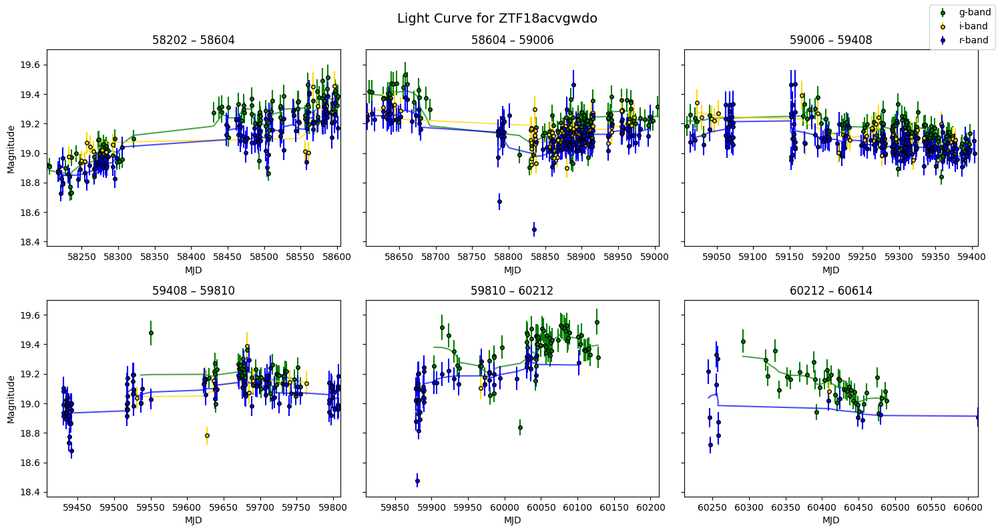

top_class: [np.str_('GlCl')]
cat_id: ['Ma_232']
tns: ['Unknown']


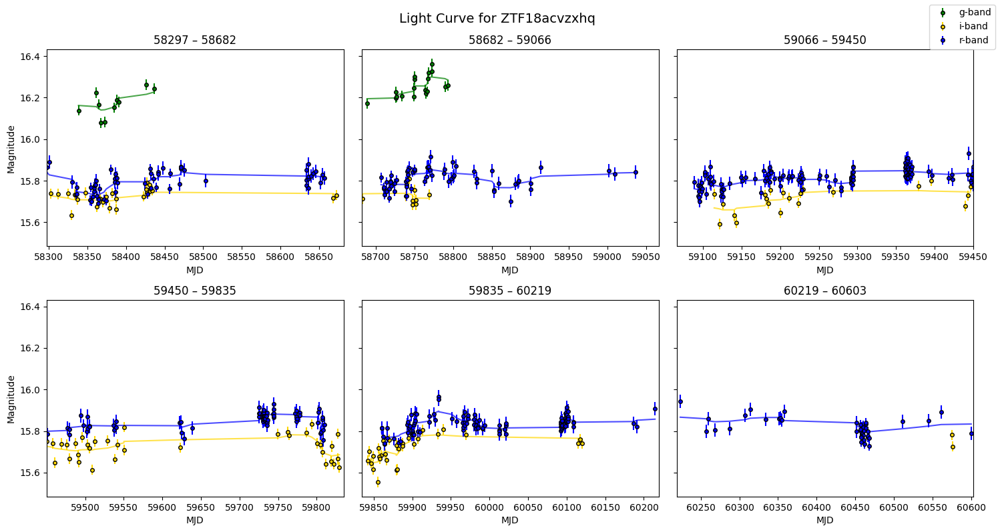

top_class: [np.str_('BSG*_Candidate') np.str_('BlueSG_Candidate')
 np.str_('Candidate_BSG*') np.str_('GlCl')]
cat_id: ['Ma_348']
tns: ['Unknown']


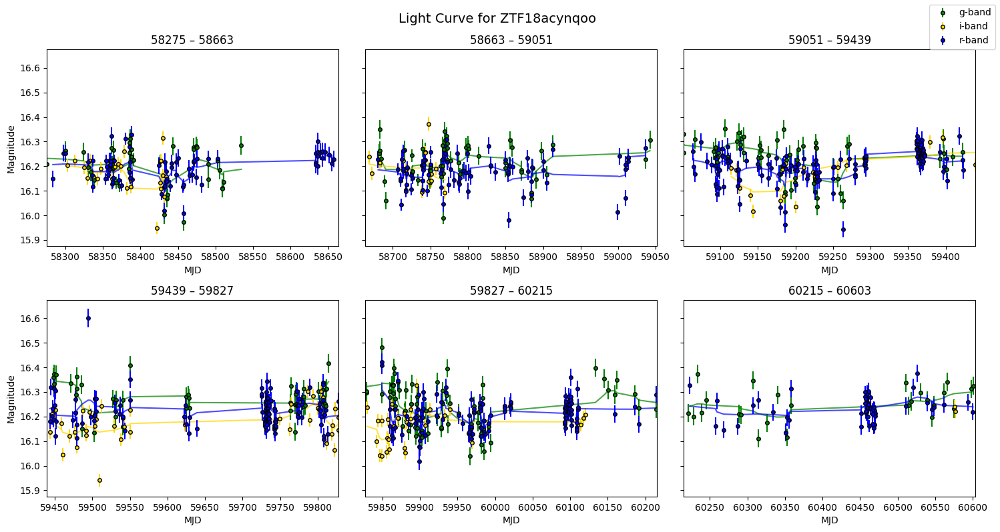

top_class: [np.str_('GlCl')]
cat_id: ['Ma_151']
tns: ['Unknown']


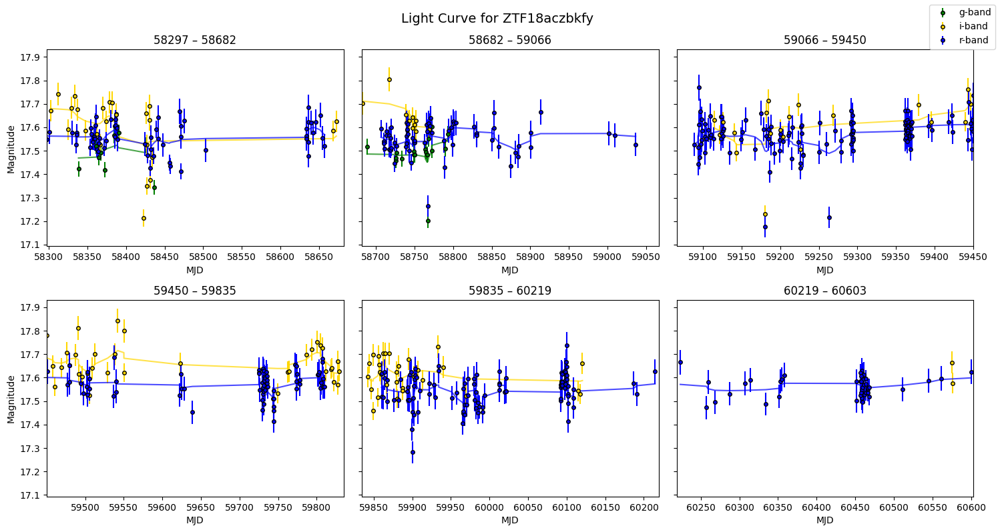

top_class: [np.str_('QSO') np.str_('RRLyr') np.str_('Unknown')]
cat_id: ['NGC5846_sources_365']
tns: ['Unknown']


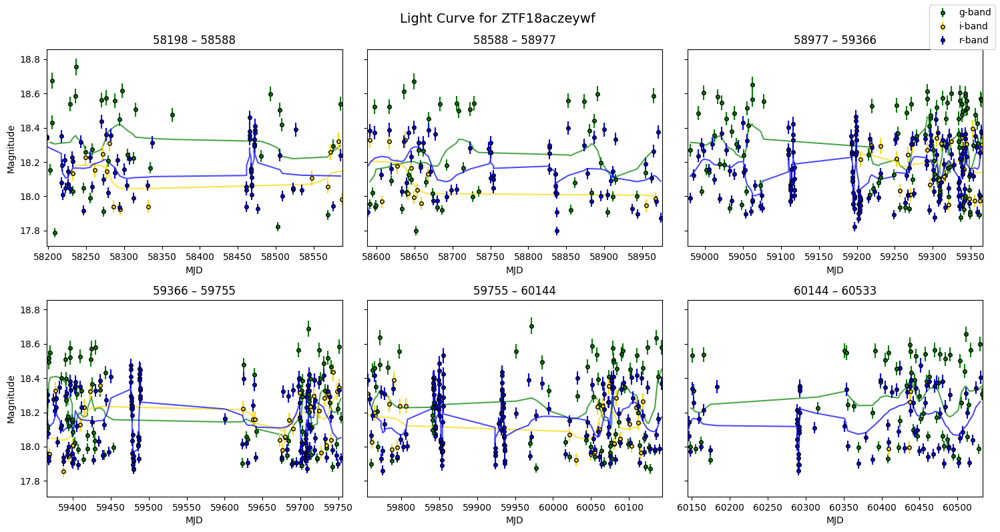

top_class: [np.str_('BlueSG*')]
cat_id: ['Ma_132']
tns: ['Unknown']


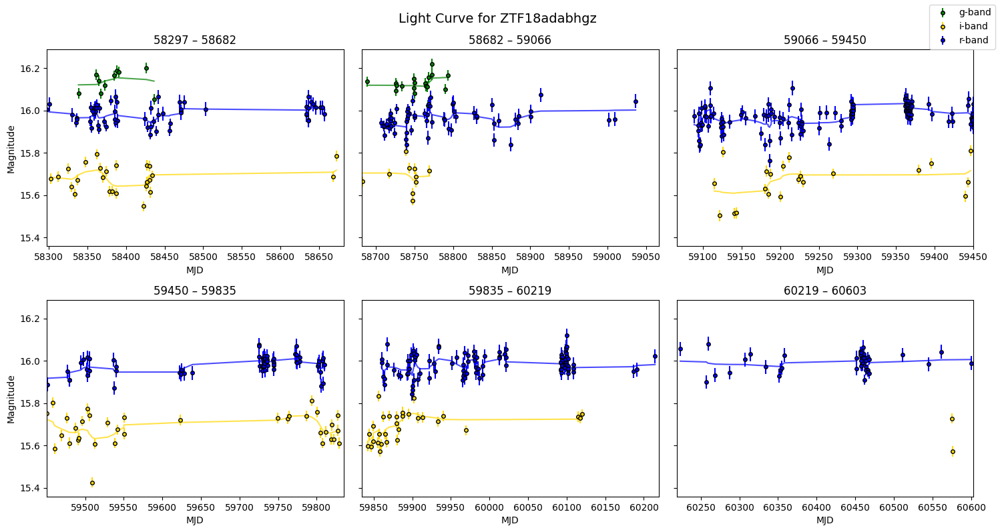

top_class: [np.str_('Seyfert_2')]
cat_id: ['Seth08_47']
tns: ['Unknown']


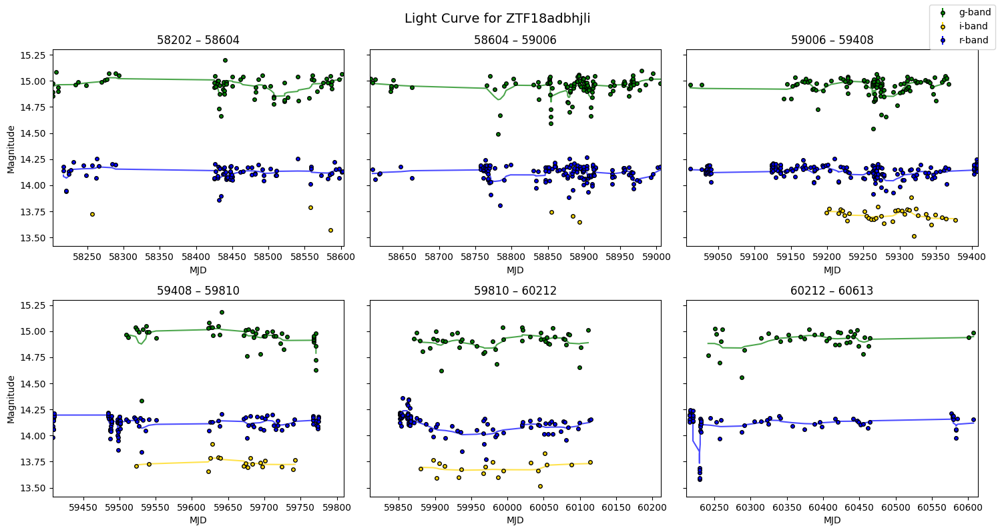

top_class: [np.str_('Cepheid') np.str_('Type2Cep') np.str_('Unknown')]
cat_id: ['beccari2013_3848']
tns: ['Unknown']


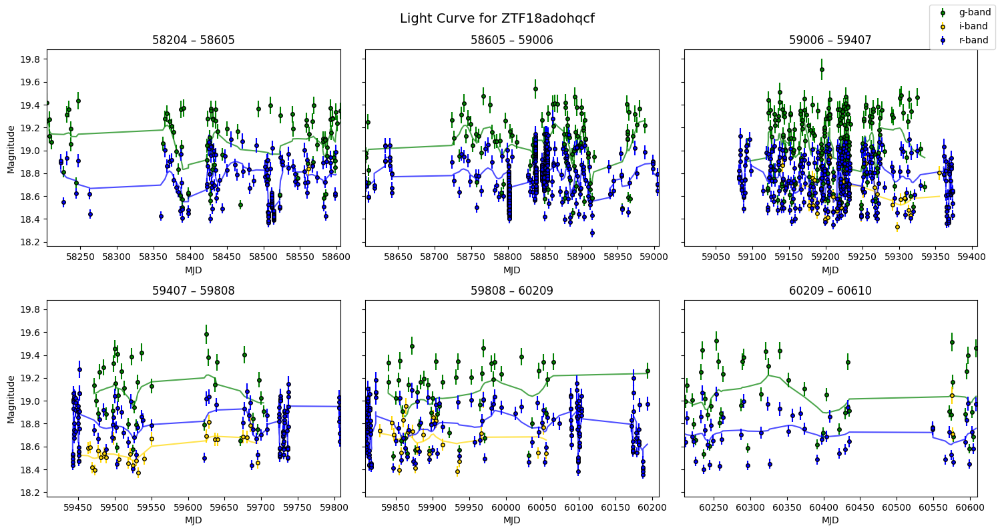

top_class: [np.str_('QSO')]
cat_id: ['NGC5866_sources_904']
tns: ['Unknown']


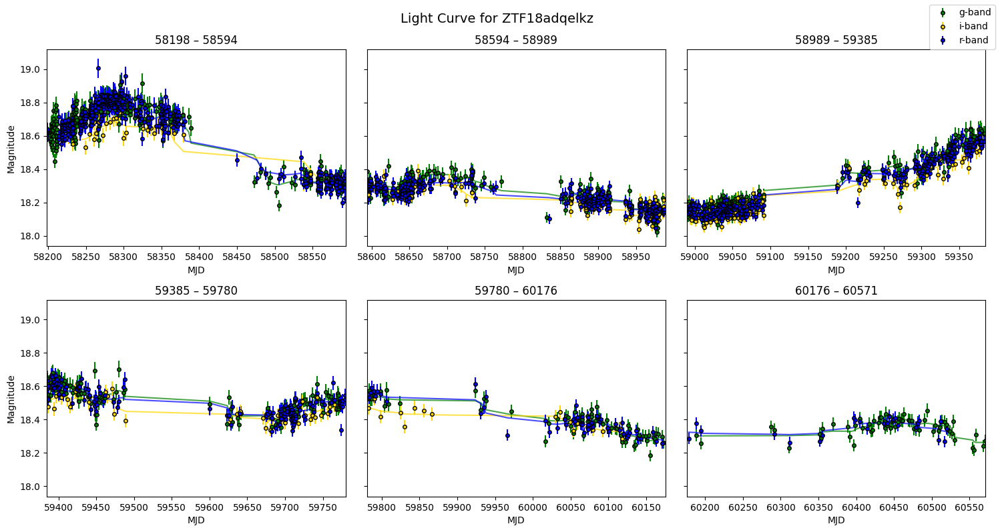

top_class: [np.str_('Cl*') np.str_('RSG*_Candidate') np.str_('RedSG_Candidate')
 np.str_('Unknown')]
cat_id: ['PHAT2_johnson15_2668']
tns: ['Unknown']


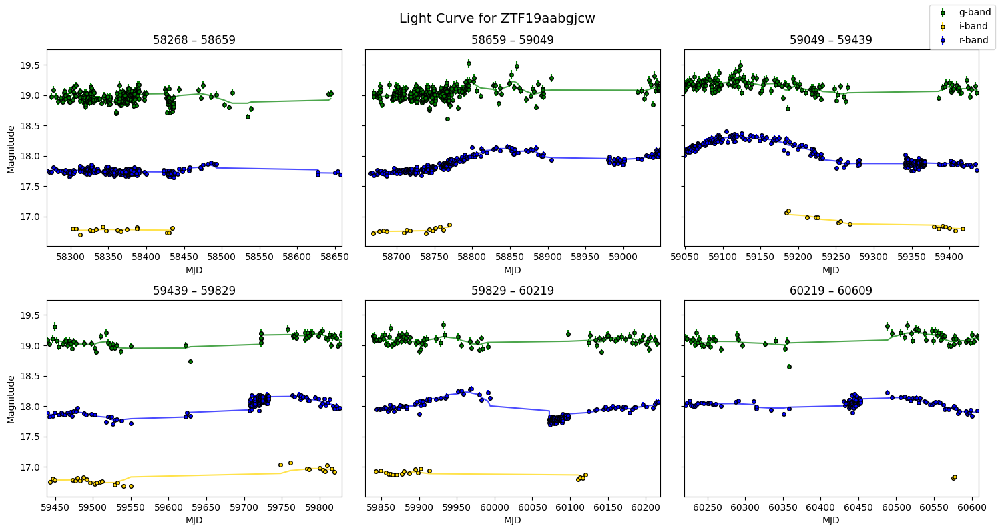

top_class: [np.str_('RRLyr') np.str_('RRLyrae')]
cat_id: ['beccari2013_6546']
tns: ['Unknown']


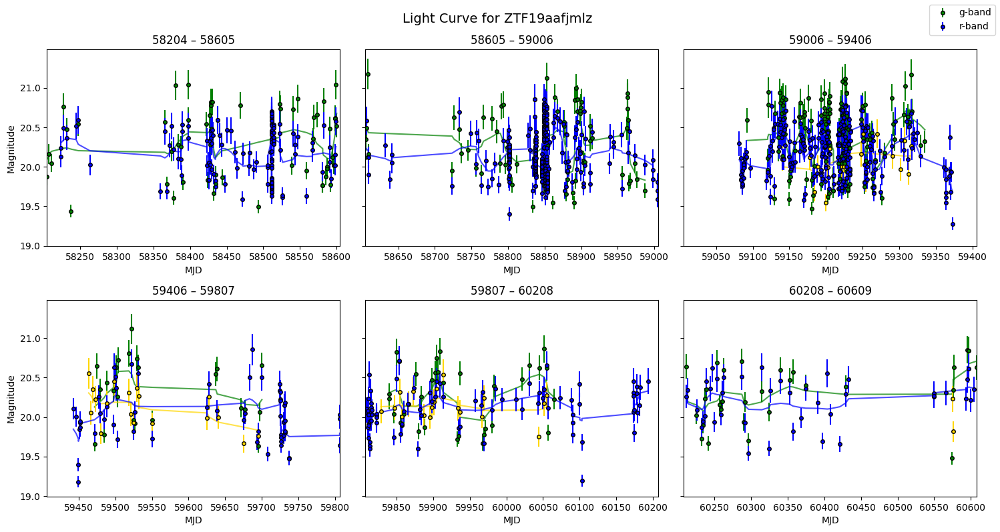

top_class: [np.str_('RRLyr')]
cat_id: ['beccari2013_1774']
tns: ['Unknown']


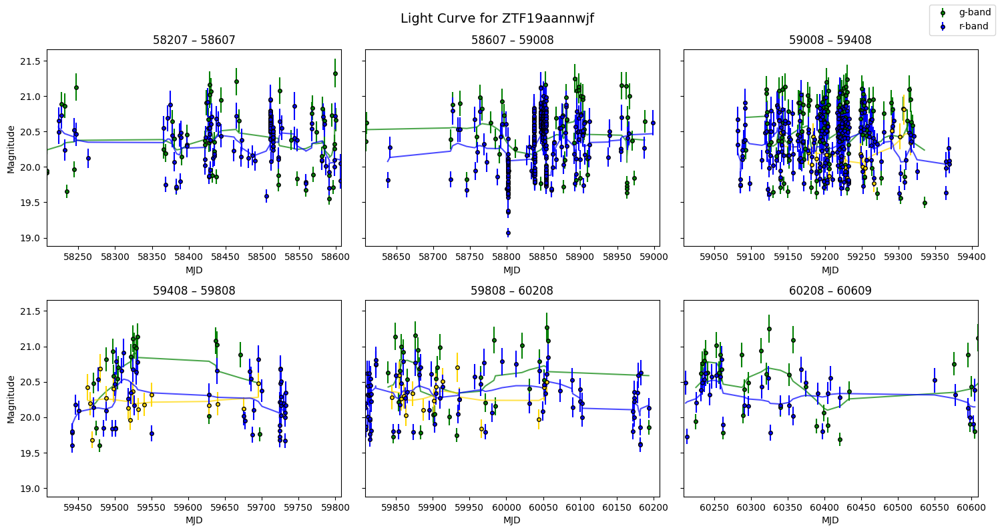

top_class: [np.str_('RRLyr')]
cat_id: ['beccari2013_2997']
tns: ['Unknown']


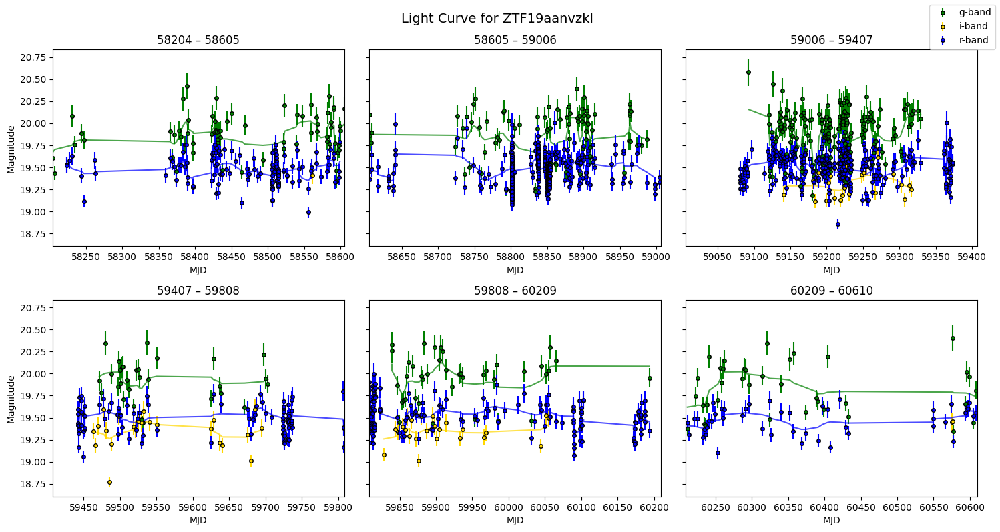

top_class: [np.str_('GlCl') np.str_('LP*_Candidate')]
cat_id: ['Ma_121']
tns: ['Unknown']


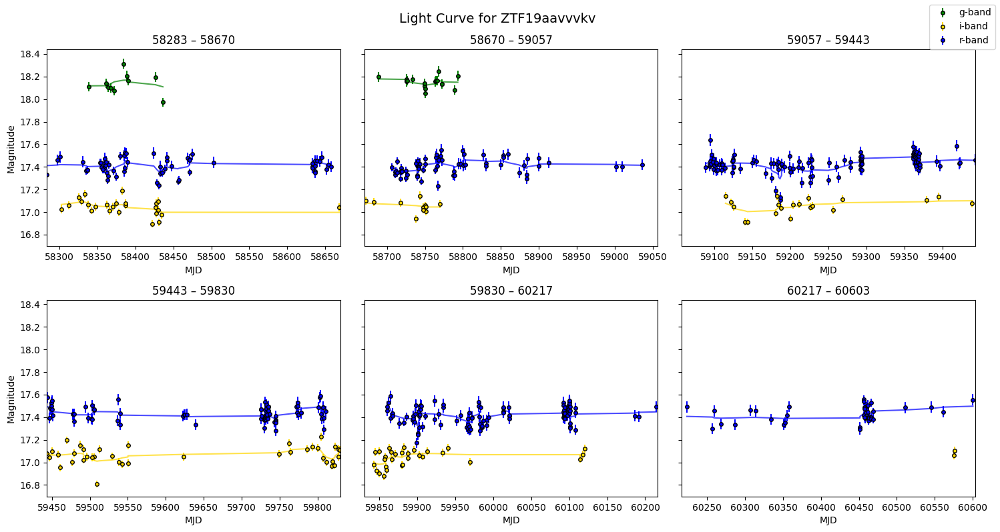

top_class: [np.str_('Star')]
cat_id: ['Ma_172']
tns: ['Unknown']


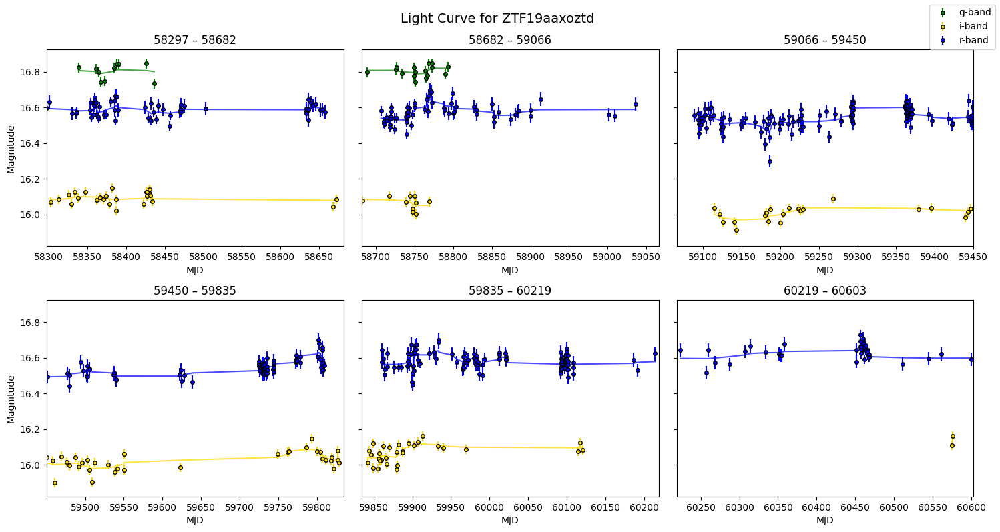

top_class: [np.str_('GlCl') np.str_('HII') np.str_('X')]
cat_id: ['Ma_245']
tns: ['Unknown']


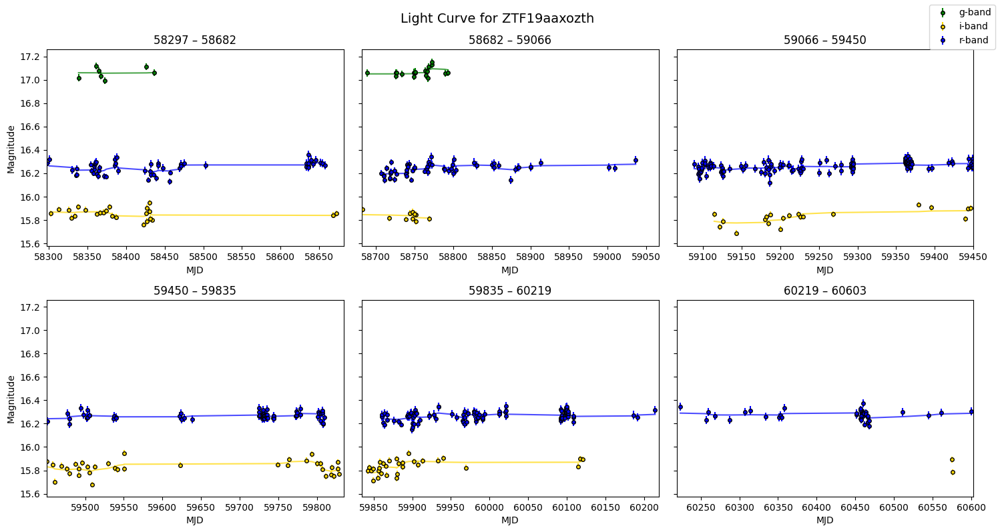

top_class: [np.str_('Em*') np.str_('Radio')]
cat_id: ['Ma_271']
tns: ['Unknown']


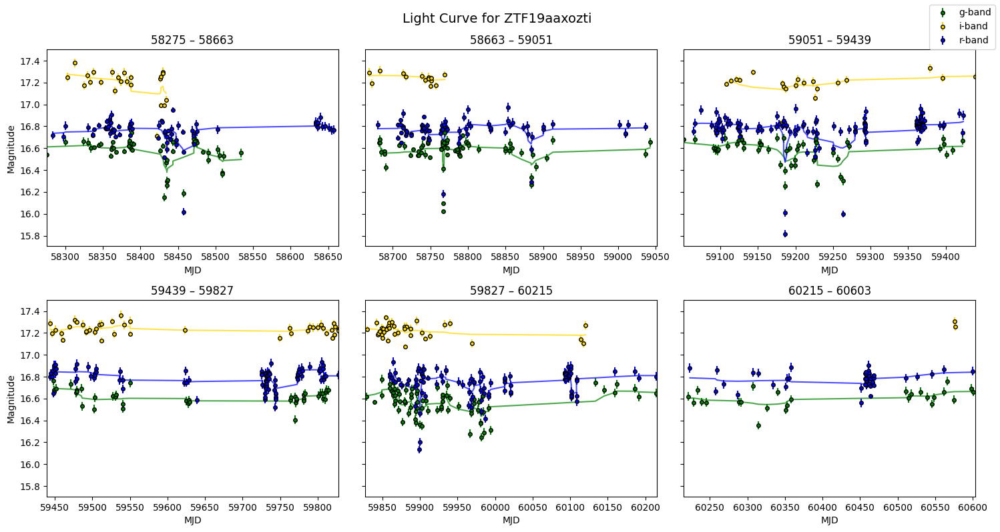

top_class: [np.str_('GlCl') np.str_('V*')]
cat_id: ['Ma_145']
tns: ['Unknown']


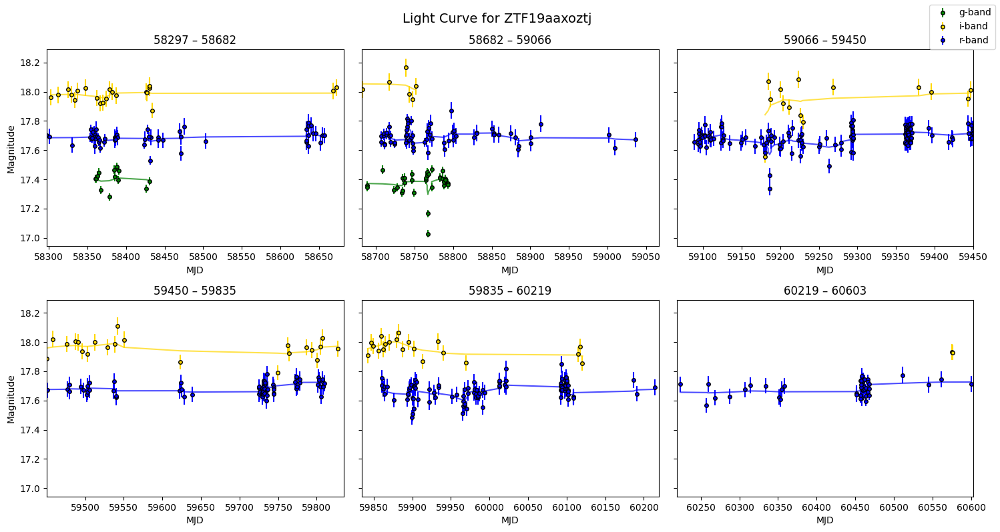

top_class: [np.str_('GlCl')]
cat_id: ['Ma_118']
tns: ['Unknown']


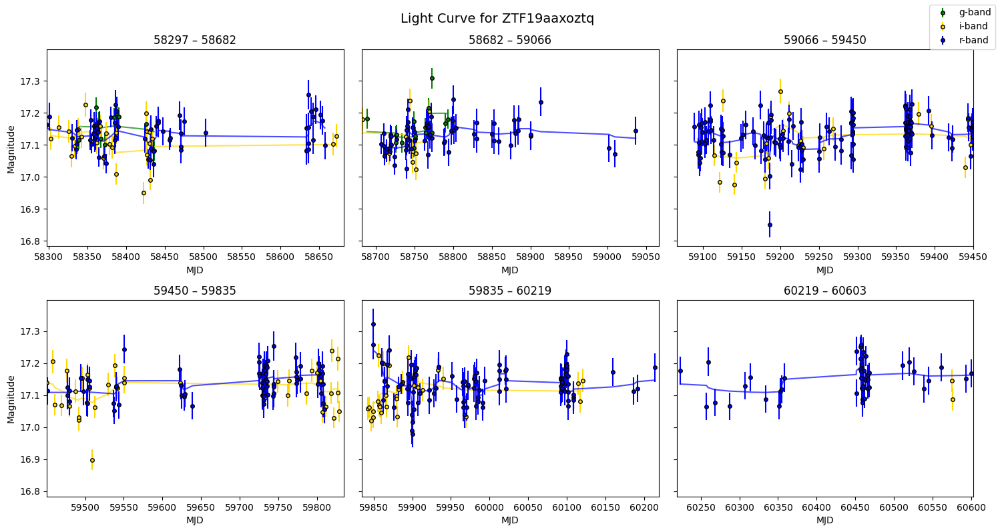

top_class: [np.str_('V*')]
cat_id: ['Ma_196']
tns: ['Unknown']


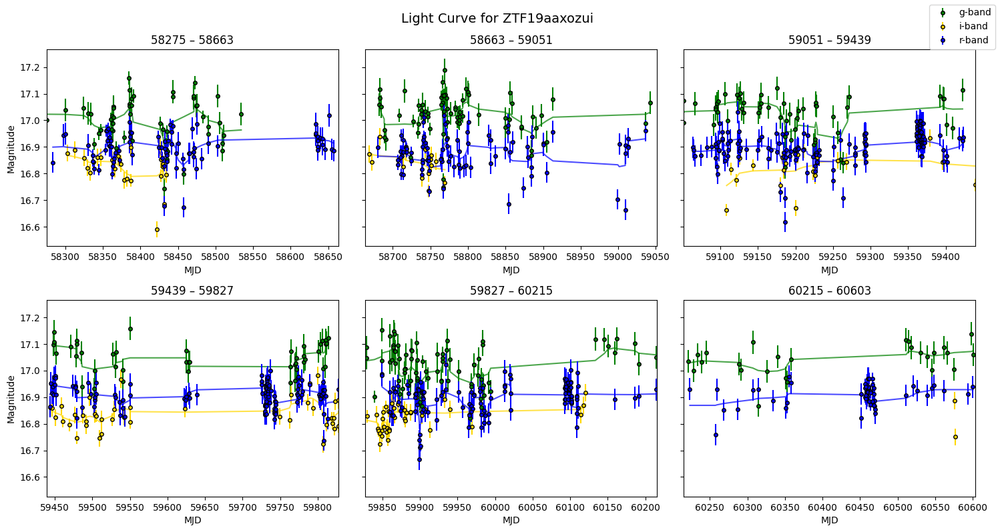

top_class: [np.str_('QSO')]
cat_id: ['NGC7339_sources_291']
tns: ['Unknown']


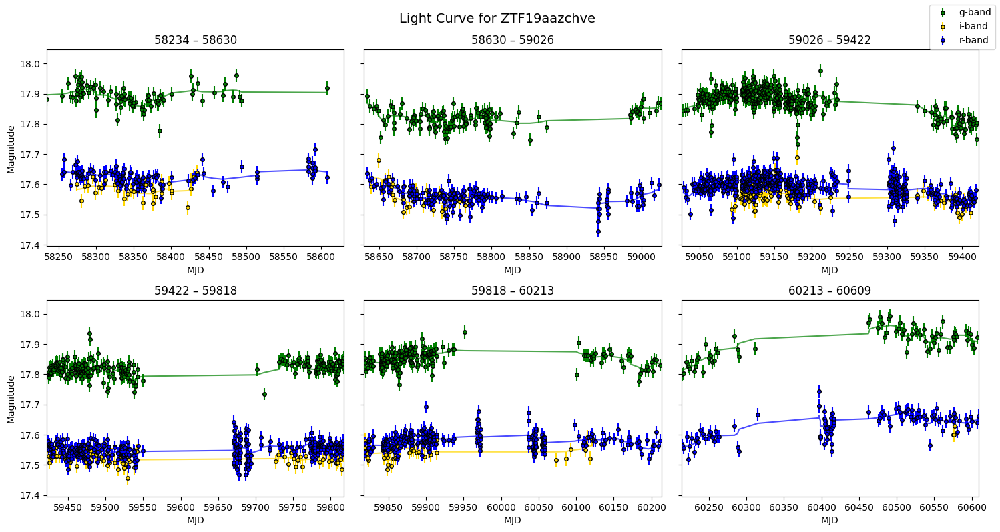

top_class: [np.str_('Candidate_RSG*') np.str_('Cl*') np.str_('Pec*')
 np.str_('RSG*_Candidate') np.str_('RedSG') np.str_('RedSG*')
 np.str_('Star') np.str_('Unknown')]
cat_id: ['Ma_247']
tns: ['Unknown']


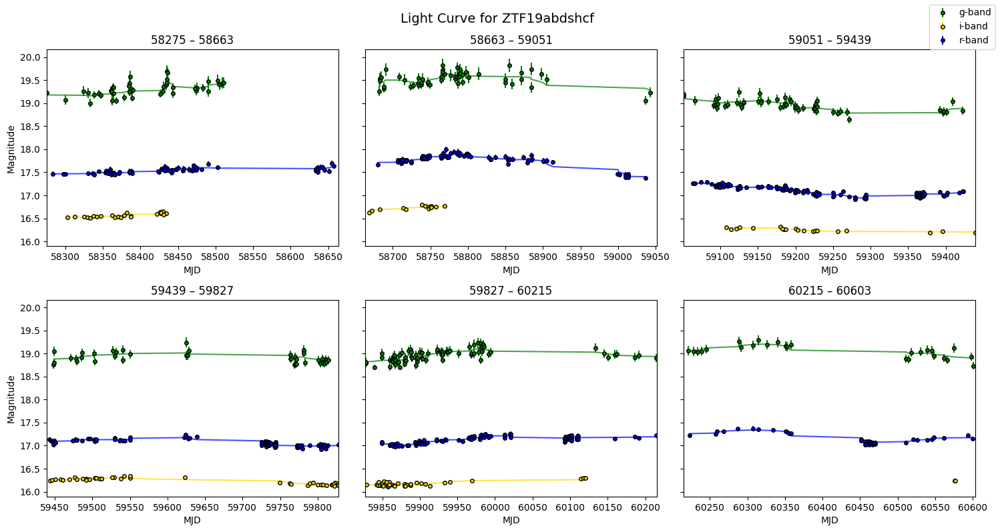

top_class: [np.str_('GlCl')]
cat_id: ['Ma_354']
tns: ['Unknown']


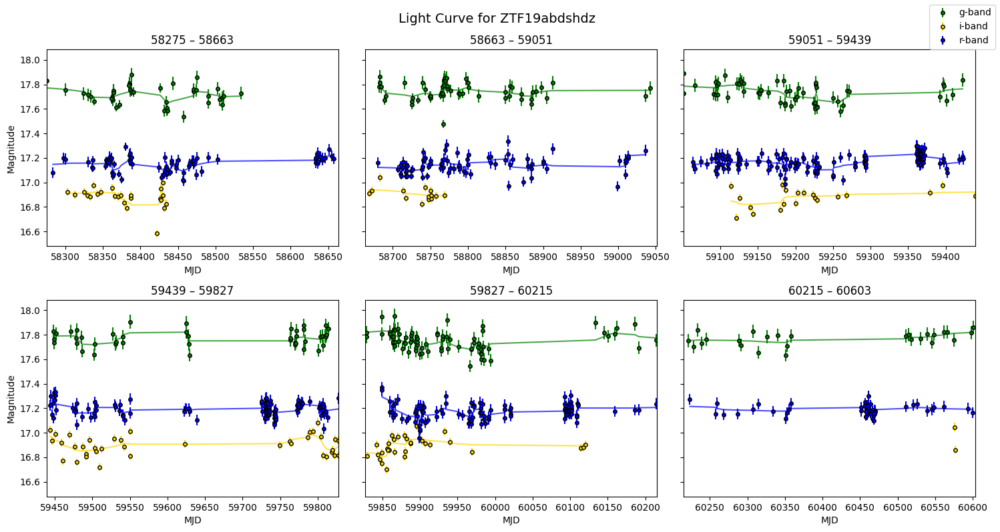

top_class: [np.str_('AGN') np.str_('Unknown')]
cat_id: ['Fan2010_432' 'Peacock_1168']
tns: ['Unknown']


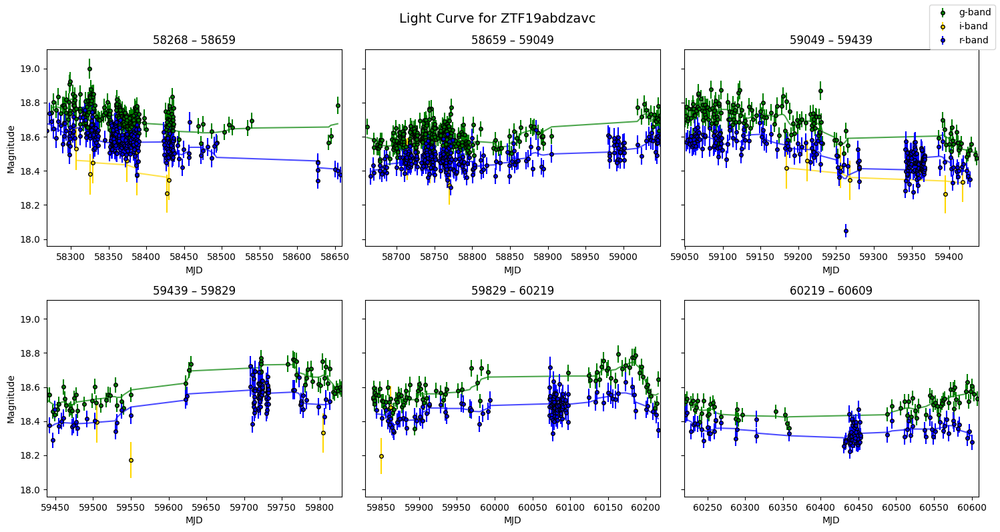

top_class: [np.str_('BlueSG*')]
cat_id: ['Ma_281']
tns: ['Unknown']


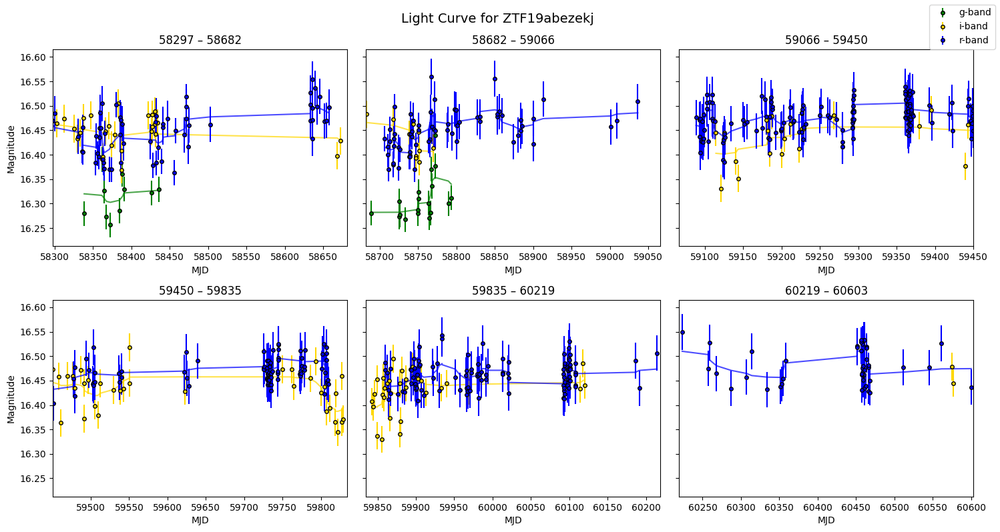

top_class: [np.str_('QSO')]
cat_id: ['Fan2010_823' 'Peacock_1576']
tns: ['Unknown']


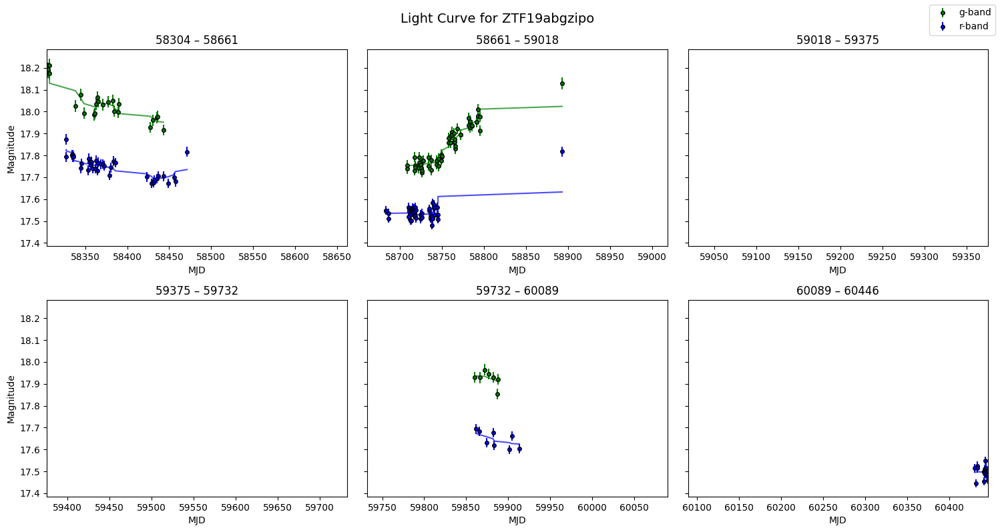

top_class: [np.str_('GlCl') np.str_('Unknown')]
cat_id: ['Ma_279']
tns: ['Unknown']


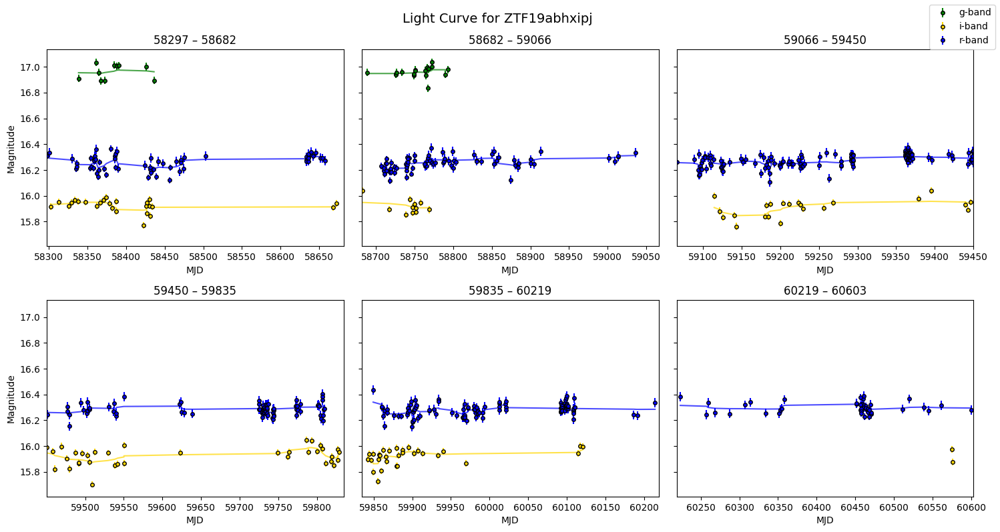

top_class: [np.str_('GlCl') np.str_('Star')]
cat_id: ['Ma_243']
tns: ['Unknown']


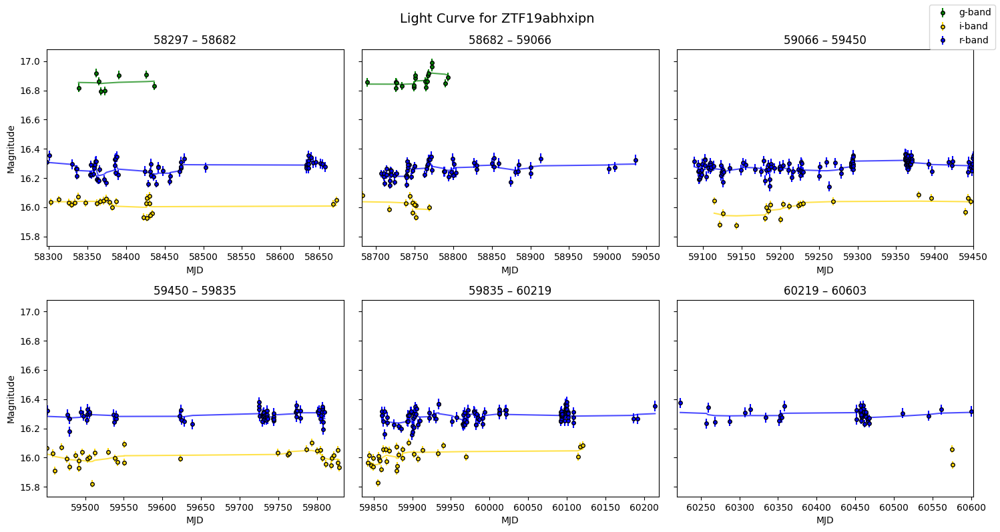

top_class: [np.str_('GlCl') np.str_('GlobCluster')]
cat_id: ['Ma_249']
tns: ['Unknown']


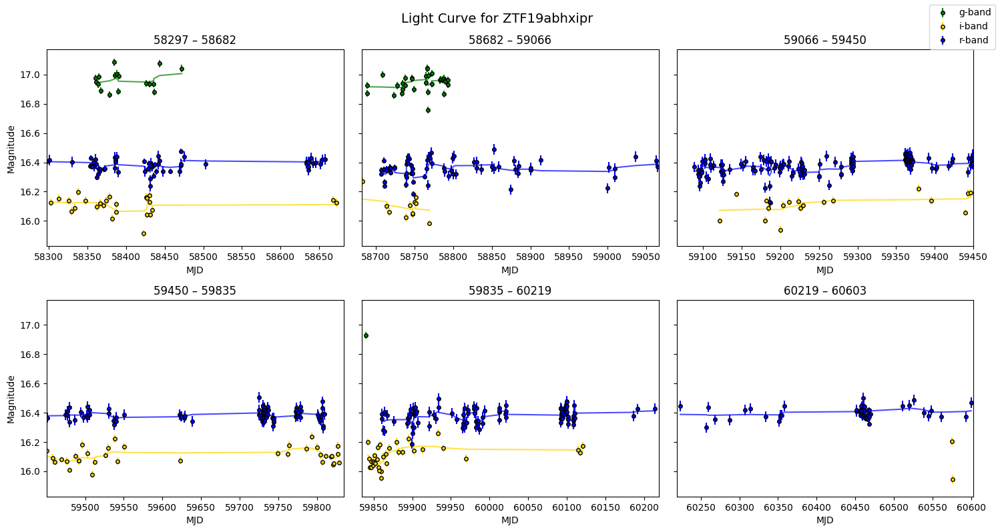

top_class: [np.str_('HII') np.str_('deltaCep')]
cat_id: ['Ma_136']
tns: ['Unknown']


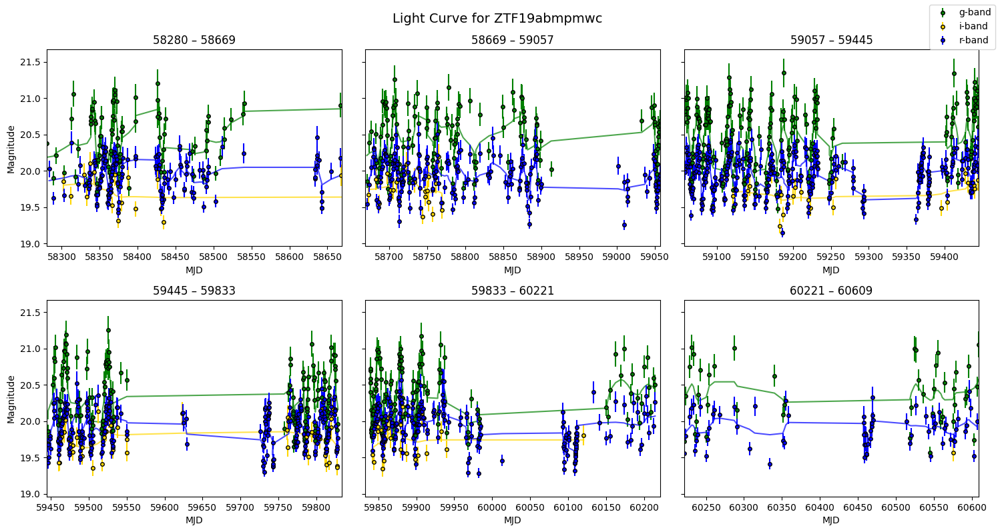

top_class: [np.str_('GlCl')]
cat_id: ['Fan2010_16' 'Peacock_33' 'Vansevicius09_197']
tns: ['Unknown']


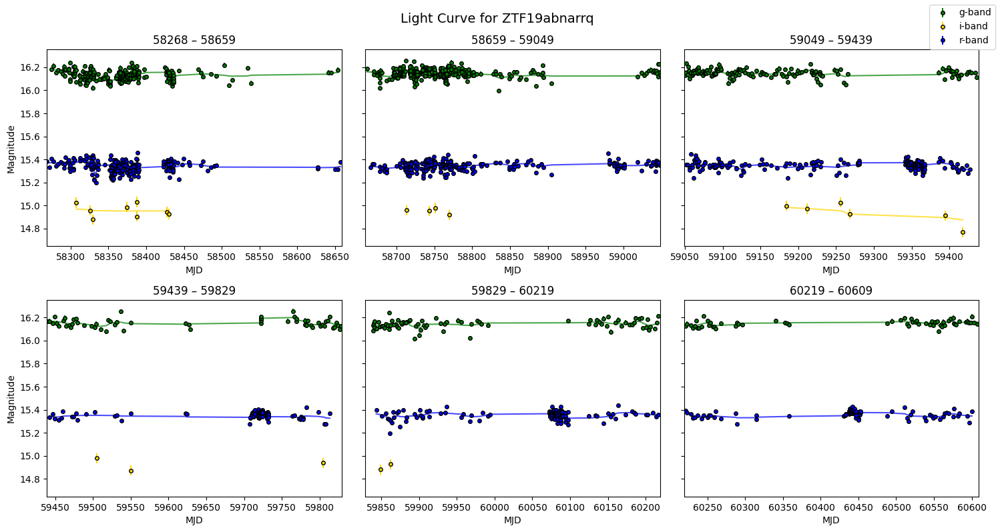

top_class: [np.str_('BSG*_Candidate') np.str_('Cl*') np.str_('Unknown')]
cat_id: ['Ma_369']
tns: ['Unknown']


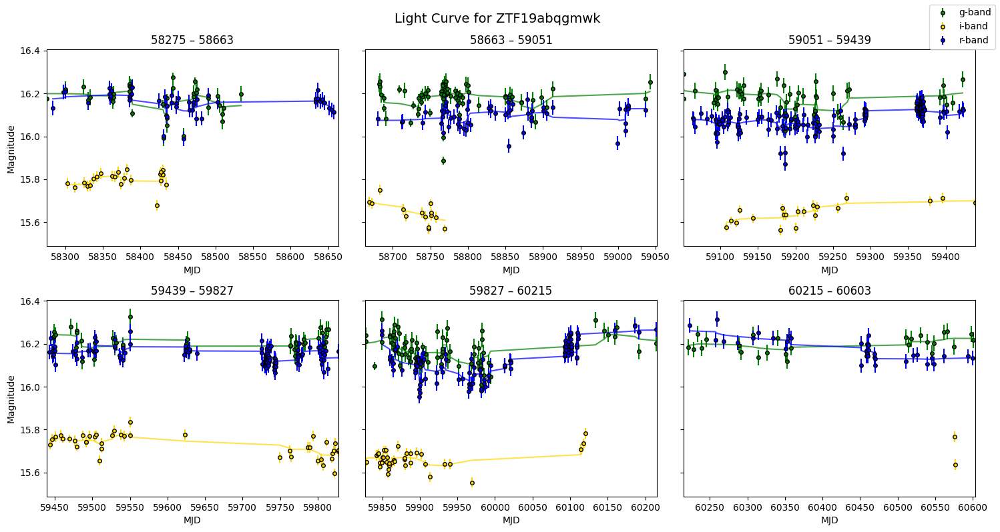

top_class: [np.str_('Unknown') np.str_('V*')]
cat_id: ['Peacock_1492']
tns: ['Unknown']


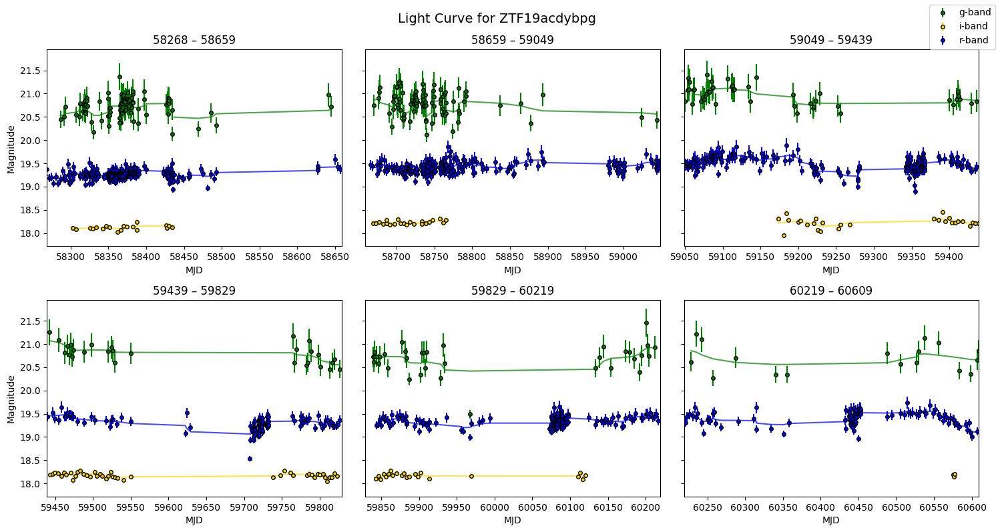

top_class: [np.str_('BSG*_Candidate') np.str_('Candidate_BSG*')
 np.str_('GlCl?_Candidate') np.str_('Mira') np.str_('Unknown')]
cat_id: ['Ma_291']
tns: ['Unknown']


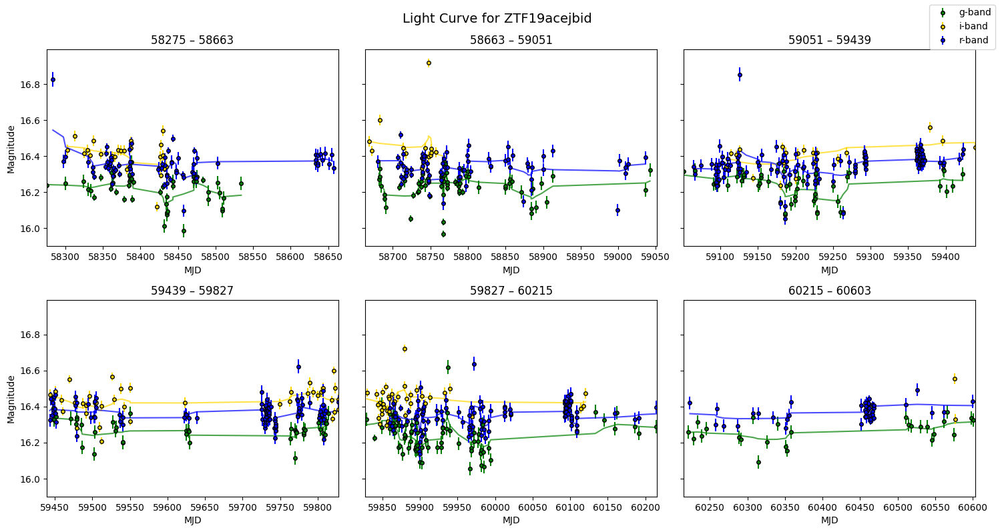

top_class: [np.str_('Star')]
cat_id: ['Peacock_1484']
tns: ['Unknown']


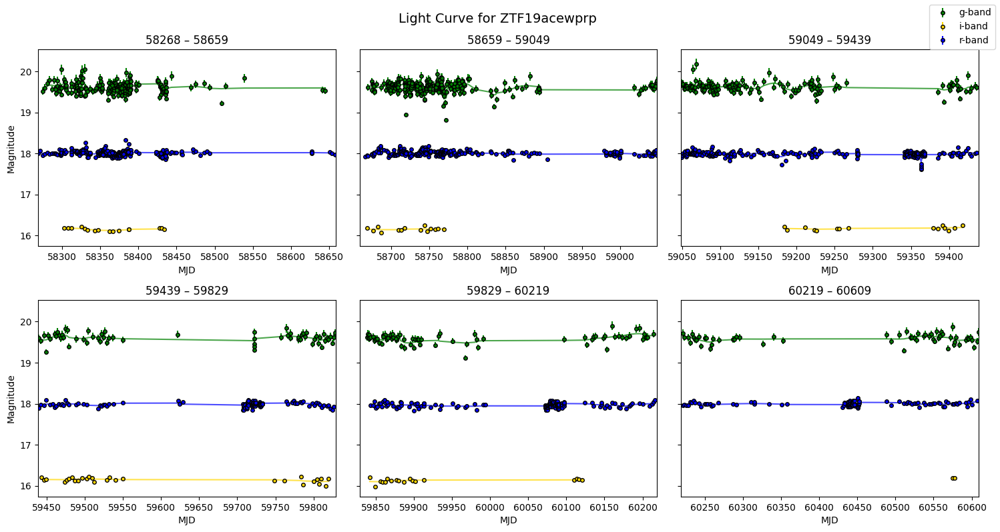

top_class: [np.str_('Star')]
cat_id: ['Peacock_1538']
tns: ['Unknown']


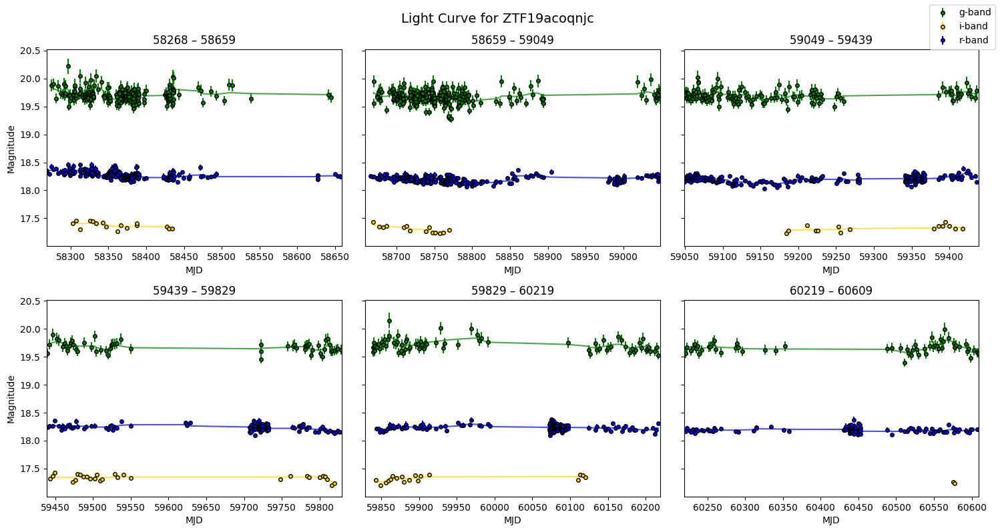

top_class: [np.str_('Cl*') np.str_('Cluster*')]
cat_id: ['Ma_383']
tns: ['Unknown']


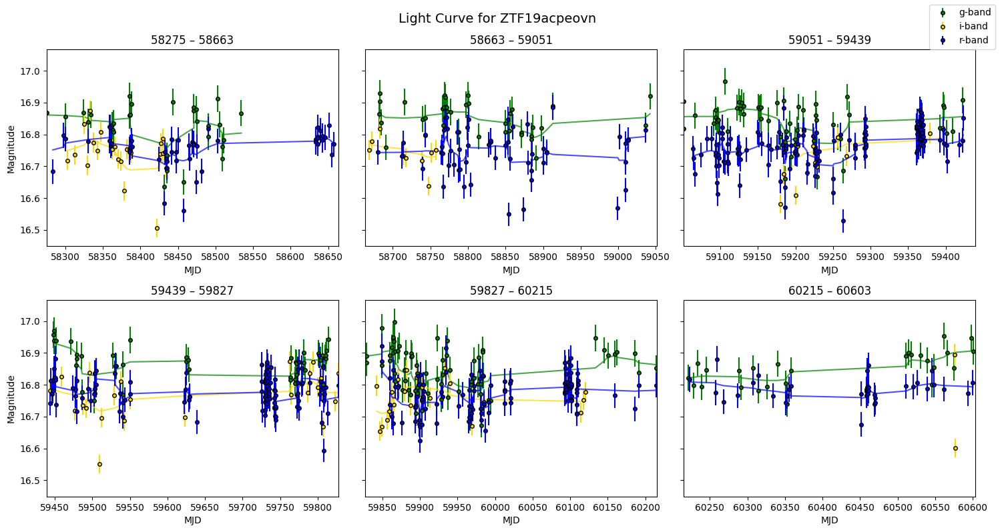

top_class: [np.str_('BSG*_Candidate') np.str_('Candidate_BSG*') np.str_('Cl*')]
cat_id: ['Ma_369']
tns: ['Unknown']


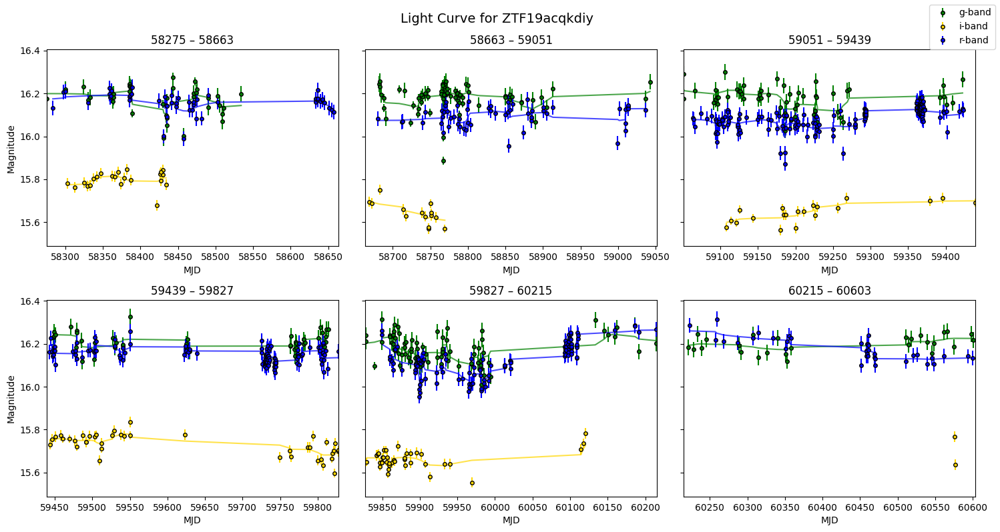

top_class: [np.str_('BLLac') np.str_('Unknown')]
cat_id: ['NGC4382_sources_3223']
tns: ['Unknown']


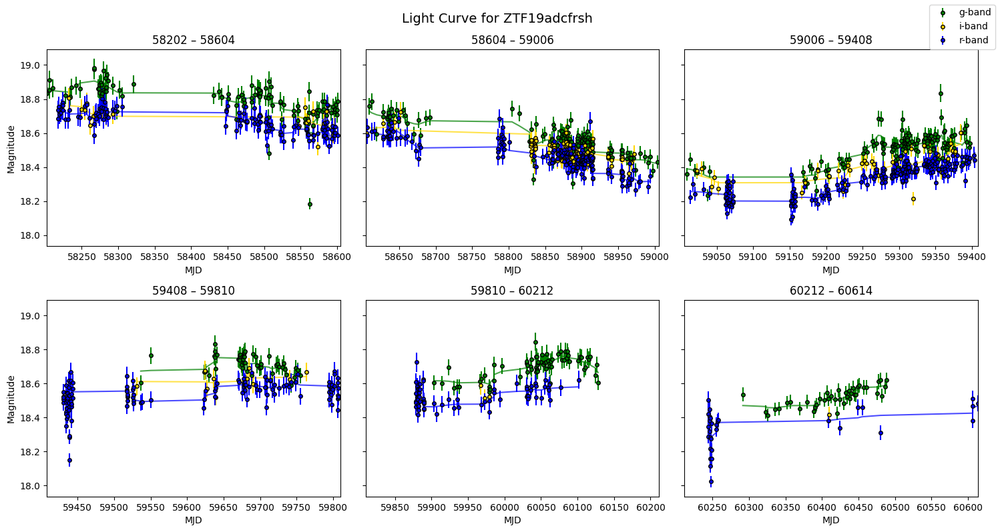

top_class: [np.str_('GinCl') np.str_('QSO') np.str_('X')]
cat_id: ['NGC4382_sources_2677']
tns: ['Unknown']


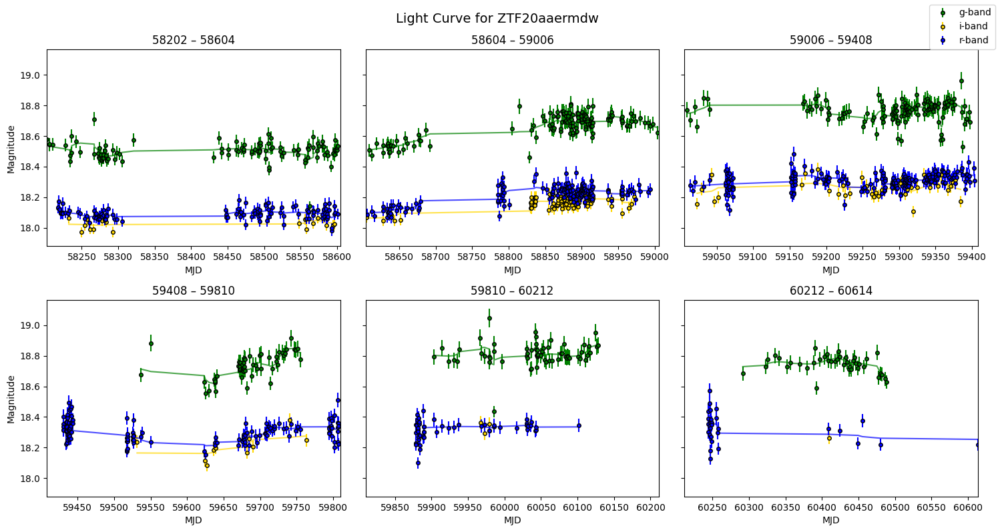

top_class: [np.str_('AGN')]
cat_id: ['Georgiev2014_65' 'Seth08_150']
tns: ['Unknown']


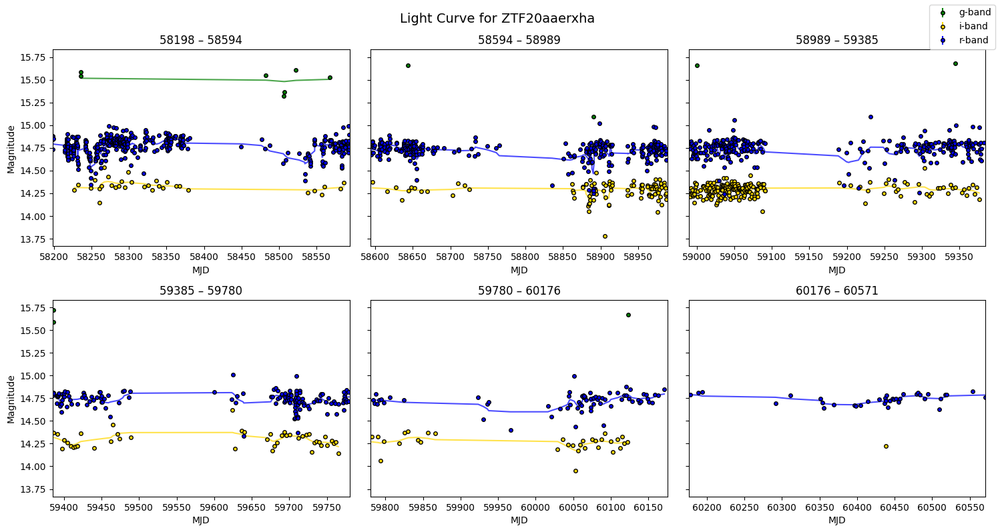

top_class: [np.str_('PN?_Candidate') np.str_('QSO') np.str_('Unknown') np.str_('XB')]
cat_id: ['NGC4621_sources_1673']
tns: ['Unknown']


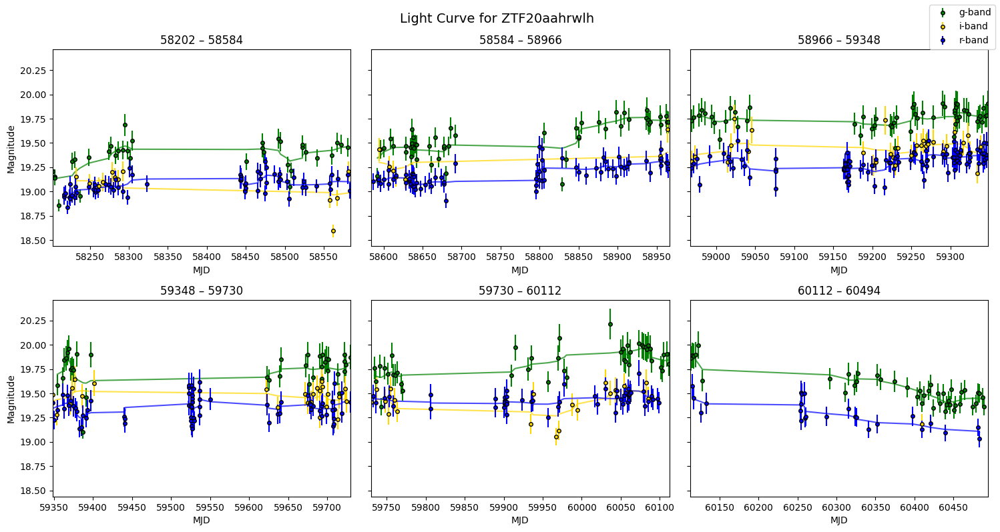

top_class: [np.str_('QSO')]
cat_id: ['NGC4382_sources_653']
tns: ['Unknown']


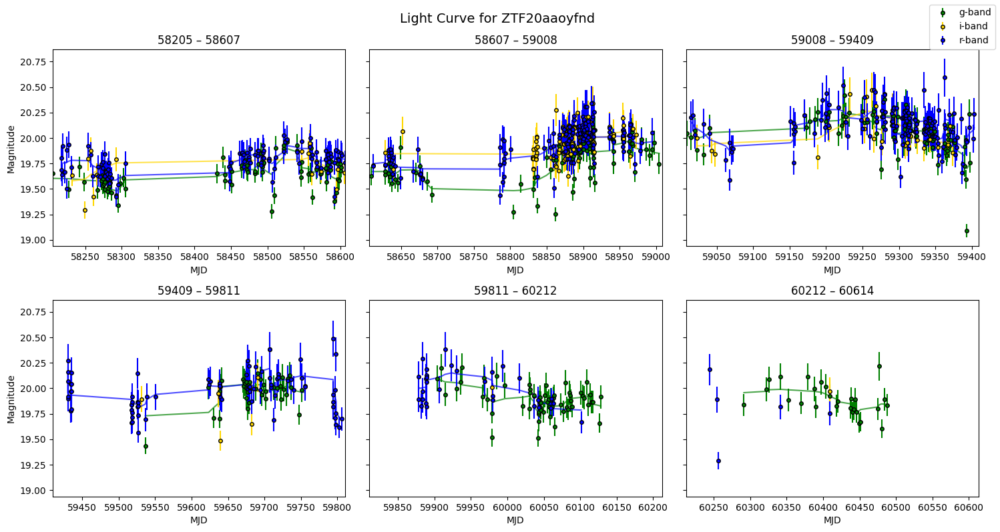

top_class: [np.str_('QSO')]
cat_id: ['NGC4382_sources_22']
tns: ['Unknown']


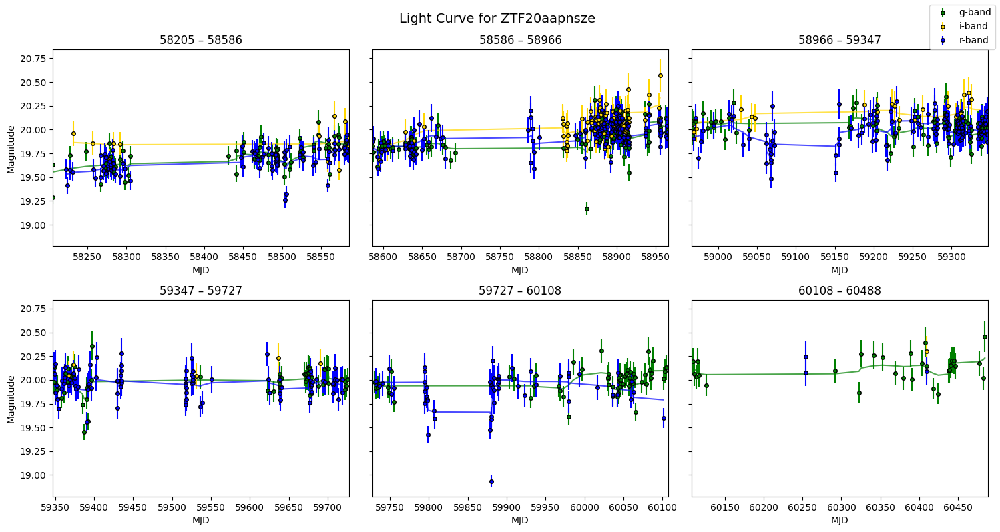

top_class: [np.str_('AGN') np.str_('Microlensing candidate') np.str_('Unknown')]
cat_id: ['Fan2010_882' 'Peacock_711']
tns: ['Unknown']


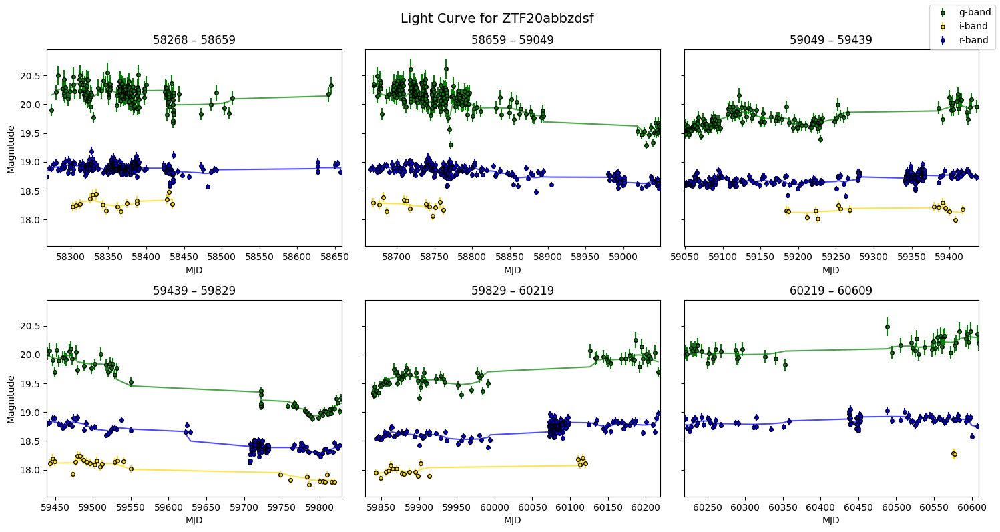

top_class: [np.str_('QSO')]
cat_id: ['NGC5866_sources_728']
tns: ['Unknown']


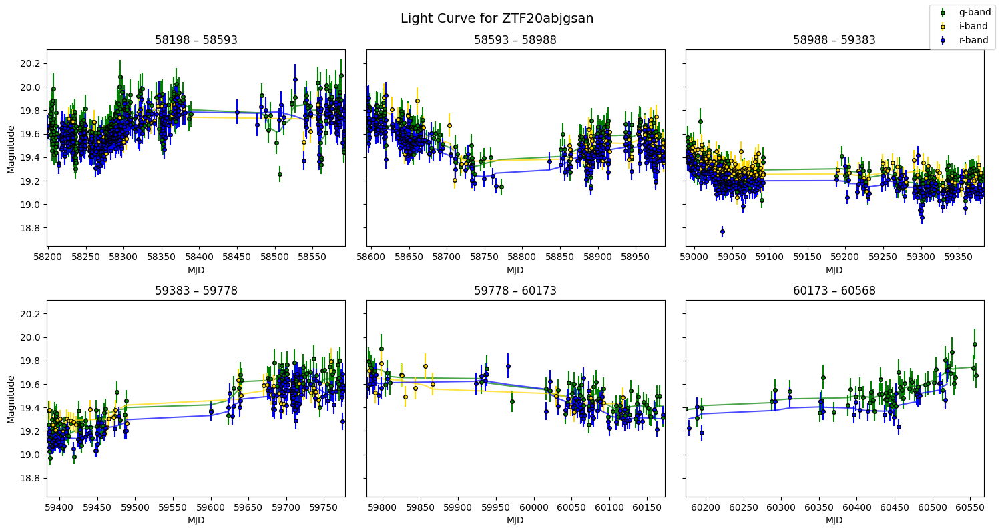

top_class: [np.str_('QSO')]
cat_id: ['NGC5866_sources_688']
tns: ['Unknown']


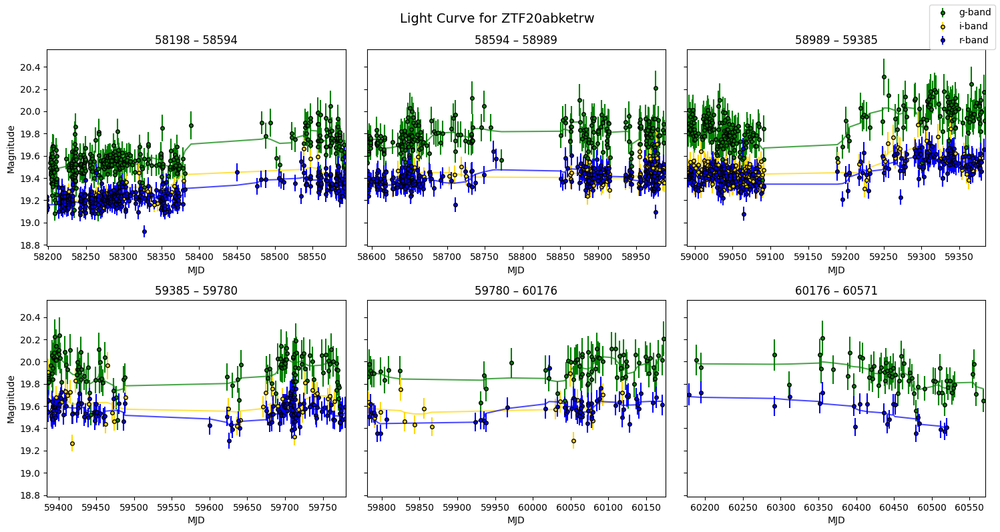

top_class: [np.str_('BClG') np.str_('QSO')]
cat_id: ['NGC5866_sources_1395']
tns: ['Unknown']


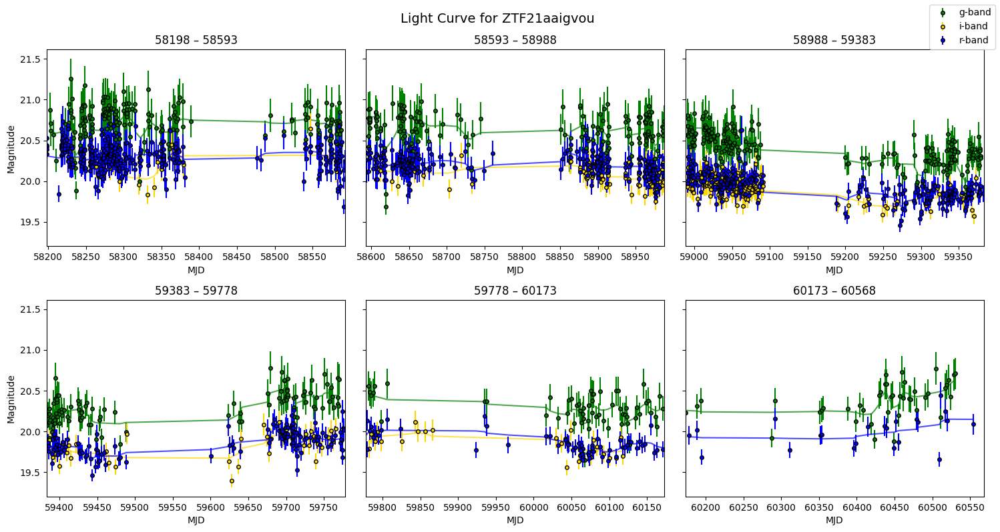

top_class: [np.str_('Star') np.str_('Unknown')]
cat_id: ['Peacock_1372']
tns: ['Unknown']


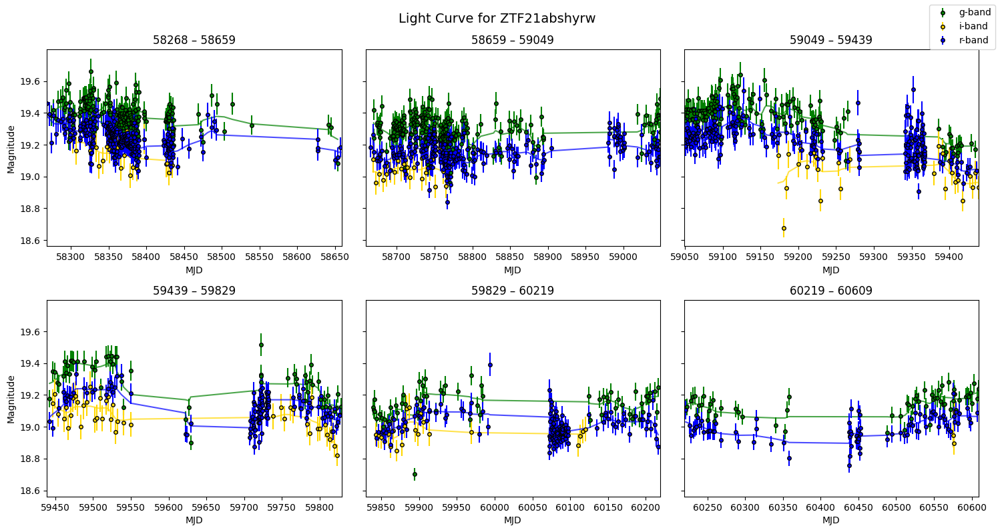

top_class: [np.str_('Unknown')]
cat_id: ['NGC5846_sources_2083']
tns: ['Unknown']


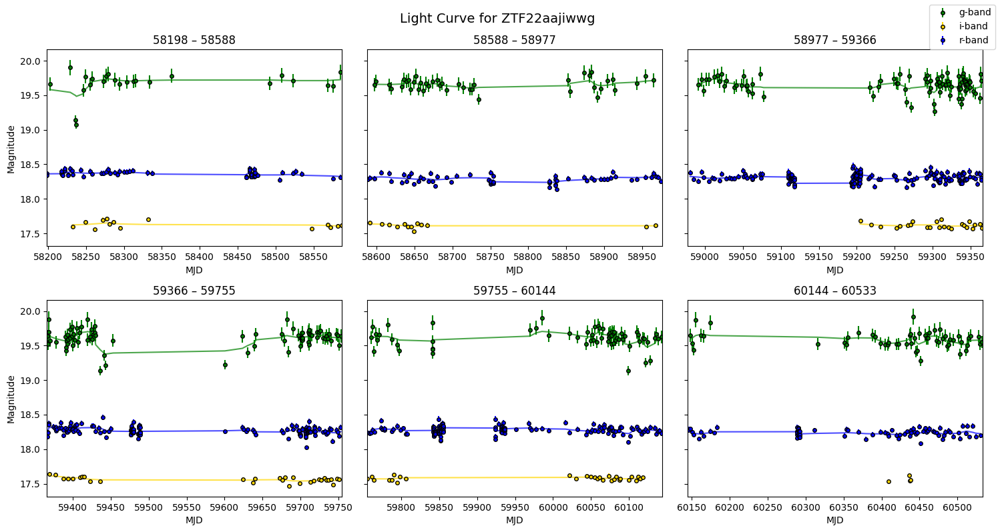

top_class: [np.str_('GroupG') np.str_('Seyfert2') np.str_('Seyfert_2')
 np.str_('Star')]
cat_id: ['Seth08_157']
tns: ['Unknown']


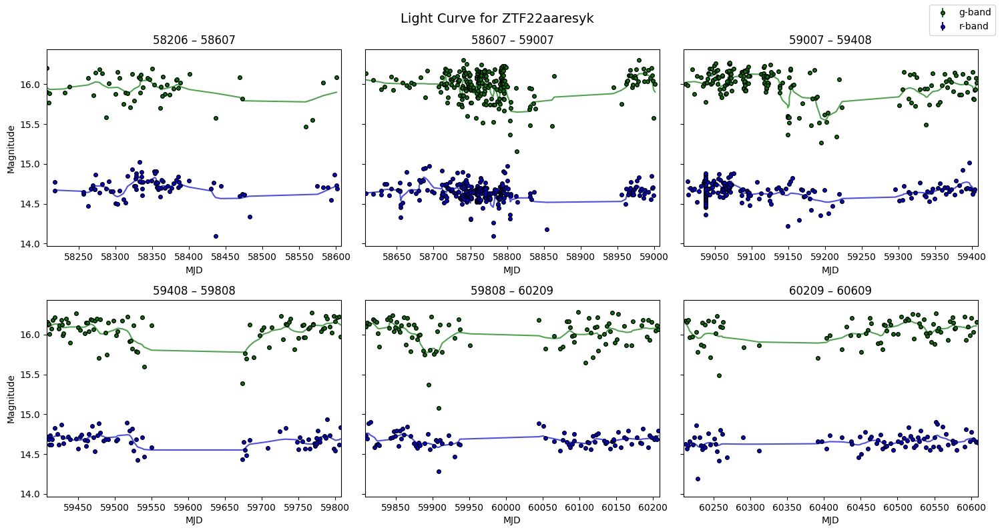

top_class: [np.str_('GinCl') np.str_('QSO')]
cat_id: ['NGC4382_sources_3353']
tns: ['Unknown']


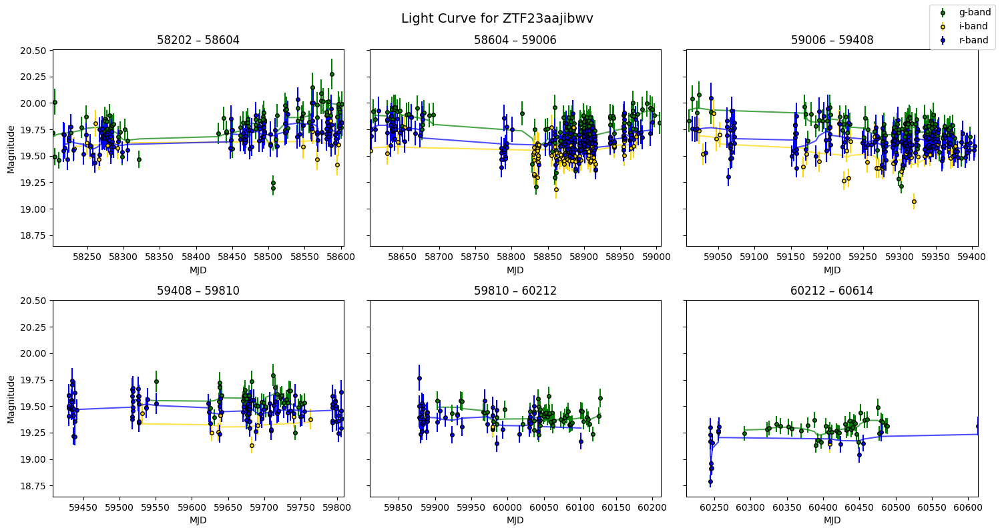

top_class: [np.str_('Cl*')]
cat_id: ['PHAT2_johnson15_1922']
tns: ['Unknown']


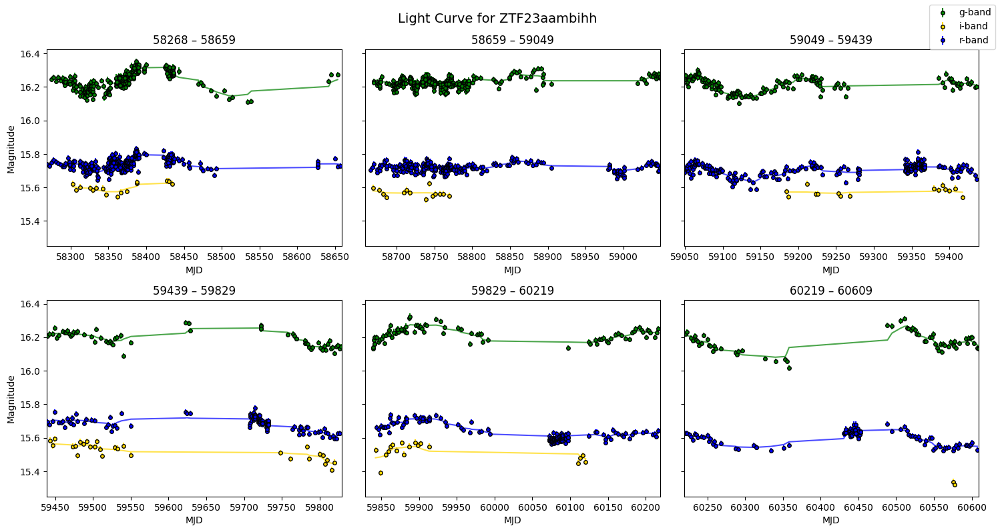

In [62]:
from scipy.ndimage import gaussian_filter1d
import matplotlib.pyplot as plt
import numpy as np

band_colors = {'g': 'green', 'r': 'blue', 'i': 'gold'}

for _, row in data_lc.iterrows():
    ztfid = row['ztf_id']
    
    row_alert = data_obj.loc[data_obj['objectId'] == ztfid]
    
    print("top_class:", np.unique(row_alert['top_class'].explode()))
    print("cat_id:", np.unique(row_alert['cat_id'].explode()))
    print("tns:", np.unique(row_alert['tns'].explode()))
    
    mjd = np.array(row['mjd'])
    mag = np.array(row['mag'])
    magerr = np.array(row['magerr'])
    bands = np.array(row['band'])

    mjd_min, mjd_max = mjd.min(), mjd.max()
    dt = (mjd_max - mjd_min) / 6  # 6 chunks

    fig, axes = plt.subplots(2, 3, figsize=(15, 8), sharey=True)
    axes = axes.flatten()

    for i, ax in enumerate(axes):
        start = mjd_min + i * dt
        end = start + dt

        for b in np.unique(bands):
            mask = (bands == b) & (mjd >= start) & (mjd < end)
            if np.any(mask):
                ax.errorbar(
                    mjd[mask], mag[mask], yerr=magerr[mask],
                    fmt='o', ms=4, 
                    color=band_colors.get(b, 'black'),
                    markeredgecolor='black',
                    label=f"{b}-band" if i == 0 else ""
                )

                # Gaussian smoothing if enough points
                if np.sum(mask) > 5:
                    mjd_sorted = np.argsort(mjd[mask])
                    smoothed = gaussian_filter1d(mag[mask][mjd_sorted], sigma=2)
                    ax.plot(mjd[mask][mjd_sorted], smoothed, '-', 
                            color=band_colors.get(b, 'black'), alpha=0.7)

        ax.set_xlim(start, end)
        ax.invert_yaxis()
        ax.set_xlabel("MJD")
        if i % 3 == 0:
            ax.set_ylabel("Magnitude")
        ax.set_title(f"{start:.0f} – {end:.0f}")

    fig.suptitle(f"Light Curve for {ztfid}", fontsize=14)
    fig.legend(loc="upper right")
    plt.tight_layout()
    plt.show()
